# Neurons in the human entorhinal cortex map abstract emotion space

 This notebook contains code for reproducing the figures in our paper.

In [9]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [10]:
# Set paths:
import os 
dirpath = os.getcwd()

datapath = f'{dirpath}/data'
codepath = f'{dirpath}/code'

In [11]:
# Imports

# Standard library
import json
import glob
import os
import sys
import math
import warnings
from itertools import combinations

# Third-party: plotting
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib import cm
from matplotlib.colors import ListedColormap

# Third-party: scientific computing
import numpy as np
import pandas as pd
import scipy
import scipy.ndimage
from scipy import signal, ndimage
from scipy.stats import zscore, norm, pearsonr, binomtest, wilcoxon, mannwhitneyu
from scipy.ndimage import gaussian_filter1d, gaussian_filter
from scipy.optimize import linear_sum_assignment

# Third-party: machine learning and statistics
from sklearn.metrics import r2_score, roc_curve, auc
from sklearn.linear_model import HuberRegressor
import statsmodels.formula.api as smf
import statsmodels.api as sm

# Third-party: neuroimaging and neuroscience
import mne
from nilearn import plotting, datasets
from nilearn.image import math_img

# Third-party: other
from upsetplot import plot

# Local imports
sys.path.insert(0, codepath)
from spike_utils import smooth_firing_rate_ev
import grid_utils
import dask_utils

sys.path.insert(0, f'{codepath}/mec-cell-classification-master/')
import find_grid_cells
from calculate_2d_tuning_curve import calculate_2d_tuning_curve

In [12]:
# Plotting code: 

colors_dict={'EC':'slateblue',
             'HC': 'lightcoral',
             'AMY': 'darkorange',
             'PHC': 'yellowgreen'}

plt.style.use('seaborn-v0_8-paper')
plt.rc("axes.spines", top=False, right=False)
plt.rc("axes.spines", top=False, right=False)
plt.rc('lines', lw=1, c='r')

box_params = dict(marker='o', markersize=1,
                  linestyle='none')

# Set font sizes
mpl.rcParams['font.size'] = 10
mpl.rcParams['axes.labelsize'] = 10
mpl.rcParams['xtick.labelsize'] = 8
mpl.rcParams['ytick.labelsize'] = 8

# Set line widths
mpl.rcParams['lines.linewidth'] = 1.5
mpl.rcParams['axes.linewidth'] = 0.5

# Set figure size and dpi
mpl.rcParams['figure.figsize'] = (4, 3)  # 4 inches wide by 3 inches tall
mpl.rcParams['figure.dpi'] = 300

# Set the default colormap
mpl.rcParams['image.cmap'] = 'viridis'

# Set the resolution of PNG images
mpl.rcParams['figure.dpi'] = 300
mpl.rcParams['savefig.dpi'] = 300

# Set the file format for saved figures
mpl.rcParams['savefig.format'] = 'pdf'

# # Set the text renderer
mpl.rcParams['text.usetex'] = False
# mpl.rcParams['text.latex.preamble'] = [r"\usepackage{amsmath}"]  # use AMS math symbols

# Set the legend font size
mpl.rcParams['legend.fontsize'] = 8

# Set the grid style
mpl.rcParams['grid.linestyle'] = ':'
mpl.rcParams['grid.linewidth'] = 0.5

# Set the default tick style
mpl.rcParams['xtick.major.width'] = 0.5
mpl.rcParams['ytick.major.width'] = 0.5
mpl.rcParams['xtick.minor.width'] = 0.25
mpl.rcParams['ytick.minor.width'] = 0.25
mpl.rcParams['xtick.major.size'] = 4
mpl.rcParams['ytick.major.size'] = 4
mpl.rcParams['xtick.minor.size'] = 2
mpl.rcParams['ytick.minor.size'] = 2

# Set the default errorbar cap size
mpl.rcParams['errorbar.capsize'] = 2


# Participants encode and recall images in a two-dimensional emotion space.

In [13]:
all_encoding_df = pd.read_csv(f'{datapath}/all_encoding_df_public.csv')
all_retrieval_df = pd.read_csv(f'{datapath}/all_retrieval_df_public.csv')
all_subj_df = pd.read_csv(f'{datapath}/all_subj_df_public.csv')
oasis_df = pd.read_csv(f'{datapath}/oasis_df_public.csv')


In [14]:
all_encoding_df['unique_sess_id'] = all_encoding_df.apply(lambda x: f'{x.subj_id}_{x.sess_id}', axis=1)



In [15]:
all_encoding_df.groupby(['unique_sess_id', 'subj_id']).mean(numeric_only=True).recall.reset_index().sort_values(by='recall')

,unique_sess_id,subj_id,recall
26,6.0_6.0,6.0,0.254310
30,9.0_10.0,9.0,0.289916
9,16.0_19.0,16.0,0.308333
25,5.0_5.0,5.0,0.343478
10,16.0_20.0,16.0,0.346154
22,22.0_31.0,22.0,0.360169
12,16.0_22.0,16.0,0.363248
21,22.0_30.0,22.0,0.379310
11,16.0_21.0,16.0,0.379464
15,18.0_25.0,18.0,0.391667


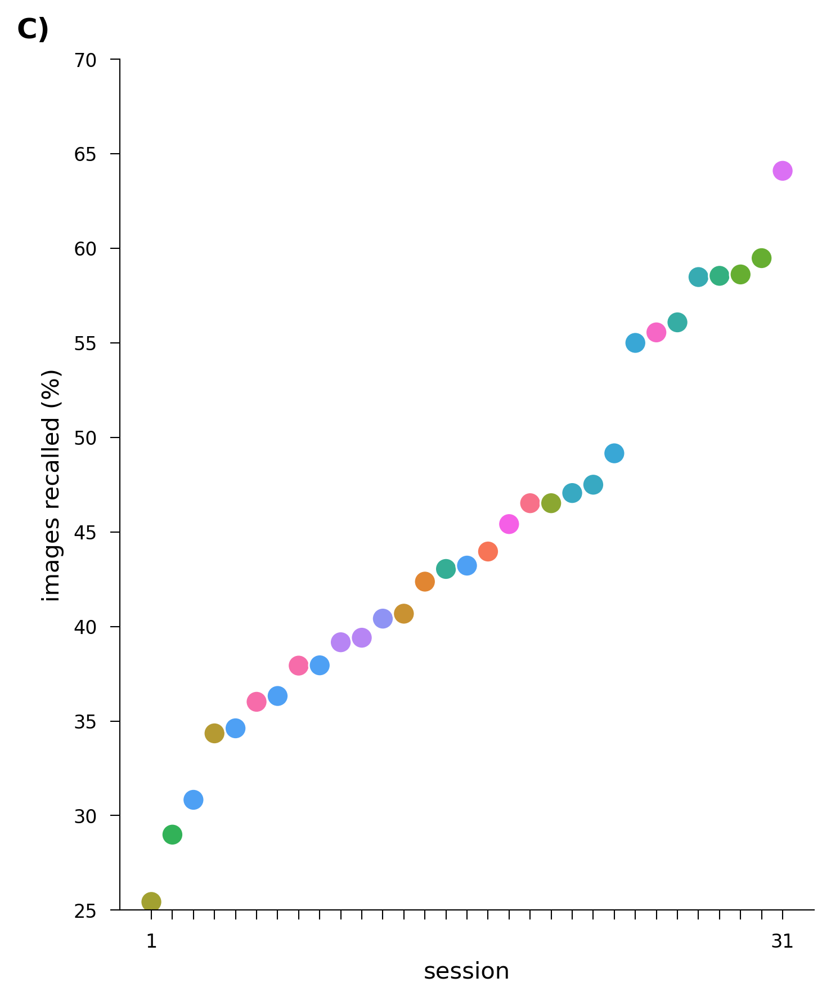

In [17]:
# Figure 1C:

f, ax = plt.subplots(1,1, figsize=[5,6], dpi=300)

# Prepare data and convert recall to percentage
plot_data = all_encoding_df.groupby(['unique_sess_id', 'subj_id']).mean(numeric_only=True).recall.reset_index()
plot_data['recall_pct'] = plot_data['recall'] * 100
plot_data = plot_data.sort_values(by='recall_pct')

# Create scatter plot with percentage values (no legend)
sns.scatterplot(data=plot_data,
                x='unique_sess_id', y='recall_pct', hue='subj_id', 
                palette=sns.color_palette("husl", 22), s=85, legend=False)

# Set axis labels and limits
ax.set_xlabel('session')
ax.set_ylabel('images recalled (%)')
ax.set_ylim([25, 70])

# Set x-axis ticks to show session numbers (1 to number of sessions)
num_sessions = len(plot_data['unique_sess_id'].unique())
ax.set_xticks(range(num_sessions))
# Only show labels for first and last session
xtick_labels = [''] * num_sessions
xtick_labels[0] = '1'
xtick_labels[-1] = str(num_sessions)
ax.set_xticklabels(xtick_labels)

# Remove top and right spines
ax.spines[['top', 'right']].set_visible(False)

# Add "C)" label in top-left corner
ax.text(-0.1, 1.05, 'C)', transform=ax.transAxes, 
        fontsize=12, fontweight='bold', va='top', ha='right')

plt.tight_layout()
plt.show()


In [18]:
all_encoding_df.groupby(['unique_sess_id', 'subj_id']).mean(numeric_only=True).recall.mean()

0.44605321832524136

In [19]:
all_encoding_df.groupby(['unique_sess_id', 'subj_id']).mean(numeric_only=True).recall.std()

0.09873262741354262

/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/1387346752.py:22: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(oasis_df.zValence,
/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/1387346752.py:34: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(oasis_df.zArousal,
/v

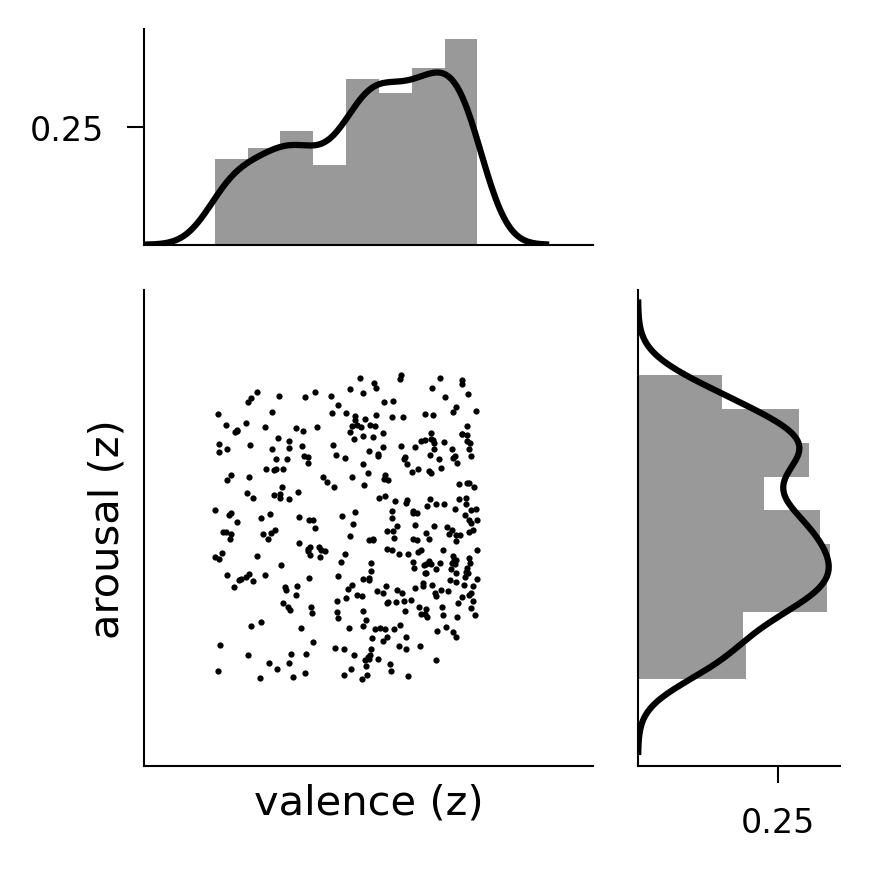

In [43]:
# Figure 1B:

f = plt.figure(constrained_layout=True, figsize=[3,3]) # initialize the figure 
gs = f.add_gridspec(3, 3)
stat_plot_ax = f.add_subplot(gs[1:, :2])
x_dist_ax = f.add_subplot(gs[:1, :2], sharex = stat_plot_ax)
y_dist_ax = f.add_subplot(gs[1:, 2:], sharey = stat_plot_ax)

# stat_plot_ax.plot(oasis_csv.zValence, oasis_csv.zArousal,  '.', color='gray', alpha = 0.5, markersize=3)
stat_plot_ax.plot(oasis_df.zValence, 
                  oasis_df.zArousal, '.', color='black',  markersize=3)
stat_plot_ax.set_ylim([-3, 3])
stat_plot_ax.set_xlim([-3, 3])
stat_plot_ax.set_xticks([-3, 0, 3])
stat_plot_ax.set_yticks([-3, 0, 3])
stat_plot_ax.tick_params(axis='both', which='major', labelsize=10)
stat_plot_ax.set_xlabel('valence (z)')
stat_plot_ax.set_ylabel('arousal (z)')
stat_plot_ax.spines[['top', 'right']].set_visible(False)

# sns.distplot(oasis_csv.zValence, ax=x_dist_ax, norm_hist=True, color = 'gray')
sns.distplot(oasis_df.zValence, 
             ax=x_dist_ax, norm_hist=True, color='black')
x_dist_ax.set_xlabel('')
x_dist_ax.set_ylabel('')
x_dist_ax.set_xticks([])
x_dist_ax.set_yticks([0.25])
x_dist_ax.set_ylim([0, None])
x_dist_ax.spines[['top', 'right']].set_visible(False)
# Hide x-axis tick labels on marginal plot (they're shown on main plot)
plt.setp(x_dist_ax.get_xticklabels(), visible=False)

# sns.distplot(oasis_csv.zArousal, ax=y_dist_ax, norm_hist=True, color = 'gray', vertical=True)
sns.distplot(oasis_df.zArousal, 
             ax=y_dist_ax, norm_hist=True, color='black', vertical=True)
y_dist_ax.set_xlabel('')
y_dist_ax.set_ylabel('')
y_dist_ax.set_yticks([])
y_dist_ax.set_xticks([0.25])
y_dist_ax.set_xlim([0, None])
y_dist_ax.spines[['top', 'right']].set_visible(False)
f.tight_layout()
plt.show()

plt.show()


In [44]:
# Behavioral clustering
# list_df = grid_utils.compute_recall_clustering(all_encoding_df, 
#                                     all_retrieval_df, min_list_size=3)
list_df = pd.read_csv(f'{datapath}/list_clustering_df_public.csv')


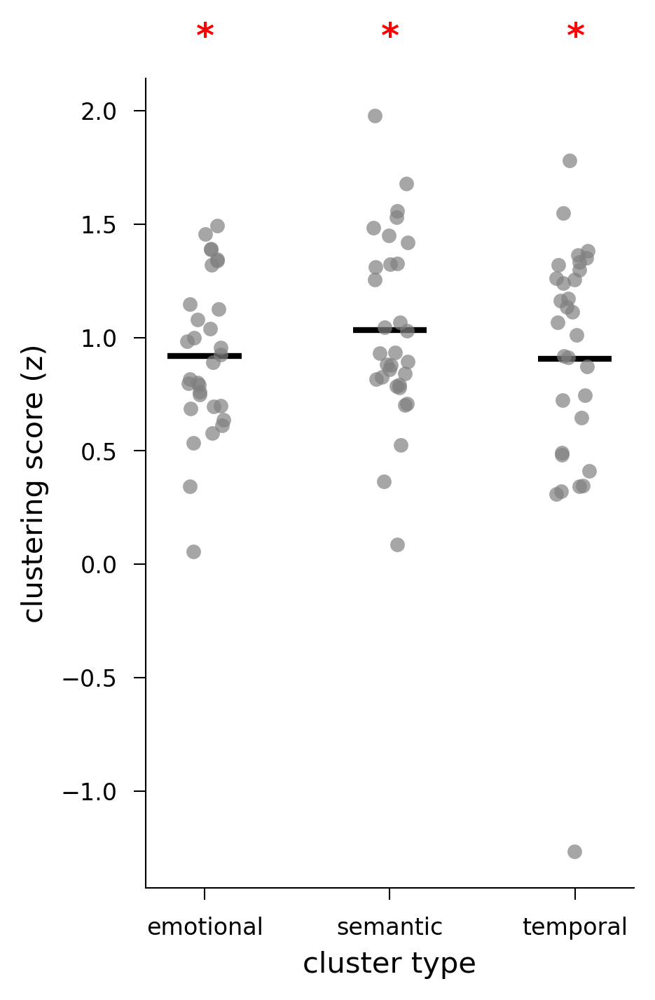

In [57]:
# Figure 1D:

subj_list_df = list_df.groupby(['sess_id', 'clustering_type']).mean(numeric_only=True).reset_index()

# # Define order
order = ['emotional', 'semantic', 'temporal']

# # Compute mean for each clustering type
median_values = subj_list_df[~subj_list_df.clustering_type.isin(['arousal','valence'])].groupby('clustering_type')['clustering_score_zscore'].mean()

# Set up the figure
plt.figure(figsize=(3, 5))

# Strip plot
ax = sns.stripplot(data=subj_list_df[~subj_list_df.clustering_type.isin(['arousal','valence'])], x='clustering_type', y='clustering_score_zscore',
                   jitter=True, alpha=0.7, color='gray')

# Get x-coordinates for each category
for i, clustering_type in enumerate(order):
    median_y = median_values[clustering_type]  # Mean value for this category
    x_min = i - 0.2  # Left bound of line
    x_max = i + 0.2  # Right bound of line
    plt.hlines(y=median_y, xmin=x_min, xmax=x_max, color='black', linestyle='-', linewidth=2)

# Labels and title
ax.set(xlabel ='cluster type', ylabel='clustering score (z)')
# plt.title('Strip Plot with Mean Lines')

# Run Wilcoxon tests for each cluster type
from scipy.stats import wilcoxon
wilcoxon_results = {}
for cluster_type in order:
    w, p = wilcoxon(subj_list_df[subj_list_df.clustering_type==cluster_type].clustering_score_zscore.values)
    wilcoxon_results[cluster_type] = p

# Add red asterisks above each cluster type based on p-values
y_max = ax.get_ylim()[1]
for i, cluster_type in enumerate(order):
    p = wilcoxon_results[cluster_type]
    if p < 0.05:
        asterisk = '*'
    else:
        asterisk = ''
    
    if asterisk:
        ax.text(i, y_max * 1.05, asterisk, ha='center', va='bottom', color='red', fontsize=12, fontweight='bold')

# Show plot
plt.show()
# plt.savefig(f'{save_dir_plots}/clustering_scores.pdf', dpi=300)

In [51]:
w, p = wilcoxon(subj_list_df[subj_list_df.clustering_type=='emotional'].clustering_score_zscore.values)

In [52]:
w, p = wilcoxon(subj_list_df[subj_list_df.clustering_type=='semantic'].clustering_score_zscore.values)

In [53]:
w, p = wilcoxon(subj_list_df[subj_list_df.clustering_type=='temporal'].clustering_score_zscore.values)

In [27]:
# Behavioral regression: 

# image categories
categories = ['animal', 'human_face', 'human_noface', 'natural_object', 'manmade_object', 'environment']
bi_categories = [f'{x}_bi' for x in categories] 

# z-scored image features
zscored_features = ['zArousal', 'zValence', 'zBrightness', 'zContrast', 'zSpatialFrequency', 'zComplexity', 'zCosOrientation', 
    'zSinOrientation']

memory_predictor_df = all_encoding_df[['subj_id', 'sess_id', 'recall'] + zscored_features + bi_categories]

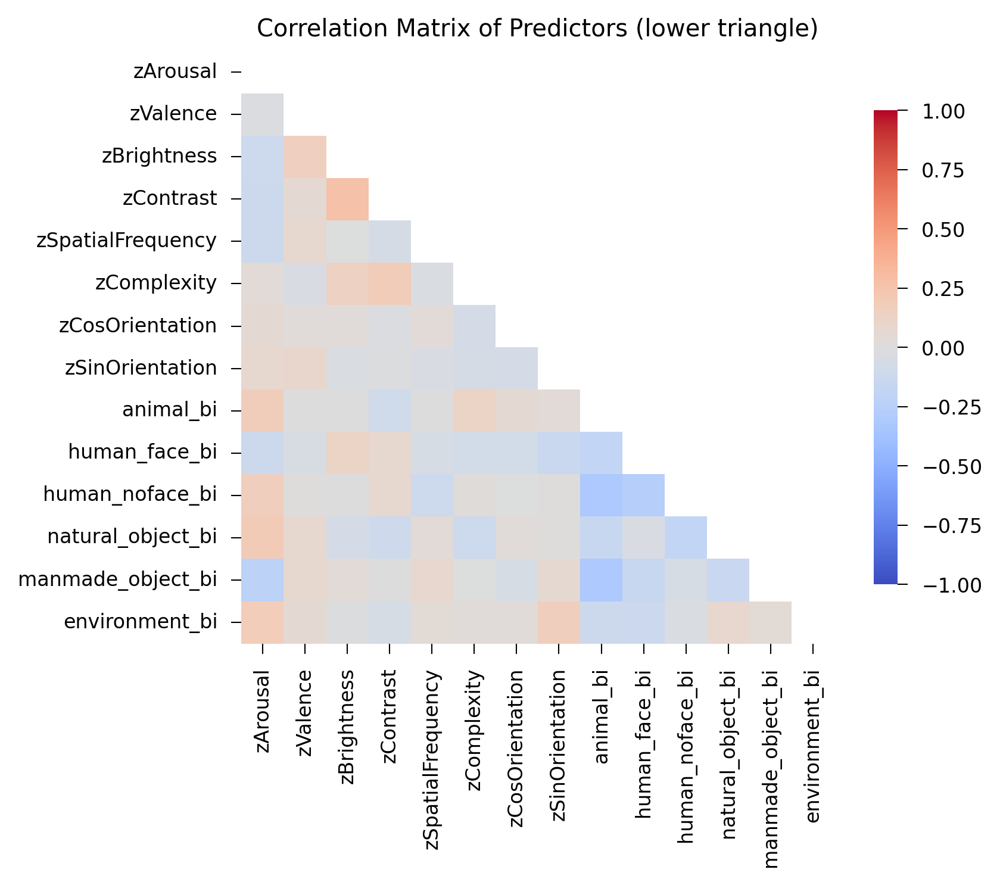

In [ ]:
# # Figure S1A:
# plot the cross-correlation of predictors: 

corr_matrix = memory_predictor_df[zscored_features + bi_categories].drop_duplicates().corr()

# Create a mask for the upper triangle
mask = np.triu(np.ones_like(corr_matrix, dtype=bool))

# Create heatmap with masked upper triangle
plt.figure(figsize=(6, 5))
sns.heatmap(corr_matrix, mask=mask, annot=False, cmap='coolwarm', 
            vmin=-1, vmax=1, square=True, cbar_kws={"shrink": .8})
plt.title('Correlation Matrix of Predictors (lower triangle)')
plt.tight_layout()
plt.show()

Regression 1: recall ~ 1 + X 

In R, run the following mixed-effects logistic regression treating subject as the grouping variable for a random-intercept model:
```model_bi <- glmer(
  recall ~ zArousal + zValence + zBrightness + zContrast + 
           zSpatialFrequency + zComplexity + zCosOrientation + zSinOrientation +
           animal_bi + human_face_bi + human_noface_bi + 
           natural_object_bi + manmade_object_bi +
           factor(environment_bi) + I(zOrder^2) +
           (1 | subj_id),
  data = memory_predictor_df,
  family = binomial(link = "logit")
)
```

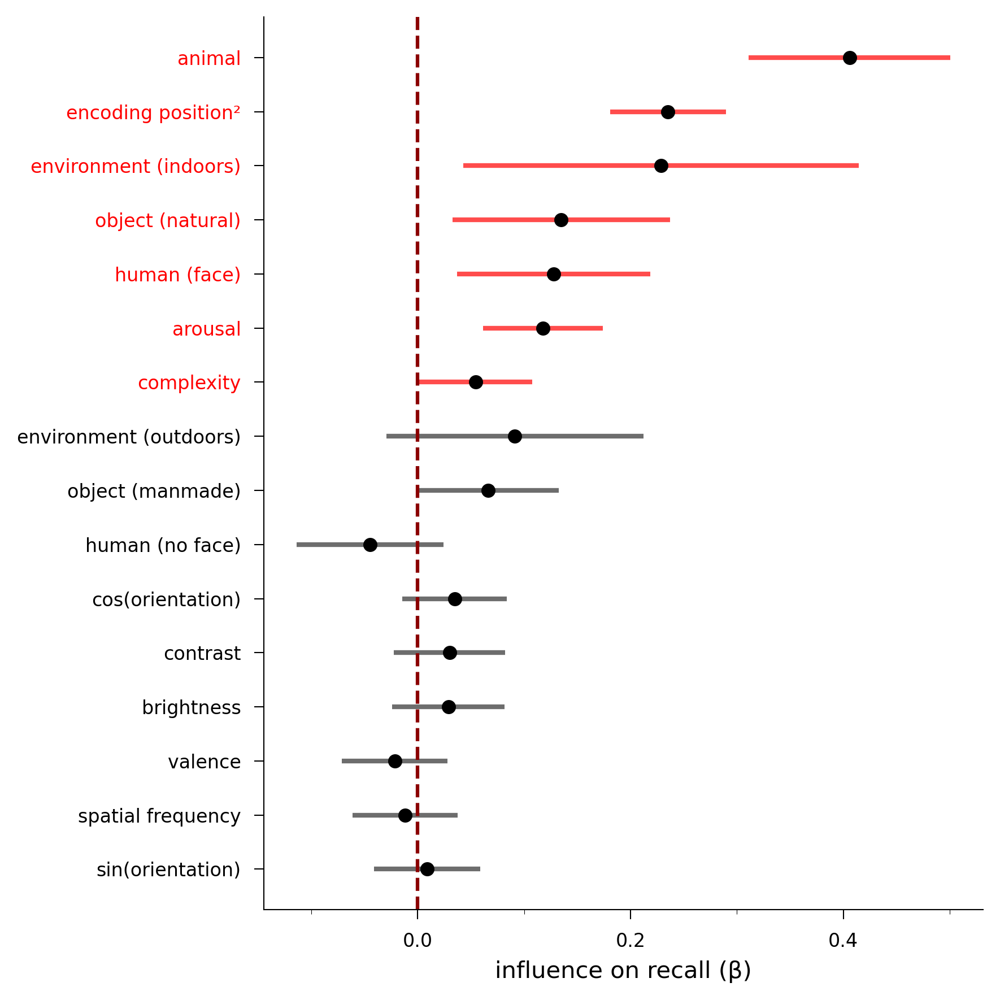

In [66]:
#  Figure 1F:

#  plot the results of the logistic regression: 

# Updated data
data = {
    'coef': ['Intercept', 'zArousal', 'zValence', 'zBrightness', 'zContrast', 'zSpatialFrequency',
             'zComplexity', 'zCosOrientation', 'zSinOrientation', 'animal_bi', 'human_face_bi',
             'human_noface_bi', 'natural_object_bi', 'manmade_object_bi', 'factor(environment_bi)-1',
             'factor(environment_bi)1', 'I(zOrder^2)'],
    'estimate': [-0.021052, 0.117523, -0.021573, 0.028814, 0.029897, -0.011834,
                 0.054421, 0.034656, 0.008957, 0.405888, 0.127731,
                 -0.044941, 0.134839, 0.065981, 0.228636, 0.091299, 0.235236],
    'std': [0.132939, 0.028747, 0.025342, 0.027033, 0.026730, 0.025117,
            0.027042, 0.025132, 0.025514, 0.048300, 0.046385,
            0.035220, 0.052159, 0.034062, 0.094853, 0.061658, 0.027717],
    'pval': [0.87418, 4.35e-05, 0.39462, 0.28648, 0.26336, 0.63753,
             0.04417, 0.16790, 0.72553, 0, 0.00589, 0.20195, 0.00973, 0.05274, 0.01593, 0.13868, 0]
}

df = pd.DataFrame(data)

# Remove the intercept
df = df[df['coef'] != 'Intercept']

# Compute 95% CI
df['ci_lower'] = df['estimate'] - 1.96 * df['std']
df['ci_upper'] = df['estimate'] + 1.96 * df['std']

# Map coefficient names to display names
coef_mapping = {
    'animal_bi': 'animal',
    'I(zOrder^2)': 'encoding position²',
    'factor(environment_bi)-1': 'environment (indoors)',  # This one is significant
    'natural_object_bi': 'object (natural)',
    'human_face_bi': 'human (face)',
    'zArousal': 'arousal',
    'factor(environment_bi)1': 'environment (outdoors)',  # This one is not significant
    'manmade_object_bi': 'object (manmade)',
    'zComplexity': 'complexity',
    'human_noface_bi': 'human (no face)',
    'zCosOrientation': 'cos(orientation)',
    'zContrast': 'contrast',
    'zBrightness': 'brightness',
    'zValence': 'valence',
    'zSpatialFrequency': 'spatial frequency',
    'zSinOrientation': 'sin(orientation)'
}

# Apply mapping
df['coef_display'] = df['coef'].map(coef_mapping)

# Compute 95% CI and determine significance (CI does not include zero)
df['is_significant'] = (df['ci_lower'] > 0) | (df['ci_upper'] < 0)

# Define the specific order (from top to bottom) - this is the order within each significance group
display_order = ['animal', 'encoding position²', 'environment (indoors)', 'object (natural)', 
                 'human (face)', 'arousal', 'environment (outdoors)', 'object (manmade)',
                 'complexity', 'human (no face)', 'cos(orientation)', 'contrast',
                 'brightness', 'valence', 'spatial frequency', 'sin(orientation)']

# Create ordered dataframe: significant first, then non-significant, maintaining order within each group
df_ordered = pd.DataFrame()
# Add significant items first (in display order)
for display_name in display_order:
    matching = df[(df['coef_display'] == display_name) & (df['is_significant'] == True)]
    if not matching.empty:
        df_ordered = pd.concat([df_ordered, matching])
# Add non-significant items (in display order)
for display_name in display_order:
    matching = df[(df['coef_display'] == display_name) & (df['is_significant'] == False)]
    if not matching.empty:
        df_ordered = pd.concat([df_ordered, matching])

# Set colors: reddish-brown for significant CIs, dark grey for non-significant
df_ordered['ci_color'] = df_ordered['is_significant'].map({
    True: 'red',  # reddish-brown
    False: '#2F2F2F'  # dark grey/black
})

# Set label colors: red for significant, black for non-significant
df_ordered['label_color'] = df_ordered['is_significant'].map({
    True: 'red',
    False: 'black'
})

# Plot
fig, ax = plt.subplots(figsize=(6, 6))

# Plot confidence intervals
y_positions = range(len(df_ordered))
for i, (idx, row) in enumerate(df_ordered.iterrows()):
    ax.hlines(y=i, xmin=row['ci_lower'], xmax=row['ci_upper'], 
              color=row['ci_color'], linewidth=2, alpha=0.7)

# Plot point estimates
ax.plot(df_ordered['estimate'], y_positions, "o", color='black', markersize=6)

# Vertical reference line at zero (dark red/brown, dashed)
ax.axvline(x=0, color='#8B0000', linestyle='--', linewidth=1.5)

# Set labels
ax.set_xlabel("influence on recall (β)")
ax.set_ylabel("")  # No y-axis label

# Set x-axis ticks
ax.set_xticks([0, 0.2, 0.4])
ax.set_xticks([-0.1, 0, 0.1, 0.2, 0.3, 0.4, 0.5], minor=True)

# Set y-axis tick labels with appropriate colors
y_positions = range(len(df_ordered))
ax.set_yticks(y_positions)
ax.set_yticklabels(df_ordered['coef_display'])
for i, color in enumerate(df_ordered['label_color']):
    ax.get_yticklabels()[i].set_color(color)

# Remove title
ax.set_title("")
ax.invert_yaxis()

plt.tight_layout()
plt.show()

In [33]:
merged_retrieval_df = all_retrieval_df.dropna(subset=['image_name']).merge(all_encoding_df, on=['subj_id', 'sess_id', 'image_name'],  suffixes=('_recall', '_encoding'))

merged_retrieval_df['log_rt'] = np.log(merged_retrieval_df.time_between_recalls)

merged_retrieval_df.dropna(subset=['log_rt'], inplace=True)
                           
merged_retrieval_df = merged_retrieval_df[['subj_id', 'sess_id', 'log_rt'] + zscored_features + bi_categories]                           

Regression 2: log(RT) ~ 1 + X 

In R, run the following mixed-effects linear regression treating subject as the grouping variable for a random-intercept model:
```model_bi <- lmer(
  log_rt ~ zArousal + zValence + zBrightness + zContrast + 
           zSpatialFrequency + zComplexity + zCosOrientation + zSinOrientation +
           animal_bi + human_face_bi + human_noface_bi + 
           natural_object_bi + manmade_object_bi +
           factor(environment_bi) + I(zOrder^2) +
           (1 | subj_id),
  data = memory_predictor_df)
)
```

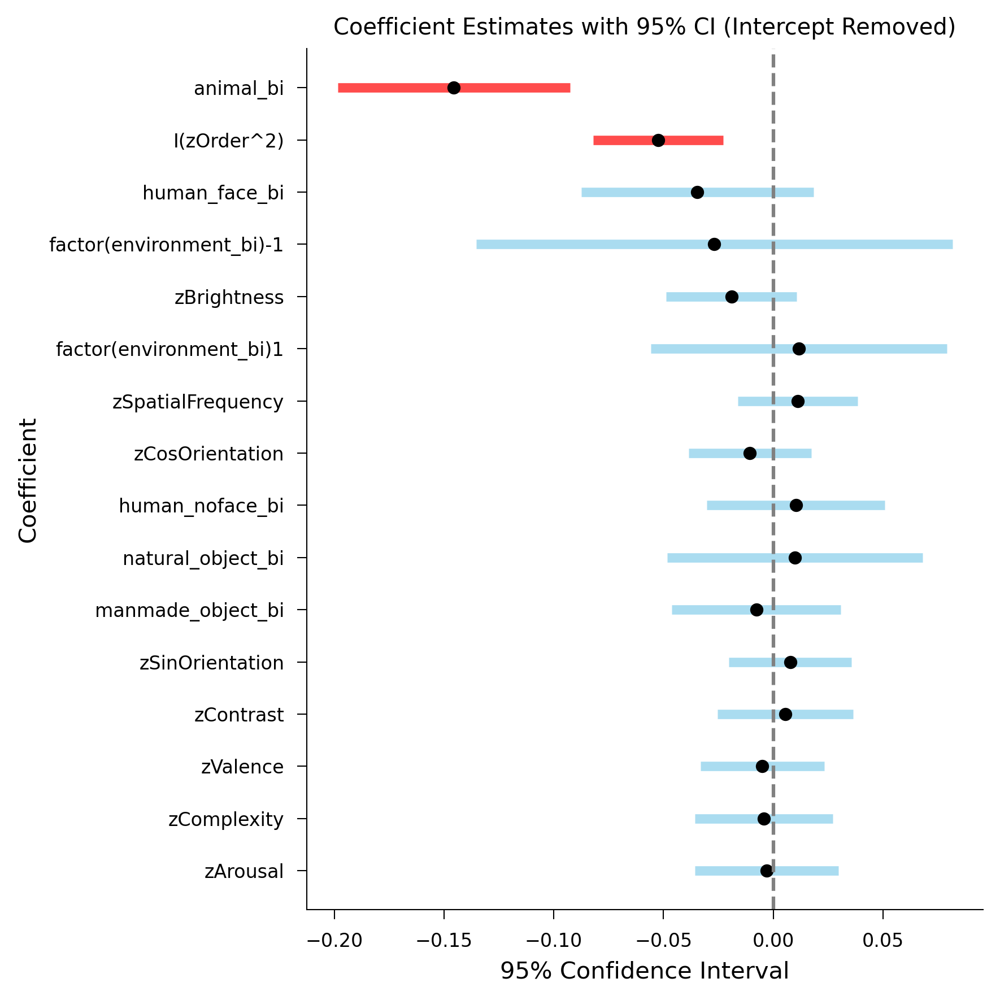

In [ ]:
# Figure S1B:
# Plot the results of the linear regression: 

# Data including p-values
data = {
    'coef': ['Intercept', 'zArousal', 'zValence', 'zBrightness', 'zContrast', 'zSpatialFrequency',
             'zComplexity', 'zCosOrientation', 'zSinOrientation', 'animal_bi', 'human_face_bi',
             'human_noface_bi', 'natural_object_bi', 'manmade_object_bi', 'factor(environment_bi)-1',
             'factor(environment_bi)1', 'I(zOrder^2)'],
    'estimate': [1.203e+00, -2.960e-03, -5.016e-03, -1.901e-02, 5.476e-03, 1.123e-02,
                 -4.319e-03, -1.059e-02, 7.702e-03, -1.455e-01, -3.453e-02,
                 1.026e-02, 9.787e-03, -7.717e-03, -2.687e-02, 1.162e-02, -5.240e-02],
    'SE': [9.481e-02, 1.663e-02, 1.437e-02, 1.515e-02, 1.579e-02, 1.393e-02,
           1.601e-02, 1.422e-02, 1.422e-02, 2.700e-02, 2.693e-02,
           2.074e-02, 2.966e-02, 1.961e-02, 5.533e-02, 3.444e-02, 1.515e-02],
    'pval': [0, 0.858777, 0.727140, 0.209524, 0.728700, 0.420151,
             0.787389, 0.456314, 0.587970, 7.63e-08, 0.199825, 0.620857, 0.741421, 0.693897, 0.627322, 0.735922, 0.000548]
}

df = pd.DataFrame(data)

# Remove intercept
df = df[df['coef'] != 'Intercept']

# Compute 95% CI
df['ci_lower'] = df['estimate'] - 1.96 * df['SE']
df['ci_upper'] = df['estimate'] + 1.96 * df['SE']

# Determine colors based on significance (p < 0.05)
df['color'] = np.where(df['pval'] < 0.05, 'red', 'skyblue')

# Sort by absolute effect size for better readability
df['abs_estimate'] = df['estimate'].abs()
df = df.sort_values('abs_estimate', ascending=True)

# Plot
plt.figure(figsize=(6,6))
plt.hlines(y=df['coef'], xmin=df['ci_lower'], xmax=df['ci_upper'], color=df['color'], alpha=0.7, linewidth=4)
plt.plot(df['estimate'], df['coef'], "o", color='black')
plt.axvline(x=0, color='grey', linestyle='--')
plt.xlabel("95% Confidence Interval")
plt.ylabel("Coefficient")
plt.title("Coefficient Estimates with 95% CI (Intercept Removed)")
plt.tight_layout()
plt.show()

# Neuronal spiking is modulated by arousal, valence, and image content.

In [36]:
# Load all cells and locations

all_cell_num = np.load(f'{datapath}/all_cell_num_3_6_25.npy', allow_pickle=True)
all_cell_mni = np.load(f'{datapath}/all_cell_mni_3_6_25.npy', allow_pickle=True)
all_channel_loc = np.load(f'{datapath}/all_channel_loc_3_6_25.npy', allow_pickle=True)


In [ ]:
# Figure 2A: 
# plot electrodes in brain: 
hipp_marker_coords = [x for x,y in zip(all_cell_mni, all_channel_loc) if y == 'HC']
amy_marker_coords = [x for x,y in zip(all_cell_mni, all_channel_loc) if y == 'AMY']
phc_marker_coords = [x for x,y in zip(all_cell_mni, all_channel_loc) if y == 'PHC']
ec_marker_coords = [x for x,y in zip(all_cell_mni, all_channel_loc) if y == 'EC']

hipp_marker_coords = np.vstack(hipp_marker_coords)
amy_marker_coords = np.vstack(amy_marker_coords)
phc_marker_coords = np.vstack(phc_marker_coords)
ec_marker_coords = np.vstack(ec_marker_coords)

ec_col = np.tile([108,75,140], (len(ec_marker_coords), 1))/255
amy_col = np.tile([221,125,35], (len(amy_marker_coords), 1))/255
hipp_col = np.tile([218,161,164], (len(hipp_marker_coords), 1))/255
phc_col = np.tile([183,211,151], (len(phc_marker_coords), 1))/255

# view_off = plotting.view_markers(np.vstack([ec_marker_coords, amy_marker_coords, hipp_marker_coords, phc_marker_coords]), 
#                                  marker_size=20, marker_color='black')

plotting.view_markers(np.vstack([ec_marker_coords, amy_marker_coords, hipp_marker_coords, phc_marker_coords]), 
                                 marker_size=7, marker_color=np.vstack([ec_col, amy_col, hipp_col, phc_col]))

# view_off.save_as_html(f'{save_dir_plots}/brain_plot.html')



/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/nilearn/__init__.py:67: FutureWarning: Python 3.7 support is deprecated and will be removed in release 0.12 of Nilearn. Consider switching to Python 3.9 or 3.10.
  _python_deprecation_warnings()


Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster0_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster2_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metada

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster0_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGr

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster12_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster13_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster14_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster12_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster13_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster23_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster24_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster25_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster23_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster24_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster26_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster27_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Luka

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster26_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster27_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster40_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster41_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster42_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster40_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster41_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster50_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster52_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster53_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster50_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster52_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster63_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster64_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster65_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster63_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster64_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster76_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster77_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster78_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster76_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster77_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster87_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster88_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster89_epochFR.fif ...
Isotrak not found
    Found th

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster87_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster88_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emotion

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster100_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster101_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster100_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster101_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster111_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster112_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster113_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster111_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster112_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster123_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster124_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster125_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster123_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster124_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster136_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster137_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster136_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster137_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster152_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster153_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster152_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster153_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster164_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster165_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster166_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster165_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster166_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster177_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster178_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster179_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster177_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster178_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster189_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster190_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster191_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster189_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster190_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster201_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster202_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster203_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster201_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster202_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster213_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster214_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster215_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster213_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster214_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster225_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster226_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster227_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster225_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster226_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster237_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster241_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster242_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster237_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster241_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster254_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster255_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster256_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster254_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster255_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster266_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster267_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster268_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster266_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster267_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster279_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster280_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster283_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster279_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster280_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster293_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster294_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster295_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster293_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster294_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster305_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster306_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster307_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster305_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster306_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster317_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster318_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster319_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster317_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster318_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster329_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster330_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster331_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster329_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster330_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster345_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster346_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster347_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster345_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster346_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster357_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster358_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster359_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster357_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster358_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster376_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster377_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster378_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster376_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster377_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster388_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster390_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster394_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster388_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster390_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster404_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster405_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster406_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster404_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster405_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster416_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster417_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster418_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster417_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster418_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster435_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster436_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster437_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster436_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster437_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster449_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster450_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster449_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster450_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster458_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster459_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lu

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster458_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster459_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster470_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster471_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster472_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster470_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster471_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster482_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster483_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster484_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster482_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster483_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster493_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster494_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lu

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster493_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster494_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster505_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster506_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster507_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster505_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster506_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster517_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster518_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster519_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster517_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster518_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster529_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster530_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster531_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster529_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster530_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster541_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster542_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster543_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster541_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster542_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster553_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster554_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster555_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster553_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster554_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster563_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster564_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster563_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster564_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster584_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster585_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster586_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster584_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster585_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster596_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster597_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster598_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster596_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster597_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster609_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster610_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster609_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster610_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster621_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster622_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster623_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster621_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster622_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster632_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster635_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster632_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster635_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster645_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster646_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster647_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster645_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster646_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster657_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster658_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster6

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster657_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster658_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster669_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster670_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster671_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster669_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster670_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster680_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster681_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster682_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster680_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster681_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster691_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster692_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster691_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster692_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster703_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster704_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster705_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster703_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster704_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster714_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster715_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster716_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster715_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster716_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster728_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster729_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster730_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster728_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster729_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster742_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster743_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster742_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster743_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster754_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster755_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster756_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding 

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster755_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster756_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster767_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster768_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster769_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster767_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster768_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster780_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster781_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster780_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster781_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster792_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster793_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster794_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster792_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster793_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster803_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster804_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster805_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster803_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster804_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster820_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster821_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster822_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster820_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster821_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster836_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster837_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster838_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster836_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster837_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster848_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster849_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster850_epochFR.fif ...
Isotrak not found
    Found

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster848_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster849_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster860_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster861_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster862_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster860_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster861_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster873_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster874_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster873_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster874_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster885_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster886_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster887_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster885_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster886_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster898_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster899_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster898_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster899_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster917_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster918_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster917_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster918_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster934_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster935_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster934_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster935_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster950_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster951_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Readin

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster950_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster951_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster964_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster965_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster966_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster964_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster965_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster971_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster972_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lu

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster971_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster972_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster983_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster984_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster995_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensati

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster983_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster984_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emoti

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1006_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1007_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Read

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1006_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1007_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1018_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1019_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1020_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1018_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1019_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1030_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1031_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1032_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1030_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1031_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1043_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1044_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Read

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1043_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1044_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1055_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1056_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1057_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Addi

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1056_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1057_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1068_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1069_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1070_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Addi

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1069_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1070_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1081_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1082_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1083_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1081_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1082_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1093_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1094_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1095_epochFR.fif ...
Isotrak not found
    Fo

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1093_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1094_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1105_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1106_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1107_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1105_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1106_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1117_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1118_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1119_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1117_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1118_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1129_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1130_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1131_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1129_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1130_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1141_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1142_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1143_epochFR.fif ...
Isotrak not found
    Fo

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1141_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1142_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1153_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1154_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1155_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1153_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1154_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1165_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1166_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1167_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1165_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1166_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1176_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1177_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compensation matrices available
Adding metadata with 4 columns
240 matching events found
No baseline correction applied
0 projection items activated
Reading /home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1178_epochFR.fif ...
Isotrak not found
    Found the data of interest:
        t =   -1000.00 ...    2990.00 ms
        0 CTF compens

<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1176_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster1177_epochFR.fif) does not conform to MNE naming conventions. All epochs files should end with -epo.fif, -epo.fif.gz, _epo.fif or _epo.fif.gz
  zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
<ipython-input-70-5f141cf64042>:10: RuntimeWarning: This filename (/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/Emo

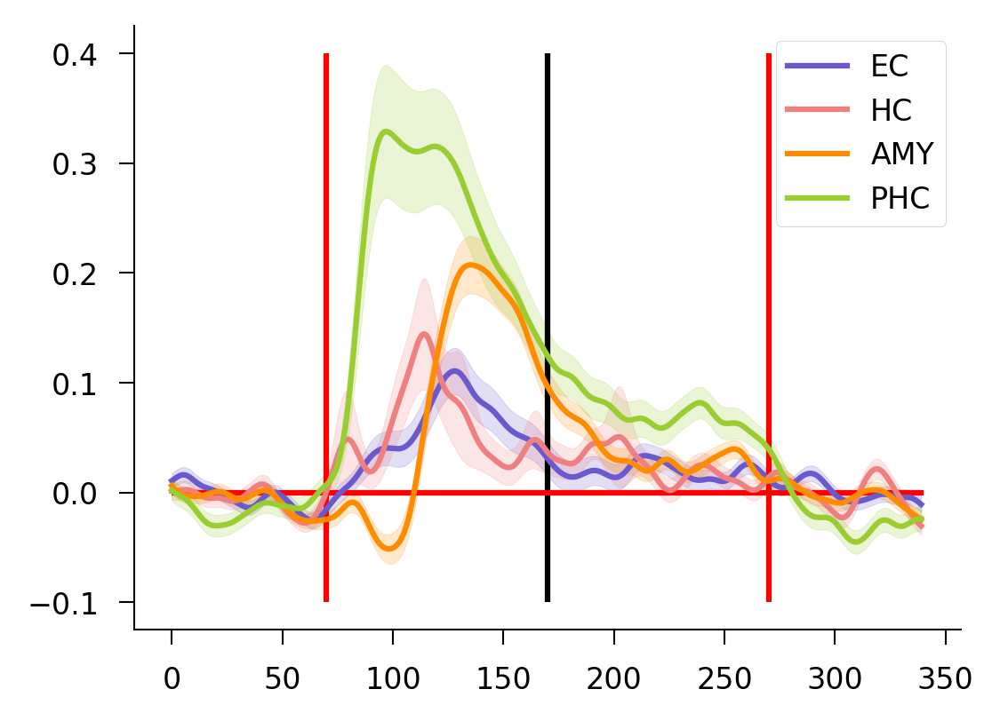

In [ ]:
# Figure 2B: Note this requires computing the smoothed firing rates for each cluster 
# (the saved smoothed firing rates are not saved here but can be computed using the smooth_firing_rate_ev function in the spike_utils.py file)

# smoothed_frs = {'EC': [],
#                 'AMY': [], 
#                 'HC': [], 
#                 'PHC': []}

# for cluster, region in zip(all_cell_num, all_channel_loc):
#     if region == 'TP':
#         continue
#     x = cluster - 1
#     zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR.fif')
#     smoothed_frs[region].append(zscored_fr_ev)
    
# PHC_data = np.vstack([np.nanmean(x._data, axis=0) for x in smoothed_frs['PHC']])
# PHC_mean = np.nanmean(PHC_data, axis=0)
# PHC_std = np.nanstd(PHC_data, axis=0) / np.sqrt(PHC_data.shape[0])

# AMY_data = np.vstack([np.nanmean(x._data, axis=0) for x in smoothed_frs['AMY']])
# AMY_mean = np.nanmean(AMY_data, axis=0)
# AMY_std = np.nanstd(AMY_data, axis=0) / np.sqrt(AMY_data.shape[0])

# HC_data = np.vstack([np.nanmean(x._data, axis=0) for x in smoothed_frs['HC']])
# HC_mean = np.nanmean(HC_data, axis=0)
# HC_std = np.nanstd(HC_data, axis=0) / np.sqrt(HC_data.shape[0])

# EC_data = np.vstack([np.nanmean(x._data, axis=0) for x in smoothed_frs['EC']])
# EC_mean = np.nanmean(EC_data, axis=0)
# EC_std = np.nanstd(EC_data, axis=0) / np.sqrt(EC_data.shape[0])

    
# plt.figure(figsize=(4, 3))
# t = np.arange(EC_mean[30:-30].shape[0])
# plt.plot(EC_mean[30:-30], label='EC', color=colors_dict['EC'])
# plt.fill_between(t, EC_mean[30:-30] - EC_std[30:-30], EC_mean[30:-30] + EC_std[30:-30],
#                     alpha=0.2, color=colors_dict['EC'])

# plt.plot(HC_mean[30:-30], label='HC', color=colors_dict['HC'])
# plt.fill_between(t, HC_mean[30:-30] - HC_std[30:-30], HC_mean[30:-30] + HC_std[30:-30],
#                     alpha=0.2, color=colors_dict['HC'])

# plt.plot(AMY_mean[30:-30], label='AMY', color=colors_dict['AMY'])
# plt.fill_between(t, AMY_mean[30:-30] - AMY_std[30:-30], AMY_mean[30:-30] + AMY_std[30:-30],
#                     alpha=0.2, color=colors_dict['AMY'])

# plt.plot(PHC_mean[30:-30], label='PHC', color=colors_dict['PHC'])
# plt.fill_between(t, PHC_mean[30:-30] - PHC_std[30:-30], PHC_mean[30:-30] + PHC_std[30:-30],
#                     alpha=0.2, color=colors_dict['PHC'])

# plt.vlines(70, -0.1, 0.4, 'r')
# plt.vlines(170, -0.1, 0.4, 'k')
# plt.vlines(270, -0.1, 0.4, 'r')
# plt.hlines(0, 0, 340, 'r')
# plt.legend()
# sns.despine()


In [67]:
# Load sync data 
sync_data = pd.read_csv(f'{datapath}/sync_df_public.csv')


In [68]:
# Load spikes and corresponding session mapping
all_spikes = np.load(f'{datapath}/all_spikes_3_6_25.npy', allow_pickle=True)
all_sess_id = np.load(f'{datapath}/all_sess_id_3_6_25.npy', allow_pickle=True)




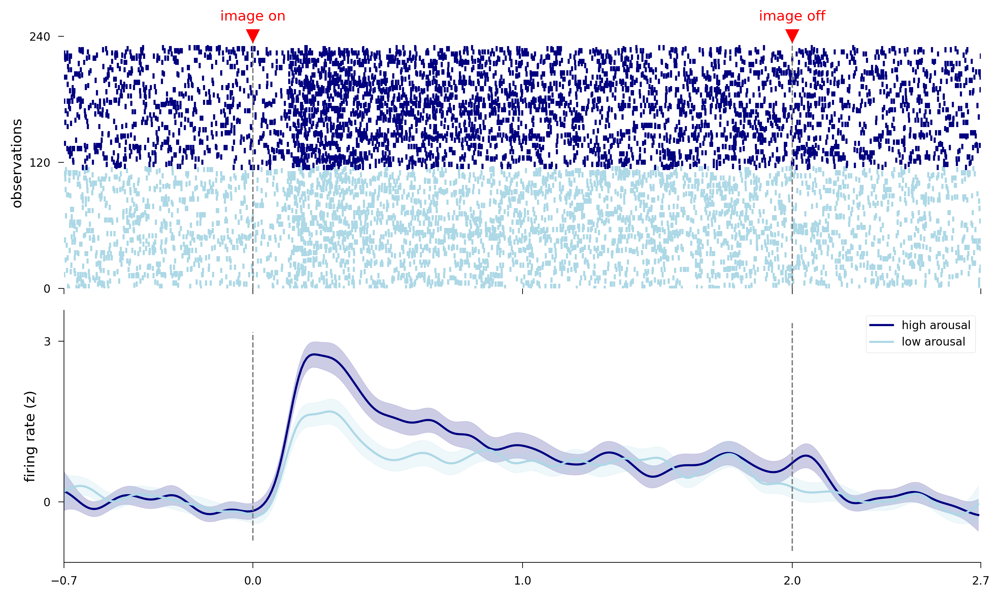

In [73]:
# Figure 2D:
# Arousal example

cluster = 881

spike_times = all_spikes[cluster-1] / 1000
sess_id = all_sess_id[cluster-1]

encoding_time_in_neural_time = [(x*sync_data.slope[sync_data.sess_id==sess_id] + sync_data.offset[sync_data.sess_id==sess_id]).values for x in all_encoding_df.time[all_encoding_df.sess_id==sess_id]]

t_range = [-0.7, 2.7]
bin_size=0.01
sigma=0.05
baseline='base'

spike_times_per_event = [] 
for event in encoding_time_in_neural_time: 
    st_to_keep_event = np.where(np.logical_and(spike_times>=event+t_range[0], 
                                               spike_times<=event+t_range[1]))[0].astype(int)
    spike_times_per_event.append(spike_times[st_to_keep_event] - event)

# Compute number of time bins and time points
n_bins = int(np.diff(t_range)[0] / bin_size)
t = np.linspace(t_range[0], t_range[1], n_bins + 1)[:-1]
# Compute firing rates
spike_counts = np.zeros((len(spike_times_per_event), n_bins))
for i in range(len(spike_times_per_event)):
    spike_counts[i], _ = np.histogram(spike_times_per_event[i], bins=n_bins, range=t_range)
        
firing_rate = spike_counts / bin_size
    
# Smooth firing rate
smoothed_rate = gaussian_filter1d(firing_rate, sigma / bin_size, mode='nearest')
    
    # Z-score firing rate across trials
if np.abs(t_range[0])> np.abs(t_range[1]):
    baseline_ix = np.where(t>=0)[0]
elif np.abs(t_range[0]) < np.abs(t_range[1]):
    baseline_ix = np.where(t<=0)[0]
        
if baseline=='all': 
    bmean = np.nanmean(smoothed_rate)
    bstd = np.nanstd(np.nanmean(smoothed_rate, axis=1))
    zscored_rate = (smoothed_rate - bmean) / bstd
elif baseline=='base':
    bmean = np.nanmean(smoothed_rate[:, baseline_ix])
    bstd = np.nanstd(np.nanmean(smoothed_rate[:, baseline_ix], axis=1))
    zscored_rate = (smoothed_rate - bmean) / bstd
if baseline==None: 
    zscored_rate = smoothed_rate
        

# Create raster plot
row_order = all_encoding_df[all_encoding_df.sess_id==sess_id].reset_index().sort_values(by='zArousal', ascending=True).index.values

color = 'gray'
fig, axs = plt.subplots(nrows=2, figsize=(10, 6), sharex=True)
for ix, i in enumerate(row_order):
    if ix in range(len(row_order)//2):
        color='lightblue'  # Low arousal (first half, sorted ascending)
    elif ix in range(len(row_order)-len(row_order)//2, len(row_order)):
        color='navy'  # High arousal (last half)
    else:
        color='gray'
    axs[0].eventplot(spike_times_per_event[i], lineoffsets=ix, color=color, linelengths=5, alpha=1)
axs[0].set_xlim(t_range)
axs[0].set_ylim([0, 240])
axs[0].set_ylabel('observations')
axs[0].set_yticks([0, 120, 240])
# Remove all spines from top plot (no stroke)
axs[0].spines[['top', 'right', 'bottom', 'left']].set_visible(False)
axs[0].set_xticks([])  # Remove x-axis ticks from top plot
axs[0].tick_params(left=True, labelleft=True)  # Keep y-axis ticks and labels
# Change vertical lines to grey
axs[0].vlines(0, axs[0].get_ylim()[0], axs[0].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
axs[0].vlines(2, axs[0].get_ylim()[0], axs[0].get_ylim()[1], color='grey', linestyle='--', linewidth=1)

# Add red downward-pointing triangles with labels at top
y_top = axs[0].get_ylim()[1]
axs[0].plot(0, y_top, 'v', color='red', markersize=10, clip_on=False)
axs[0].text(0, y_top * 1.05, 'image on', ha='center', va='bottom', color='red', fontsize=10, clip_on=False)

axs[0].plot(2, y_top, 'v', color='red', markersize=10, clip_on=False)
axs[0].text(2, y_top * 1.05, 'image off', ha='center', va='bottom', color='red', fontsize=10, clip_on=False)

# Create firing rate plot split between the high and low data in order
# First half = low arousal (sorted ascending)
median_split_trials_low = row_order[:len(row_order)//2]
unit_mean_low = zscored_rate[median_split_trials_low, :].mean(axis=0)
unit_std_low = zscored_rate[median_split_trials_low, :].std(axis=0) / np.sqrt(zscored_rate[median_split_trials_low,:].shape[0])

# Last half = high arousal
median_split_trials_high = row_order[-len(row_order)//2:]
unit_mean_high = zscored_rate[median_split_trials_high, :].mean(axis=0)
unit_std_high = zscored_rate[median_split_trials_high, :].std(axis=0) / np.sqrt(zscored_rate[median_split_trials_high,:].shape[0])

# Plot with correct colors: navy for high arousal, light blue for low arousal
sns.lineplot(x=t, y=unit_mean_high, ax=axs[1], color='navy', label='high arousal')
axs[1].fill_between(t, unit_mean_high - unit_std_high, unit_mean_high + unit_std_high,
                    alpha=0.2, color='navy')

sns.lineplot(x=t, y=unit_mean_low, ax=axs[1], color='lightblue', label='low arousal')
axs[1].fill_between(t, unit_mean_low - unit_std_low, unit_mean_low + unit_std_low,
                    alpha=0.2, color='lightblue')

axs[1].set_xlabel('time (s)')
axs[1].set_ylabel('firing rate (z)')
axs[1].set_xticks([-0.7, 0, 1, 2, 2.7])
axs[1].set_yticks([0, 3])
# Change vertical lines to grey
axs[1].vlines(0, axs[1].get_ylim()[0], axs[1].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
axs[1].vlines(2, axs[1].get_ylim()[0], axs[1].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
# Add legend
axs[1].legend(loc='upper right')

plt.tight_layout()

plt.show()


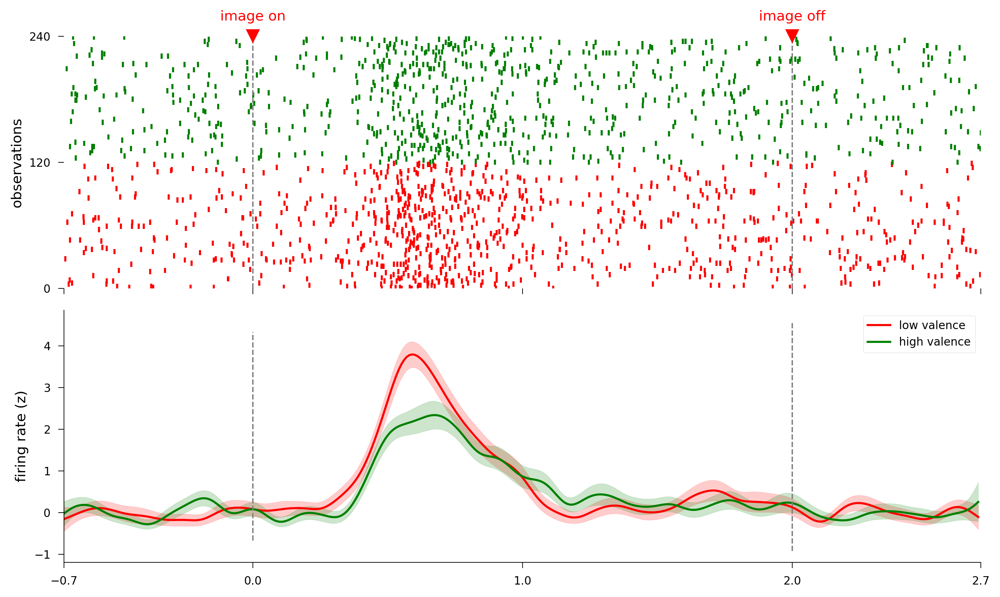

In [74]:
# Figure 2F:
# Valence example

# cluster = 1068, 952, 894, 841, 693, 603!, 406, 377!!, 303!
cluster = 377

spike_times = all_spikes[cluster-1] / 1000
sess_id = all_sess_id[cluster-1]

encoding_time_in_neural_time = [(x*sync_data.slope[sync_data.sess_id==sess_id] + sync_data.offset[sync_data.sess_id==sess_id]).values for x in all_encoding_df.time[all_encoding_df.sess_id==sess_id]]

t_range = [-0.7, 2.7]
bin_size=0.01
sigma=0.05
baseline='base'

spike_times_per_event = [] 
for event in encoding_time_in_neural_time: 
    st_to_keep_event = np.where(np.logical_and(spike_times>=event+t_range[0], 
                                               spike_times<=event+t_range[1]))[0].astype(int)
    spike_times_per_event.append(spike_times[st_to_keep_event] - event)

# Compute number of time bins and time points
n_bins = int(np.diff(t_range)[0] / bin_size)
t = np.linspace(t_range[0], t_range[1], n_bins + 1)[:-1]
# Compute firing rates
spike_counts = np.zeros((len(spike_times_per_event), n_bins))
for i in range(len(spike_times_per_event)):
    spike_counts[i], _ = np.histogram(spike_times_per_event[i], bins=n_bins, range=t_range)
        
firing_rate = spike_counts / bin_size
    
# Smooth firing rate
smoothed_rate = gaussian_filter1d(firing_rate, sigma / bin_size, mode='nearest')
    
    # Z-score firing rate across trials
if np.abs(t_range[0])> np.abs(t_range[1]):
    baseline_ix = np.where(t>=0)[0]
elif np.abs(t_range[0]) < np.abs(t_range[1]):
    baseline_ix = np.where(t<=0)[0]
        
if baseline=='all': 
    bmean = np.nanmean(smoothed_rate)
    bstd = np.nanstd(np.nanmean(smoothed_rate, axis=1))
    zscored_rate = (smoothed_rate - bmean) / bstd
elif baseline=='base':
    bmean = np.nanmean(smoothed_rate[:, baseline_ix])
    bstd = np.nanstd(np.nanmean(smoothed_rate[:, baseline_ix], axis=1))
    zscored_rate = (smoothed_rate - bmean) / bstd
if baseline==None: 
    zscored_rate = smoothed_rate
        

# Create raster plot
row_order = all_encoding_df[all_encoding_df.sess_id==sess_id].reset_index().sort_values(by='zValence', ascending=True).index.values

color = 'gray'
fig, axs = plt.subplots(nrows=2, figsize=(10, 6), sharex=True)
for ix, i in enumerate(row_order):
    if ix in range(len(row_order)//2):
        color='red'
    elif ix in range(len(row_order)-len(row_order)//2, len(row_order)):
        color='green'
    else:
        color='gray'
    axs[0].eventplot(spike_times_per_event[i], lineoffsets=ix, color=color, linelengths=5, alpha=1)
axs[0].set_xlim(t_range)
axs[0].set_ylim([0, 240])
axs[0].set_ylabel('observations')
axs[0].set_yticks([0, 120, 240])
# Remove all spines from top plot (no stroke)
axs[0].spines[['top', 'right', 'bottom', 'left']].set_visible(False)
axs[0].set_xticks([])  # Remove x-axis ticks from top plot
axs[0].tick_params(left=True, labelleft=True)  # Keep y-axis ticks and labels
# Change vertical lines to grey dashed
axs[0].vlines(0, axs[0].get_ylim()[0], axs[0].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
axs[0].vlines(2, axs[0].get_ylim()[0], axs[0].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
# Add red downward-pointing triangles with labels at top
y_top = axs[0].get_ylim()[1]
axs[0].plot(0, y_top, 'v', color='red', markersize=10, clip_on=False)
axs[0].text(0, y_top * 1.05, 'image on', ha='center', va='bottom', color='red', fontsize=10, clip_on=False)
axs[0].plot(2, y_top, 'v', color='red', markersize=10, clip_on=False)
axs[0].text(2, y_top * 1.05, 'image off', ha='center', va='bottom', color='red', fontsize=10, clip_on=False)


# Create firing rate plot split between the high and low data in order
# First half = low valence (sorted ascending)
median_split_trials_low = row_order[:len(row_order)//2]
unit_mean_low = zscored_rate[median_split_trials_low, :].mean(axis=0)
unit_std_low = zscored_rate[median_split_trials_low, :].std(axis=0) / np.sqrt(zscored_rate[median_split_trials_low,:].shape[0])

# Last half = high valence
median_split_trials_high = row_order[-len(row_order)//2:]
unit_mean_high = zscored_rate[median_split_trials_high, :].mean(axis=0)
unit_std_high = zscored_rate[median_split_trials_high, :].std(axis=0) / np.sqrt(zscored_rate[median_split_trials_high,:].shape[0])

# Plot with correct colors: red for low valence, green for high valence
sns.lineplot(x=t, y=unit_mean_low, ax=axs[1], color='red', label='low valence')
axs[1].fill_between(t, unit_mean_low - unit_std_low, unit_mean_low + unit_std_low,
                    alpha=0.2, color='red')

sns.lineplot(x=t, y=unit_mean_high, ax=axs[1], color='green', label='high valence')
axs[1].fill_between(t, unit_mean_high - unit_std_high, unit_mean_high + unit_std_high,
                    alpha=0.2, color='green')

axs[1].set_xlabel('time (s)')
axs[1].set_ylabel('firing rate (z)')
axs[1].set_xticks([-0.7, 0, 1, 2, 2.7])
# Change vertical lines to grey dashed
axs[1].vlines(0, axs[1].get_ylim()[0], axs[1].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
axs[1].vlines(2, axs[1].get_ylim()[0], axs[1].get_ylim()[1], color='grey', linestyle='--', linewidth=1)
# Add legend
axs[1].legend(loc='upper right')

plt.tight_layout()

plt.show()


In [87]:
# # Conduct the regressions: 
# all_fr_dfs =  pd.read_csv(f'{datapath}/firing_rate_df_regression_public.csv')

# X_bi = ['animal_bi', 'human_face_bi',
#        'human_noface_bi',
#        'natural_object_bi', 'manmade_object_bi']

# X = ['arousal', 'valence', 'brightness', 'contrast', 'spatial_frequency', 'complexity', 'sin_orientation', 'cos_orientation']

# all_fr_dfs['recalled'] = all_fr_dfs['recalled'].apply(lambda x: -1 if x==0 else x)

# pred_X = X+X_bi

# predictors = " + ".join(pred_X)

# pd.options.mode.chained_assignment = None  # default='warn'

# n_permutations = 1000

# all_res = [] 
# for x in all_fr_dfs.cluster.unique():
#     for encoding_window in ['early']:
#         formula = f'evoked_fr_{encoding_window} ~ 1 + {predictors} + recalled + C(environment_bi, Treatment(0))'

#         su_df = all_fr_dfs[all_fr_dfs.cluster==x]
#         su_df['recalled'] = su_df['recalled'].astype(int)
        
#         su_df = su_df[['subj', 'region', 'cluster', 'recalled',
#                        f'trial_fr_encoding_{encoding_window}', f'evoked_fr_{encoding_window}', 'category', 'environment_bi'] + pred_X]
     
#         su_df = su_df.dropna()
#         results = permutation_regression_zscore(su_df, formula, n_permutations=n_permutations)
        
#         results['subj'] = su_df.subj.unique()[0]
#         results['region'] = su_df.region.unique()[0]
#         results['cluster'] = su_df.cluster.unique()[0]

#         results['encoding_window'] = encoding_window

#         results['category'] = 0 
#         results['animal'] = 0
#         results['human_face'] = 0
#         results['human_noface'] = 0
#         results['indoor_env'] = 0
#         results['outdoor_env'] = 0
#         results['natural_object'] = 0
#         results['manmade_object'] = 0
#         results['brightness_cell'] = 0 
#         results['contrast_cell'] = 0
#         results['complexity_cell'] = 0 
#         results['spatial_frequency_cell'] = 0
#         results['verticality_cell'] = 0
#         results['horizontality_cell'] = 0
#         results['arousal_cell'] = 0 
#         results['valence_cell'] = 0 
#         results['memory_cell'] = 0 

    
#         if results.loc[results['predictor'] == 'animal_bi', 'z_p'].values[0] <= 0.05:
#             results['animal']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'human_face_bi', 'z_p'].values[0] <= 0.05:
#             results['human_face']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'human_noface_bi', 'z_p'].values[0] <= 0.05:
#             results['human_noface']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'C(environment_bi, Treatment(0))[T.-1]', 'z_p'].values[0] <= 0.05:
#             results['indoor_env']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'C(environment_bi, Treatment(0))[T.1]', 'z_p'].values[0] <= 0.05:
#             results['outdoor_env']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'natural_object_bi', 'z_p'].values[0] <= 0.05:
#             results['natural_object']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'manmade_object_bi', 'z_p'].values[0] <= 0.05:
#             results['manmade_object']  = 1   
#             results['category'] = 1
#         if results.loc[results['predictor'] == 'valence', 'z_p'].values[0] <= 0.05:
#             results['valence']  = 1   
#         if results.loc[results['predictor'] == 'arousal', 'z_p'].values[0] <= 0.05:
#             results['arousal']  = 1
#         if results.loc[results['predictor'] == 'brightness', 'z_p'].values[0] <= 0.05:
#             results['brightness']  = 1
#         if results.loc[results['predictor'] == 'contrast', 'z_p'].values[0] <= 0.05:
#             results['contrast']  = 1
#         if results.loc[results['predictor'] == 'spatial_frequency', 'z_p'].values[0] <= 0.05:
#             results['spatial_frequency']  = 1
#         if results.loc[results['predictor'] == 'complexity', 'z_p'].values[0] <= 0.05:
#             results['complexity']  = 1
#         if results.loc[results['predictor'] == 'sin_orientation', 'z_p'].values[0] <= 0.05:
#             results['verticality']  = 1
#         if results.loc[results['predictor'] == 'cos_orientation', 'z_p'].values[0] <= 0.05:
#             results['horizontality']  = 1
#         if results.loc[results['predictor'] == 'recalled', 'z_p'].values[0] <= 0.05:
#             results['memory']  = 1

#         all_res.append(results)
        
# # all_res_df = pd.concat(all_res)
# # all_res_df.to_csv('/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/all_cells_regress_public.csv')


/opt/anaconda3/envs/mec-grid-notebook/lib/python3.10/site-packages/upsetplot/plotting.py:795: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  styles["linewidth"].fillna(1, inplace=True)
/opt/anaconda3/envs/mec-grid-notebook/lib/python3.10/site-packages/upsetplot/plotting.py:796: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are 

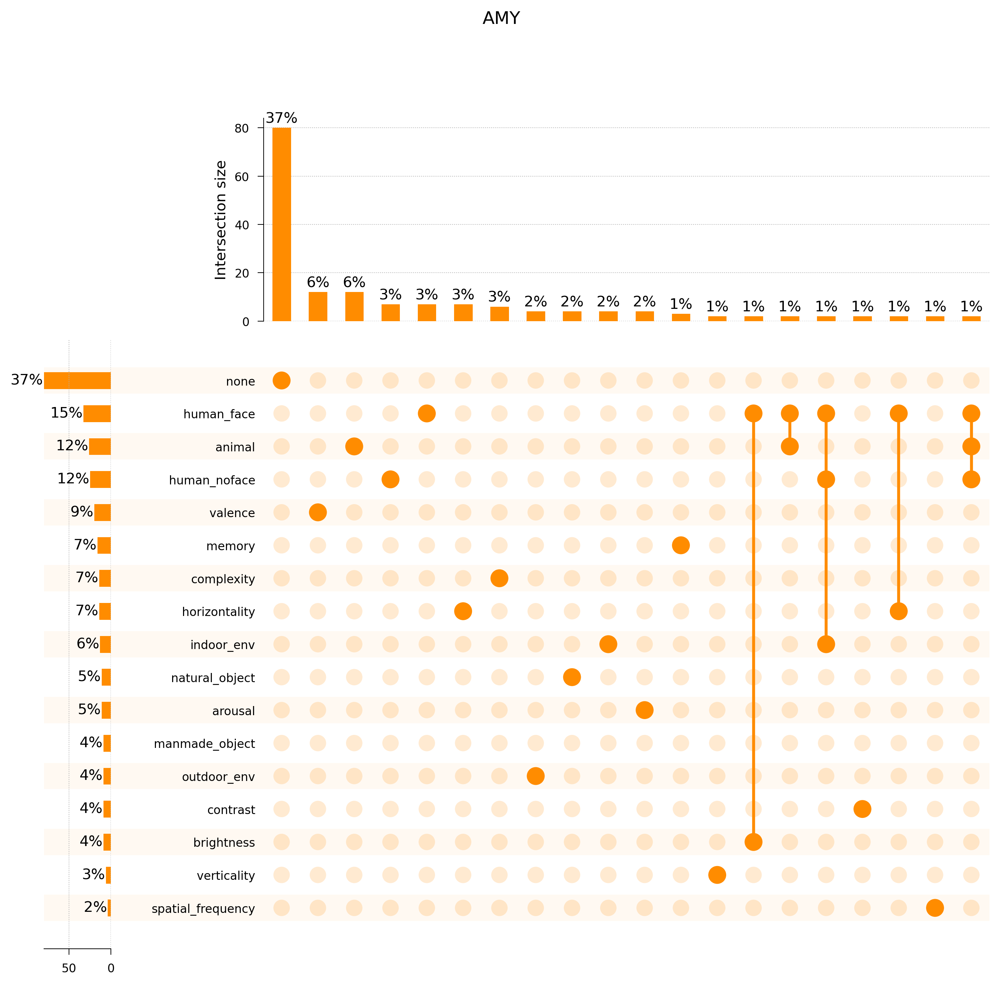

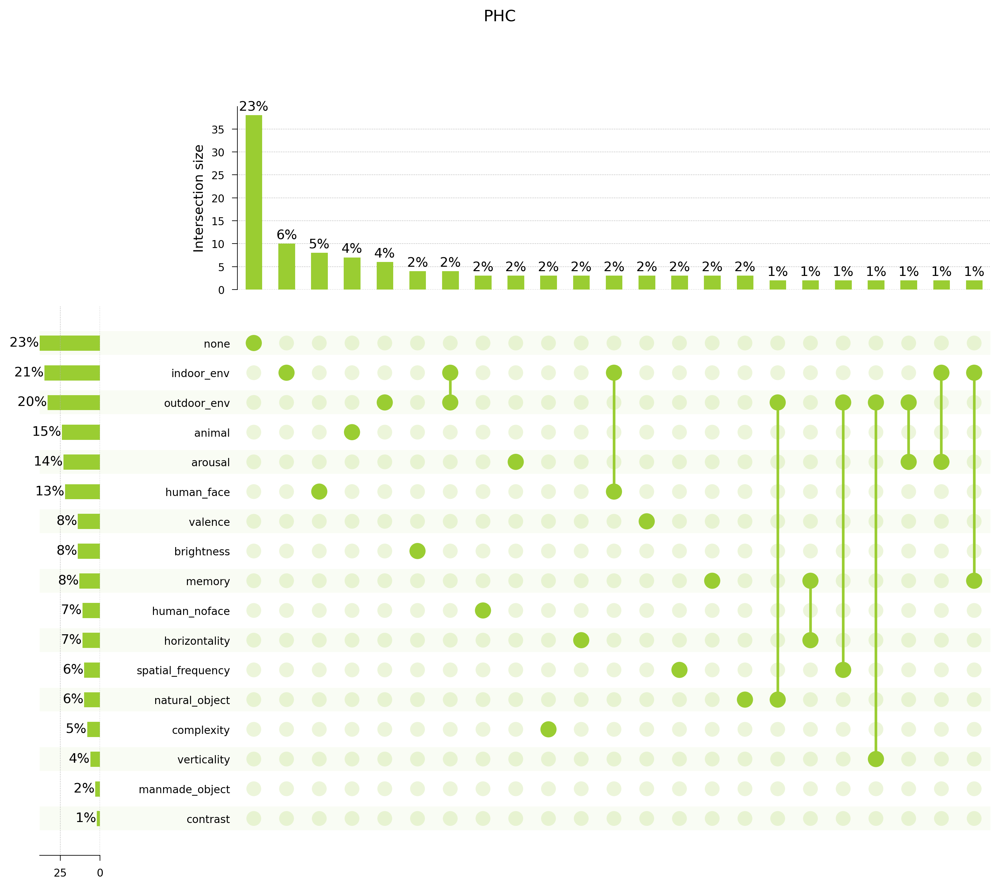

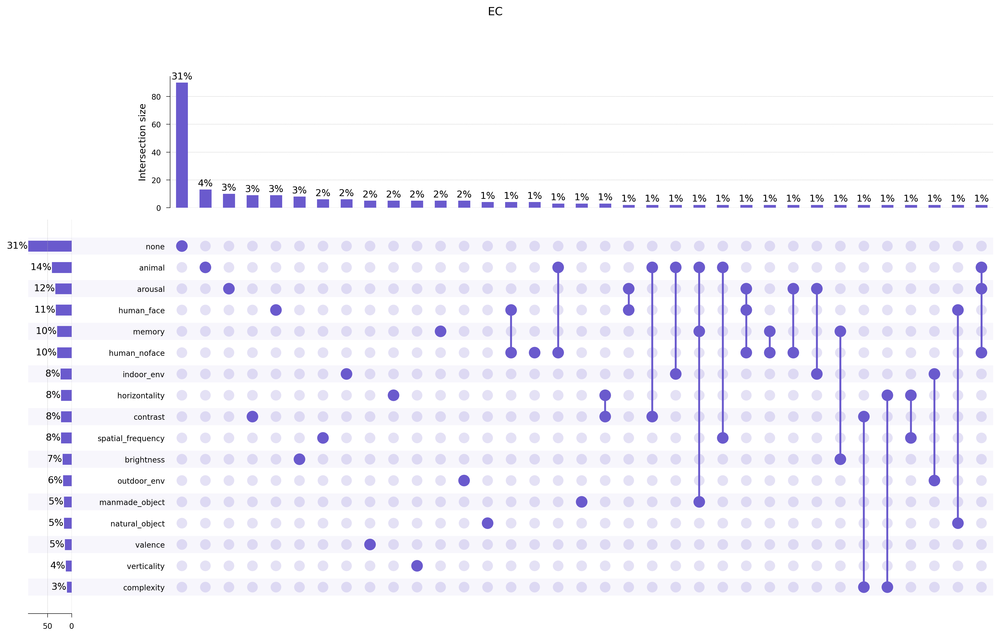

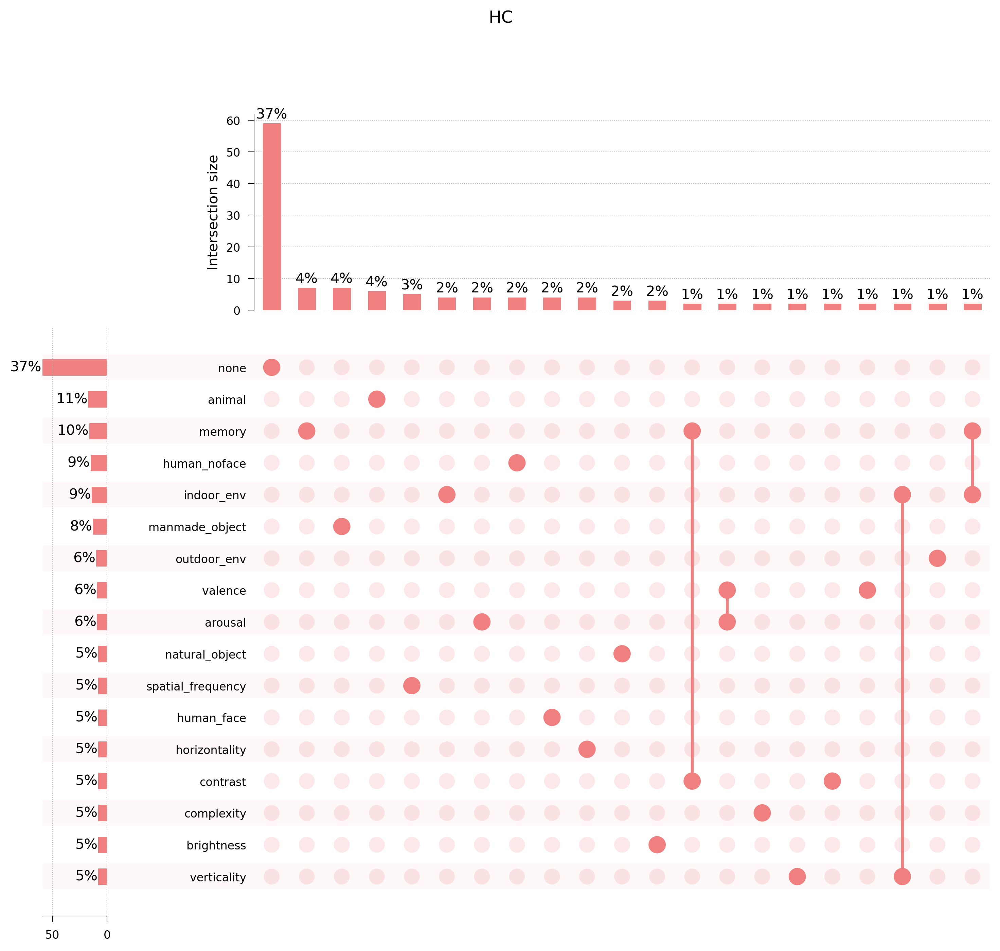

In [76]:
# Figure 2C:
# Make the upset plots

all_res_df = pd.read_csv(f'{datapath}/all_cells_regress_public.csv')

# filter out cells with less than 100 spikes and from temporal pole
all_res_df = all_res_df[(all_res_df.nspikes_total>=100) & (all_res_df.region!='TP')]

# restrict to early time window [0.2, 1]
all_res_df = all_res_df[(all_res_df.encoding_window=='early')]

colors_dict={'EC':'slateblue',
             'HC': 'lightcoral',
             'AMY': 'darkorange',
             'PHC': 'yellowgreen'}
        
for region in all_res_df.region.unique():
    plot_df = all_res_df[all_res_df.region==region].groupby('cluster').mean(numeric_only=True).reset_index()[['animal', 
                                                                                                              'human_face',
                                                                                                              'human_noface',
                                                                                                              'indoor_env',
                                                                                                              'outdoor_env',
                                                                                                              'natural_object',
                                                                                                              'manmade_object',
                                                                                                              'arousal', 
                                                                                                              'valence',
                                                                                                              'brightness', 
                                                                                                              'contrast',
                                                                                                              'spatial_frequency',
                                                                                                              'verticality',
                                                                                                              'horizontality',
                                                                                                              'complexity',
                                                                                                             'memory']]


    result = []
    for index, row in plot_df.iterrows():
        result.append([col for col in plot_df.columns if row[col] == 1])
    result = [x if len(x)>0 else ['none'] for x in result]

    # Create the DataFrame
    all_cells = sorted(set(cell for row in result for cell in row))  # Sorting for consistency

    # Convert to a list of dictionaries
    binary_rows = [{cell: (cell in row) for cell in all_cells} for row in result]

    # Convert to DataFrame and add count column
    df = pd.DataFrame(binary_rows)
    df["count"] = 1  # Initialize count to 1 for each row

    # Convert to dictionary format (if needed)
    result_dict = df.to_dict(orient="list")

    df = pd.DataFrame(result_dict)

    # Group by all columns except 'count' and sum the counts
    series_grouped = df.groupby(df.columns[:-1].tolist())["count"].sum()

    # Make plots
    plot(series_grouped, show_percentages="{:.0%}", min_subset_size=2, facecolor=colors_dict[region], sort_by='cardinality', sort_categories_by='-cardinality')
    plt.suptitle(f'{region}')
    

In [77]:
feature_coding_cells = np.where(all_res_df[['animal', 'human_face', 'human_noface',
       'indoor_env', 'outdoor_env', 'natural_object',
       'manmade_object', 'brightness', 'contrast',
       'arousal', 'valence', 'memory']].sum(axis=1)>0)
non_coding_cells = np.where(all_res_df[['animal', 'human_face', 'human_noface',
       'indoor_env', 'outdoor_env', 'natural_object',
       'manmade_object', 'brightness', 'contrast',
       'arousal', 'valence', 'memory']].sum(axis=1)==0)

feature_coding_cell_df = all_res_df.iloc[feature_coding_cells].groupby(['sess_id', 'cluster', 'region']).mean(numeric_only=True).reset_index()

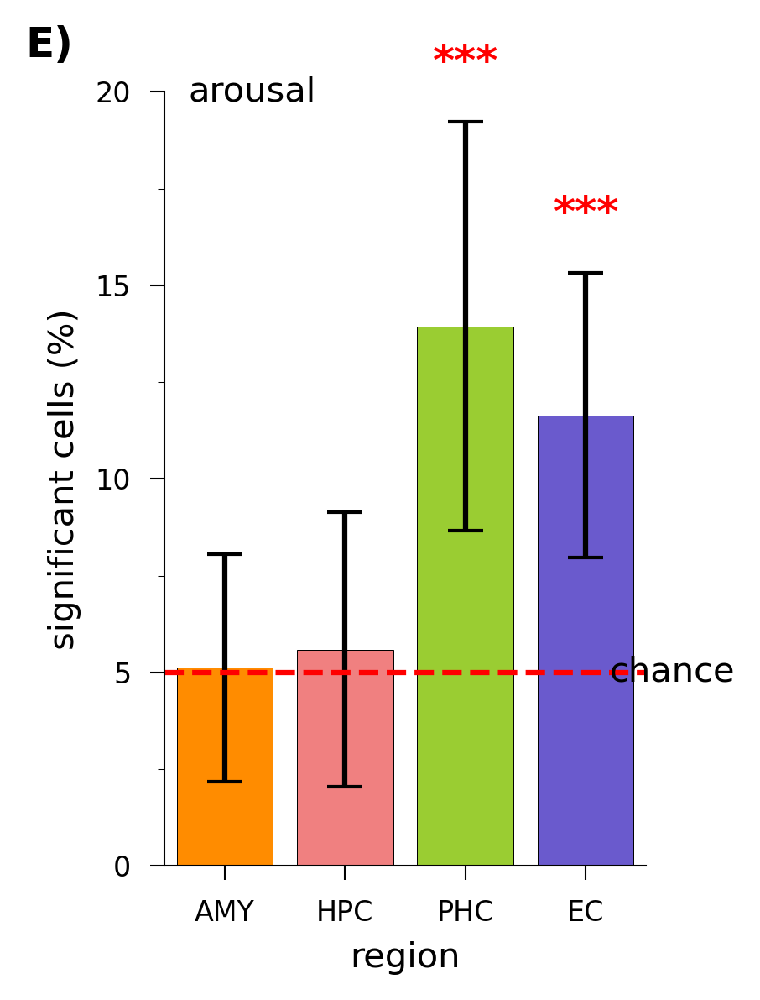

In [87]:
# Figure 2E:

significant_obs = feature_coding_cell_df.groupby('region').sum().arousal.astype(int)  # Number of significant observations
total_obs = all_res_df.drop_duplicates('cluster').region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, 'greater')
    
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")
    
    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci

from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Reorder dataframe to match x-axis order: AMY, HPC, PHC, EC
# Note: 'HC' in data corresponds to 'HPC' in display
region_order = ['AMY', 'HC', 'PHC', 'EC']
percent_df['region_display'] = percent_df['region'].replace({'HC': 'HPC'})
percent_df_ordered = percent_df.set_index('region').reindex(region_order).reset_index()
percent_df_ordered['region_display'] = percent_df_ordered['region'].replace({'HC': 'HPC'})

# Create the bar plot
f, ax = plt.subplots(1, 1, figsize=[3,4], dpi=300) # initialize the figure 

# Get colors in order using the predefined colors_dict
bar_colors = [colors_dict.get(region, 'skyblue') for region in percent_df_ordered['region']]

bars = ax.bar(percent_df_ordered['region_display'], percent_df_ordered['mean'], 
               yerr=[percent_df_ordered['mean'] - percent_df_ordered['lci'], 
                     percent_df_ordered['hci'] - percent_df_ordered['mean']],
               capsize=5, color=bar_colors, edgecolor='black', error_kw={'color': 'black', 'capthick': 1})

# Add asterisks for significant p-values at top of error bars
for i, bar in enumerate(bars):
    pval = percent_df_ordered.iloc[i]['p-value']
    hci = percent_df_ordered.iloc[i]['hci']
    if pval <= 0.05:
        # Position asterisk at top of error bar (hci)
        y_pos = hci + 1
        ax.text(bar.get_x() + bar.get_width() / 2, y_pos, '***', 
                 ha='center', va='bottom', fontsize=12, color='red', fontweight='bold')

# Set x-axis limits to accommodate labels
ax.set_xlim([-0.5, 3.5])

# Add horizontal chance line (red dashed)
ax.axhline(y=5, color='red', linestyle='--', linewidth=1.5, xmin=0, xmax=1)
ax.text(3.2, 5, 'chance', ha='left', va='center', color='black', fontsize=10)

# Add "arousal" label at top-left of plotting area
ax.text(-0.3, 20, 'arousal', ha='left', va='center', color='black', fontsize=10)

# Label the axes
ax.set_xlabel('region')
ax.set_ylabel('significant cells (%)')
ax.set_ylim([0, 20])
ax.set_yticks([0, 5, 10, 15, 20])
ax.set_yticks([2.5, 7.5, 12.5, 17.5], minor=True)

# Add "E)" label in top-left corner
f.text(0.02, 0.98, 'E)', fontsize=12, fontweight='bold', va='top', ha='left', transform=f.transFigure)

sns.despine()
# Show the plot
plt.tight_layout()

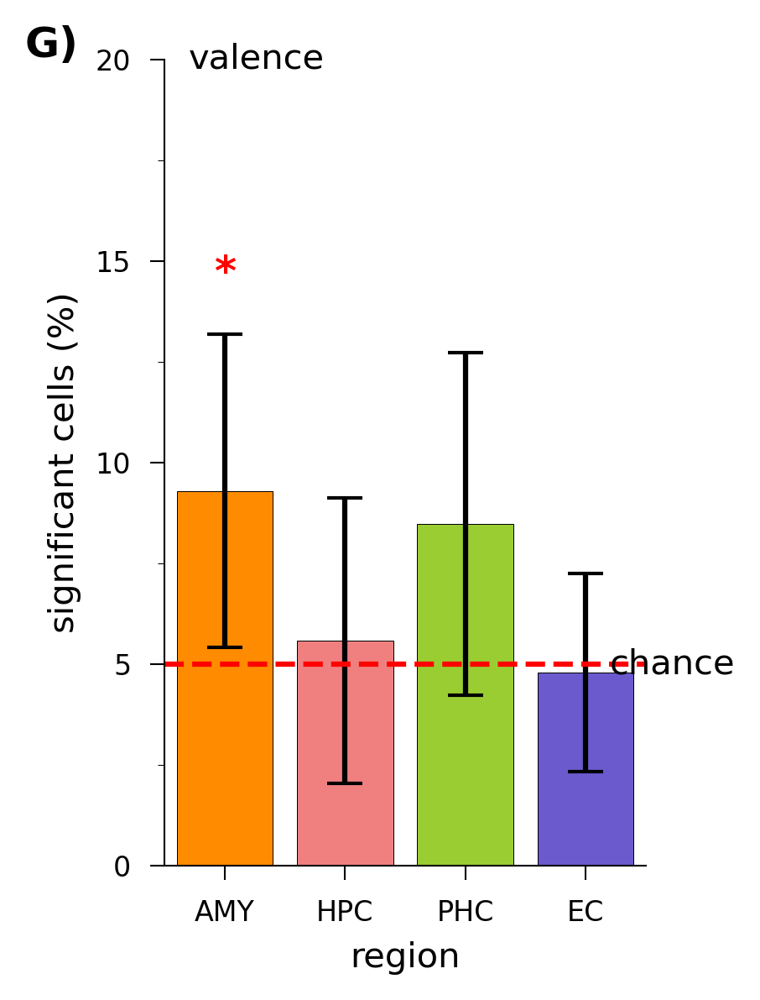

In [89]:
# Figure 2G:

significant_obs = feature_coding_cell_df.groupby('region').sum().valence.astype(int)  # Number of significant observations
total_obs = all_res_df.drop_duplicates('cluster').region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, 'greater')
    
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci

from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Reorder dataframe to match x-axis order: AMY, HPC, PHC, EC
# Note: 'HC' in data corresponds to 'HPC' in display
region_order = ['AMY', 'HC', 'PHC', 'EC']
percent_df['region_display'] = percent_df['region'].replace({'HC': 'HPC'})
percent_df_ordered = percent_df.set_index('region').reindex(region_order).reset_index()
percent_df_ordered['region_display'] = percent_df_ordered['region'].replace({'HC': 'HPC'})

# Create the bar plot
f, ax = plt.subplots(1, 1, figsize=[3,4], dpi=300) # initialize the figure 

# Get colors in order using the predefined colors_dict
bar_colors = [colors_dict.get(region, 'skyblue') for region in percent_df_ordered['region']]

bars = ax.bar(percent_df_ordered['region_display'], percent_df_ordered['mean'], 
               yerr=[percent_df_ordered['mean'] - percent_df_ordered['lci'], 
                     percent_df_ordered['hci'] - percent_df_ordered['mean']],
               capsize=5, color=bar_colors, edgecolor='black', error_kw={'color': 'black', 'capthick': 1})

# Add asterisks for significant p-values at top of error bars
for i, bar in enumerate(bars):
    pval = percent_df_ordered.iloc[i]['p-value']
    hci = percent_df_ordered.iloc[i]['hci']
    if pval <= 0.05:
        # Position asterisk at top of error bar (hci)
        y_pos = hci + 1
        ax.text(bar.get_x() + bar.get_width() / 2, y_pos, '*', 
                 ha='center', va='bottom', fontsize=12, color='red', fontweight='bold')

# Set x-axis limits to accommodate labels
ax.set_xlim([-0.5, 3.5])

# Add horizontal chance line (red dashed)
ax.axhline(y=5, color='red', linestyle='--', linewidth=1.5, xmin=0, xmax=1)
ax.text(3.2, 5, 'chance', ha='left', va='center', color='black', fontsize=10)

# Add "valence" label at top-left of plotting area
ax.text(-0.3, 20, 'valence', ha='left', va='center', color='black', fontsize=10)

# Label the axes
ax.set_xlabel('region')
ax.set_ylabel('significant cells (%)')
ax.set_ylim([0, 20])
ax.set_yticks([0, 5, 10, 15, 20])
ax.set_yticks([2.5, 7.5, 12.5, 17.5], minor=True)

# Add "G)" label in top-left corner
f.text(0.02, 0.98, 'G)', fontsize=12, fontweight='bold', va='top', ha='left', transform=f.transFigure)

sns.despine()
# Show the plot
plt.tight_layout()

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  # This is added back by InteractiveShellApp.init_path()
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad

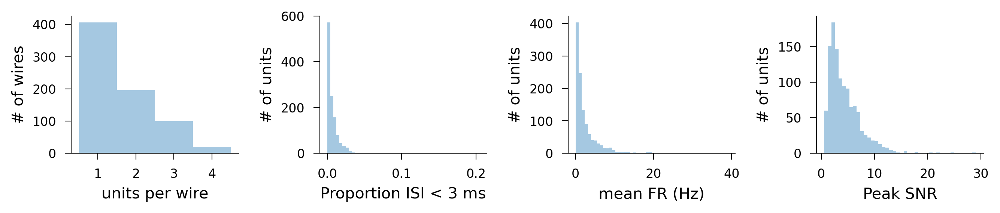

In [ ]:
# Figure S2F-I:

quality_metrics = {'num_units_per_wire': [], 
                   'ici_percentage': [] , 
                   'mean_fr': [], 
                   'A_peak': [], 
                   'median_deviation': [],
                   'peak_snr': []}
for key in quality_metrics.keys():
    quality_metrics[key] = np.load(f"/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Neural/{key}_4_1_25.npy", allow_pickle=True)

f, ax = plt.subplots(1, 4, figsize=[9,2], dpi=300) # initialize the figure 
sns.distplot(quality_metrics['num_units_per_wire'], ax=ax[0], bins=np.linspace(0.5, 4.5, 5), kde=False)
sns.distplot(quality_metrics['ici_percentage'], ax=ax[1], kde=False)
sns.distplot(quality_metrics['mean_fr'], ax=ax[2], kde=False)
sns.distplot(quality_metrics['peak_snr'], ax=ax[3],  kde=False)

ax[0].set(xlabel='units per wire', ylabel='# of wires', xticks = [1, 2, 3, 4])
ax[1].set(xlabel='Proportion ISI < 3 ms', ylabel='# of units')
ax[2].set(xlabel='mean FR (Hz)', ylabel='# of units')
ax[3].set(xlabel='Peak SNR', ylabel='# of units')

f.tight_layout()

# Periodic spiking in the entorhinal cortex maps 2D emotion space remniscient of grid cells.

In [96]:
# # Run the main analysis in parallel using DASK
# client = dask_utils.new_dask_client('grid_cell', '7GB', max_n_jobs=100)
# futures = client.map(grid_utils.grid_score_parallel, range(len(all_cell_num)))

In [105]:
# Load the main analysis 
condensed_df = pd.read_csv(f'{datapath}/condensed_df_public.csv')
all_cell_res = pd.read_csv(f'{datapath}/all_cell_res_public.csv')
all_trial_res = pd.read_csv(f'{datapath}/all_trial_res_public.csv')

# Get rid of temporal pole data
condensed_df = condensed_df[condensed_df.region!='TP']
all_cell_res = all_cell_res[all_cell_res.region!='TP']
all_trial_res = all_trial_res[all_trial_res.region!='TP']

# Let's get the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
firing_rate_mask = (condensed_df.nspikes_total>=100)

condensed_df['grid_cell'] = (grid_cell_mask) & (firing_rate_mask)


In [91]:
# Make Table S1: 

summary_df = (
    condensed_df.groupby(['subj_id', 'region', 'study_site'])
      .agg(n_sessions=('sess_id', 'nunique'), 
           nAMY=('n_wires_AMY', 'mean'), 
           nEC=('n_wires_EC', 'mean'), 
           nHC=('n_wires_HC', 'mean'), 
           nPHC=('n_wires_PHC', 'mean'), 
           n_clusters=('cluster', 'nunique'))
      .reset_index()
      .pivot(index=['subj_id', 'study_site', 'n_sessions', 'nAMY', 'nEC', 'nHC', 'nPHC'],
             columns='region',
             values=['n_clusters'])
      .fillna(0)
      .reset_index()
)
summary_df = summary_df.rename(columns={'n_clusters': '# of neurons per region',
                                        'n_sessions': '# of sessions',
                                        'subj_id':'subj', 
                                        'study_site': 'study site', 
                                        'nAMY': 'AMY micros',
                                        'nEC': 'EC micros',
                                        'nHC': 'HPC micros',
                                        'nPHC': 'PHC micros'}).fillna(0)

summary_df

subj study site # of sessions AMY micros EC micros HPC micros  \
region                                                                  
0        1.0   Freiburg             1        2.0       1.0        1.0   
1        2.0   Freiburg             1        0.0       0.0        1.0   
2        3.0   Freiburg             1        1.0       1.0        1.0   
3        4.0   Freiburg             1        1.0       0.0        2.0   
4        5.0   Freiburg             1        1.0       0.0        2.0   
5        6.0   Freiburg             1        2.0       0.0        3.0   
6        7.0   Freiburg             1        2.0       1.0        2.0   
7        8.0   Freiburg             2        0.0       1.0        1.0   
8        9.0   Freiburg             1        1.0       1.0        0.0   
9       10.0   Freiburg             1        2.0       1.0        2.0   
10      11.0   Freiburg             1        1.0       1.0        1.0   
11      12.0   Freiburg             1        2.0       1.0        2.0   
12      13.0   Freiburg             1        1.0       1.0        1.0   
13      14.0       Bonn             2        2.0       2.0        2.0   
14      15.0       Bonn             2        2.0       2.0        2.0   
15      16.0       Bonn             5        2.0       2.0        2.0   
16      17.0       Bonn             1        3.0       3.0        4.0   
17      18.0       Bonn             2        2.0       2.0        2.0   
18      19.0   Freiburg             1        1.0       1.0        1.0   
19      20.0   Freiburg             1        1.0       1.0        1.0   
20      21.0   Freiburg             1        1.0       1.0        1.0   
21      22.0   Freiburg             2        1.0       1.0        2.0   

       PHC micros # of neurons per region                    
region                                AMY    EC    HC   PHC  
0             1.0                    10.0  10.0   2.0   6.0  
1             1.0                     0.0   0.0   2.0   0.0  
2             1.0                    20.0  17.0  13.0   4.0  
3             1.0                     3.0   0.0   5.0  14.0  
4             1.0                    20.0   0.0   0.0   0.0  
5             0.0                    17.0   0.0  11.0   0.0  
6             1.0                    26.0   1.0   0.0   0.0  
7             1.0                     0.0  25.0   6.0   4.0  
8             0.0                    12.0  16.0   0.0   0.0  
9             1.0                    28.0   6.0   5.0   5.0  
10            1.0                    17.0  22.0  10.0  10.0  
11            1.0                    13.0   6.0  16.0  24.0  
12            1.0                     8.0  28.0   4.0  15.0  
13            2.0                    30.0  32.0  17.0  21.0  
14            3.0                    23.0  34.0  14.0  32.0  
15            2.0                    36.0  94.0  54.0  37.0  
16            2.0                    11.0  10.0  12.0   9.0  
17            1.0                    22.0  21.0  25.0   6.0  
18            1.0                     3.0   0.0   4.0   0.0  
19            1.0                     9.0   0.0   1.0   0.0  
20            1.0                     8.0   8.0   4.0   8.0  
21            0.0                     9.0  10.0  21.0   0.0

/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/1636139063.py:40: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/1636139063.py:40: FutureWarning: The provided callable <function nanmean at 0x107bd6560> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.
  binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
/Users/salmanqasim/Documents/GitRepos/emotion-grids/code/grid_utils.py:3300: RuntimeWarning: invalid value encountered in divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smooth

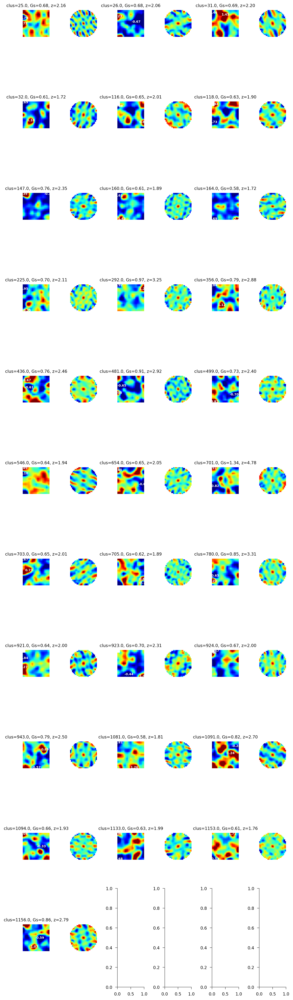

In [94]:
# Figure 3B and S4:
# Plot all the entorhinal grid cells

# Set up parameters
nbins = 15
nrows, ncols = 11, 3
total_cells = nrows * ncols
spiking_metric = 'evoked_fr'
timeframe = 'early_trunc'

# Limit to desired number of cells
cells_to_plot = condensed_df[(condensed_df.grid_cell==True) & (condensed_df.region == 'EC')].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

mean_prominences = []
entropies = []
for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res[
        (all_trial_res.sess_id == cell.sess_id) &
        (all_trial_res.region == cell.region) &
        (all_trial_res.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['valence'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['valence_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
        {f'{spiking_metric}_{timeframe}': np.nanmean}
    ).reset_index()

    rate_map = binned_data.pivot(index='arousal_binned', columns='valence_binned', values=f'{spiking_metric}_{timeframe}').T
    
    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # # Field + peak detection
    # peaks, fields = grid_utils.find_grid_fields(
    #     fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
    #     peak_thresh_z=1, field_max_thresh=4, gain=2
    # )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()

In [96]:
# Get dataframes for different symmetries: 

sixfold_df = all_cell_res[(all_cell_res.symmetry==6)].reset_index(drop=True)
sixfold_df = sixfold_df.merge(condensed_df[['cluster', 'nspikes_total']], on=['cluster'])

firing_rate_mask = sixfold_df.nspikes_total>=100
grid_cell_mask = (sixfold_df.computed_p_label<=0.05) & (firing_rate_mask)
sixfold_df['grid_cell'] = grid_cell_mask
sixfold_grid_clusters = sixfold_df[sixfold_df.grid_cell==1].cluster.values


fourfold_df = all_cell_res[(all_cell_res.symmetry==4)].reset_index(drop=True)
fourfold_df = fourfold_df.merge(condensed_df[['cluster', 'nspikes_total']], on=['cluster'])

firing_rate_mask = fourfold_df.nspikes_total>=100
grid_cell_mask = (fourfold_df.computed_p_label<=0.05) & (firing_rate_mask)
fourfold_df['grid_cell'] = grid_cell_mask
fourfold_grid_clusters = fourfold_df[fourfold_df.grid_cell==1].cluster.values


eightfold_df = all_cell_res[(all_cell_res.symmetry==8)].reset_index(drop=True)
eightfold_df = eightfold_df.merge(condensed_df[['cluster', 'nspikes_total']], on=['cluster'])

firing_rate_mask = eightfold_df.nspikes_total>=100
grid_cell_mask = (eightfold_df.computed_p_label<=0.05) & (firing_rate_mask)
eightfold_df['grid_cell'] = grid_cell_mask
eightfold_grid_clusters = eightfold_df[eightfold_df.grid_cell==1].cluster.values

/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/2258905702.py:27: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels([int(float(label.get_text())) for label in ax.get_xticklabels()])


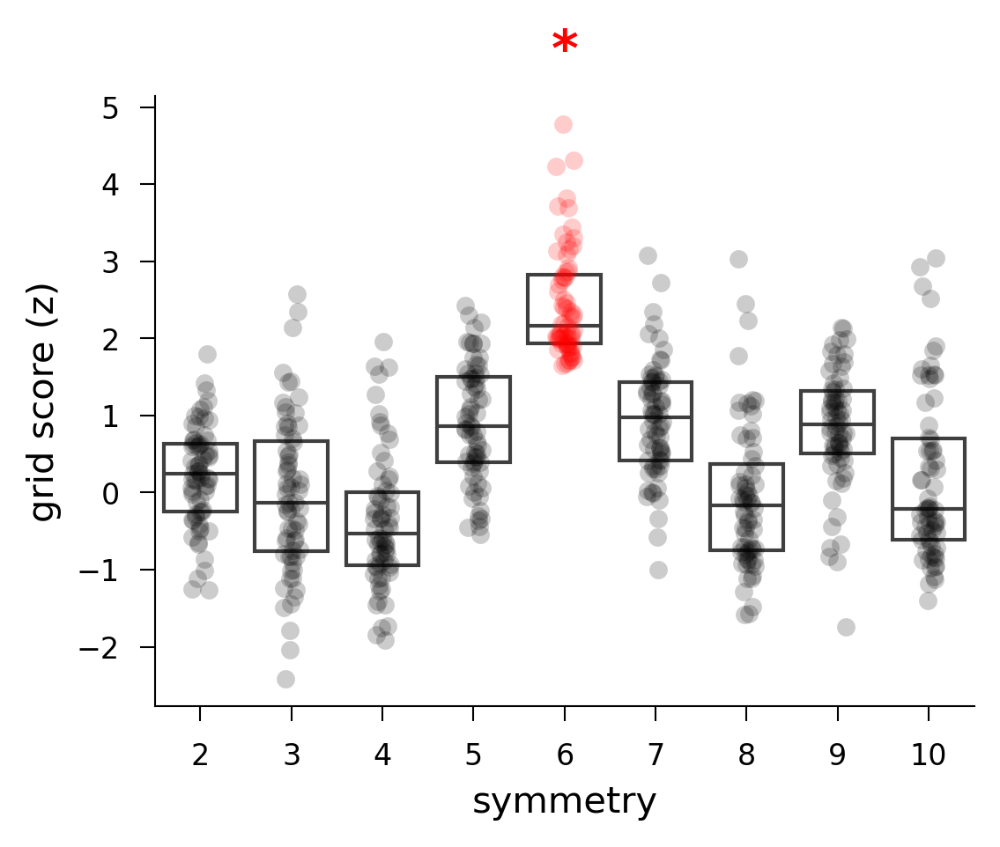

In [103]:
# Figure 4A: 
# 6-fold symmetry: 

f, ax = plt.subplots(1,1, dpi=300)

data = all_cell_res[all_cell_res.cluster.isin(sixfold_grid_clusters)]

# Plot boxplot
sns.boxplot(data=data, 
            x='symmetry', y='zGs_label', showcaps=False, boxprops={'facecolor':'None'}, 
            showfliers=False, whiskerprops={'linewidth':0}, ax=ax)

# Get symmetry values in order
symmetry_values = sorted(data['symmetry'].unique())

# Find the index of symmetry==6
symmetry_6_idx = symmetry_values.index(6) if 6 in symmetry_values else None

# Plot stripplot with colors based on symmetry
for sym_val in symmetry_values:
    data_subset = data[data.symmetry == sym_val]
    color = 'red' if sym_val == 6 else 'black'
    sns.stripplot(data=data_subset, 
                  x='symmetry', y='zGs_label', alpha=0.2, ax=ax, color=color)

# Format x-axis ticks as integers (no decimals)
ax.set_xticklabels([int(float(label.get_text())) for label in ax.get_xticklabels()])

# Add red asterisk above symmetry==6 bar
if symmetry_6_idx is not None:
    # Get the maximum y-value for symmetry==6 data
    data_six = data[data.symmetry == 6]
    y_max = data_six['zGs_label'].max()
    y_lim_top = ax.get_ylim()[1]
    # Position asterisk above the bar
    ax.text(symmetry_6_idx, y_lim_top * 1.05, '*', ha='center', va='bottom', 
            color='red', fontsize=14, fontweight='bold')

ax.set(ylabel='grid score (z)')
sns.despine()
# plt.savefig(f'{save_dir_plots}/6FOLD_Gridness_by_symmetry.pdf', dpi=300)



## Control analyses

### Rodent dataset:

Note: I do not duplicate the publicly available rodent datasets here. Please download from :

https://archive.sigma2.no/dataset/A423437F-71E1-4396-9B0B-056E00C23254

In [46]:
# ACTION ITEM: Load the rat data 
# all_cells_merged_path = '../Data_sargolini/box100/merged'
all_cell_files = glob.glob(f'{all_cells_merged_path}/*.mat')
boxSize = 100
smooth_width = 1

In [61]:
rat_df = pd.read_csv(f'{datapath}/rat_df.csv')

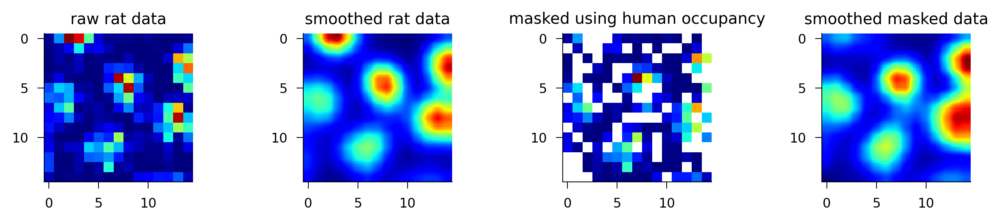

In [ ]:
# Figure S5A-B:

# get the unmolested rate map

trunc = 2
cells_to_choose_from = rat_df[(rat_df.bin_size==15) & (rat_df.real_gridness_z>6)].cell_ids.unique()

cell = [x for x in all_cell_files if cells_to_choose_from[0] in x][0]
posx, posy, t, dt, spiketrain, smoothFiringRate = find_grid_cells.load_data(cell)

rat_map, _ = calculate_2d_tuning_curve(posx, posy, smoothFiringRate, nbins, 0, boxSize)
rat_map_masked = rat_map.copy()
rat_map_masked[np.isnan(occ_mask)] = np.nan

V=rat_map.copy()
V[np.isnan(rat_map)]=0
VV=gaussian_filter(V, sigma=smooth_width, mode='constant', truncate=trunc)

W=0*rat_map.copy()+1
W[np.isnan(rat_map)]=0
WW=gaussian_filter(W, sigma=smooth_width, mode='constant', truncate=trunc)

rat_map_smooth =VV/WW

V=rat_map_masked.copy()
V[np.isnan(rat_map_masked)]=0
VV=gaussian_filter(V, sigma=smooth_width, mode='constant', truncate=trunc)

W=0*rat_map_masked.copy()+1
W[np.isnan(rat_map_masked)]=0
WW=gaussian_filter(W, sigma=smooth_width, mode='constant', truncate=trunc)

rat_map_smooth_masked=VV/WW


f, ax = plt.subplots(1, 4, figsize=[9,2], dpi=300) # initialize the figure 

ax[0].imshow(rat_map,  cmap='jet')
ax[0].set_title('raw rat data')
ax[1].imshow(rat_map_smooth, cmap='jet', interpolation='hamming')
ax[1].set_title('smoothed rat data')
ax[2].imshow(rat_map_masked, cmap='jet')
ax[2].set_title('masked using human occupancy')
ax[3].imshow(rat_map_smooth_masked, cmap='jet', interpolation='hamming')
ax[3].set_title('smoothed masked data')

f.tight_layout()


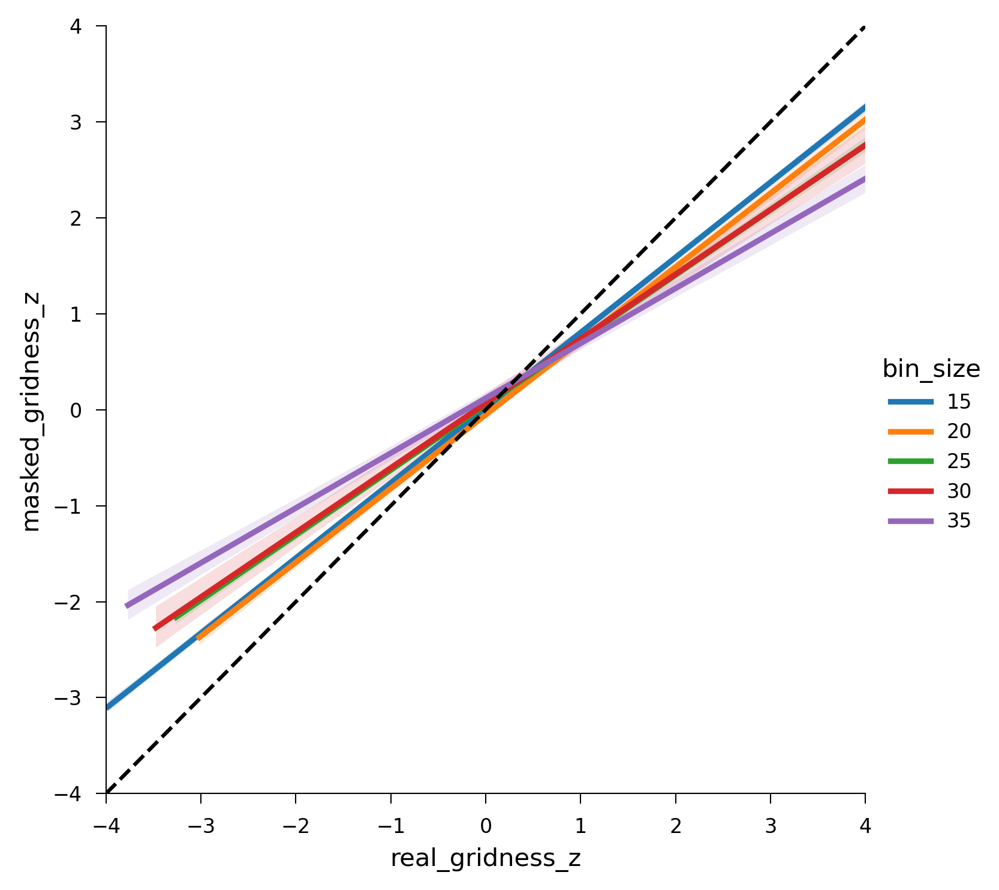

In [ ]:
# Figure S5C: 

sns.lmplot(data = rat_df, x='real_gridness_z', y='masked_gridness_z', hue='bin_size', scatter=False)
plt.ylim([-4, 4])
plt.xlim([-4, 4])
plt.plot([-4, 4], [-4, 4], 'k--')

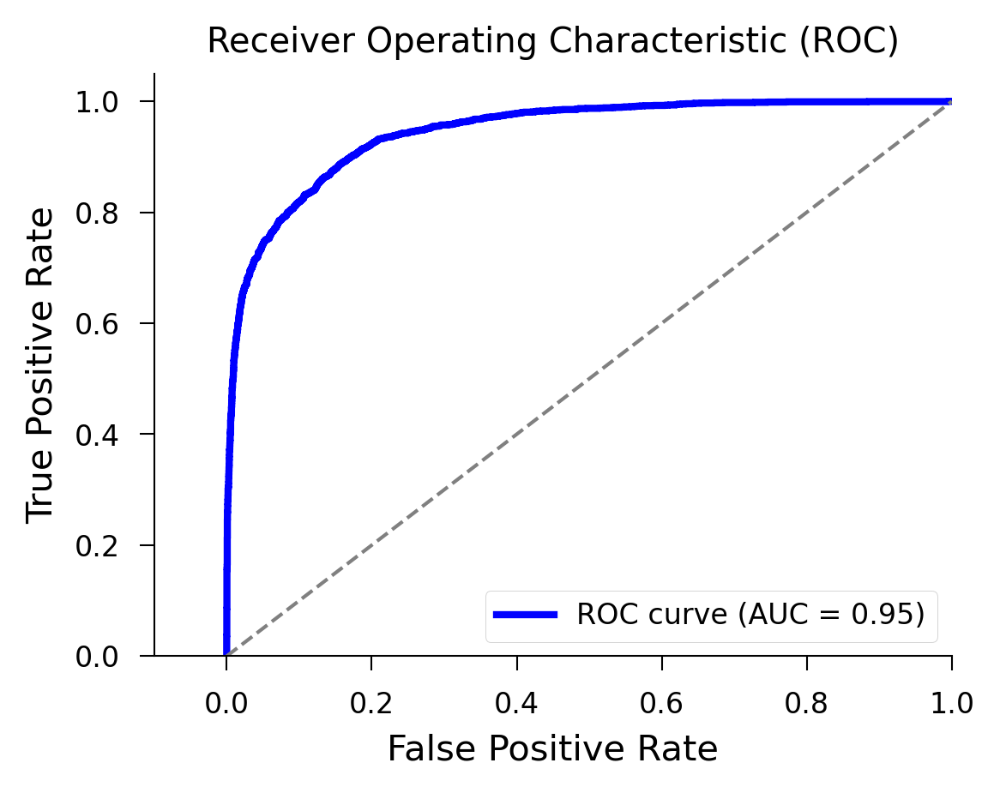

In [ ]:
# Figure S5D:
# Get the grid cell significance predictions for bin_size=15

rat_df = rat_df[rat_df.bin_size==15]

y_true = rat_df['true_gridness']
y_pred = 1-rat_df['masked_grid_p']

# Compute ROC curve
fpr, tpr, thresholds = roc_curve(y_true, y_pred)

# Compute AUC
roc_auc = auc(fpr, tpr)

# Plot ROC curve
plt.figure()
plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', lw=1, linestyle='--')  # diagonal line
plt.xlim([-0.1, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic (ROC)')
plt.legend(loc="lower right")
plt.show()

### Replication attempt: 

In [62]:
preprint_results = pd.read_csv(f'{datapath}/biorxiv_results_public.csv')
preprint_replication = pd.read_csv(f'{datapath}/condensed_df_biorxiv_params_public.csv')


In [64]:
df1 = preprint_replication.copy().sort_values(by='subj_id').reset_index(drop=True)
df2 = preprint_results.copy().reset_index(drop=True)


# Column names
encoding_col = 'trial_fr_encoding'
subject_col = 'subj_id'
region_col = 'region'

# Prepare the final matched dataframe
matched_df1_list = []
matched_df2_list = []

# Iterate over unique (subject, region) pairs
for (subj, region), df2_subj_region in df2.groupby([subject_col, region_col]):
    # Get corresponding rows from df1
    df1_subj_region = df1[(df1[subject_col] == subj) & (df1[region_col] == region)]
    # Ensure there are matches in df1
    if df1_subj_region.empty or df2_subj_region.empty:
        continue  # Skip if no match
    # Convert to NumPy arrays
    X = df1_subj_region[encoding_col].values[:, np.newaxis]  # Shape (N1, 1)
    Y = df2_subj_region[encoding_col].values[np.newaxis, :]  # Shape (1, N2)
    # Compute pairwise absolute differences
    cost_matrix = np.abs(X - Y)  # Shape (N1, N2)
    # Solve the assignment problem
    row_ind, col_ind = linear_sum_assignment(cost_matrix)
    # Extract the matched subset
    matched_df2 = df2_subj_region.iloc[col_ind].copy()
    matched_df2_list.append(matched_df2)
    matched_df1 = df1_subj_region
    matched_df1_list.append(matched_df1)
    

# Combine matched subsets
matched_df2_final = pd.concat(matched_df2_list).reset_index(drop=True)
matched_df1_final = pd.concat(matched_df1_list).reset_index(drop=True)

# Verify the match
correlation = matched_df1_final[encoding_col].corr(matched_df2_final[encoding_col])
print(f"Correlation after matching: {correlation:.4f}")

matched_df2_final['computed_p'] = (1 - scipy.stats.norm.cdf(matched_df2_final.zG_label_shift_x_15_1))

matched_df1_final['computed_p'] = (1 - scipy.stats.norm.cdf(matched_df1_final.zGs_label))

matched_df2_final['nspikes_total'] = matched_df1_final.nspikes_total

firing_rate_mask2 = matched_df2_final.nspikes_total >= 0
grid_cell_mask2 = (matched_df2_final.computed_p<=0.05) & (firing_rate_mask2)

firing_rate_mask1 = matched_df1_final.nspikes_total >= 0
grid_cell_mask1 = (matched_df1_final.computed_p<=0.05) & (firing_rate_mask1)

matched_df2_final['grid_cell'] = grid_cell_mask2
matched_df1_final['grid_cell'] = grid_cell_mask1

Correlation after matching: 1.0000


[Text(0.5, 0, 'original GS (z)'),
 Text(0, 0.5, 'error-corrected GS (z)'),
 Text(0.5, 1.0, 'all cells, original dataset (n=461)')]

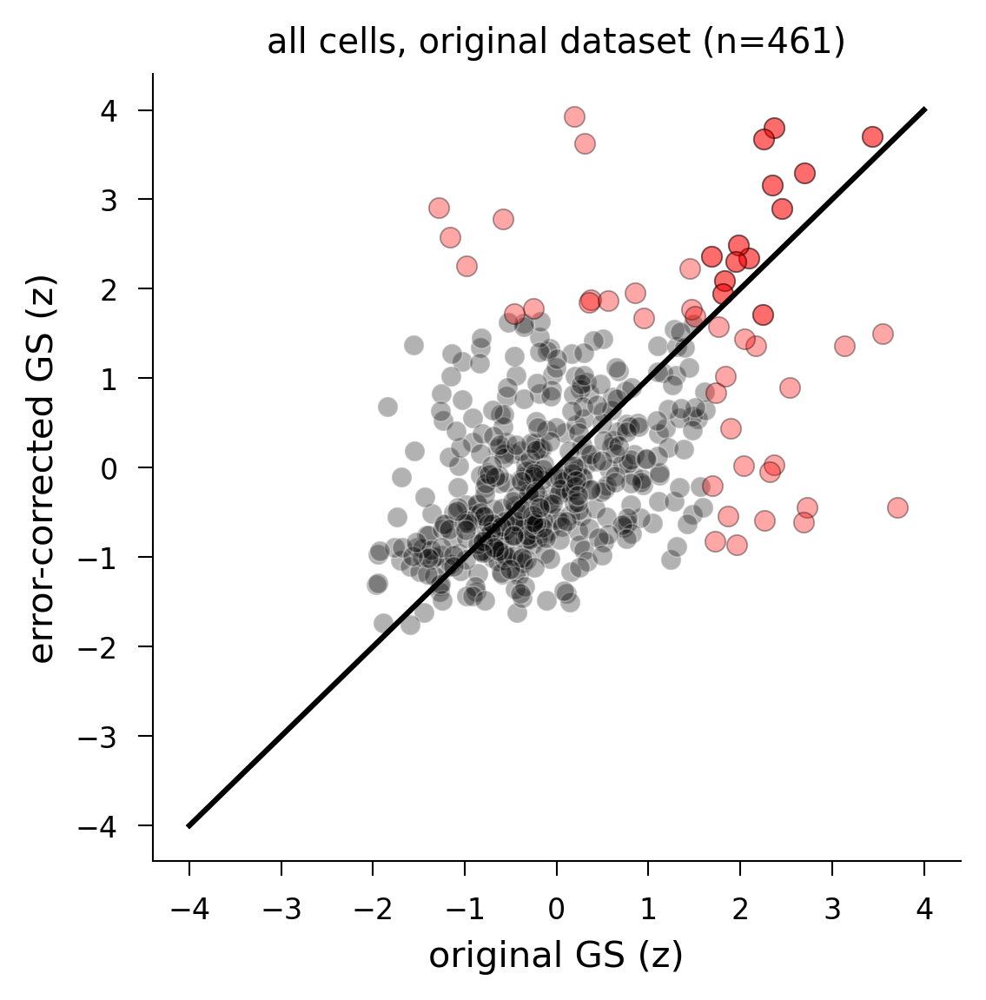

In [ ]:
# Figure S7A:

f, ax = plt.subplots(1,1, figsize=[4, 4], dpi=300)

sns.scatterplot(y=matched_df1_final[(matched_df1_final.grid_cell==False) & (matched_df2_final.grid_cell==False)].zGs_label.values,
         x=matched_df2_final[(matched_df1_final.grid_cell==False) & (matched_df2_final.grid_cell==False)].zG_label_shift_x_15_1.values, color='black', alpha=0.3)


sns.scatterplot(y=matched_df1_final[(matched_df1_final.grid_cell==True)].zGs_label.values,
         x=matched_df2_final[(matched_df1_final.grid_cell==True)].zG_label_shift_x_15_1.values, color='red', alpha=0.35, edgecolor='black')

sns.scatterplot(y=matched_df1_final[(matched_df2_final.grid_cell==True)].zGs_label.values,
         x=matched_df2_final[(matched_df2_final.grid_cell==True)].zG_label_shift_x_15_1.values, color='red', alpha=0.35, edgecolor='black')

plt.plot([-4, 4], [-4, 4], color='black')

sns.despine()
ax.set(xlabel='original GS (z)', ylabel='error-corrected GS (z)', title='all cells, original dataset (n=461)')


[Text(0.5, 0, 'original GS (z)'),
 Text(0, 0.5, 'error-corrected GS (z)'),
 Text(0.5, 1.0, 'EC cells, original dataset (n=131)')]

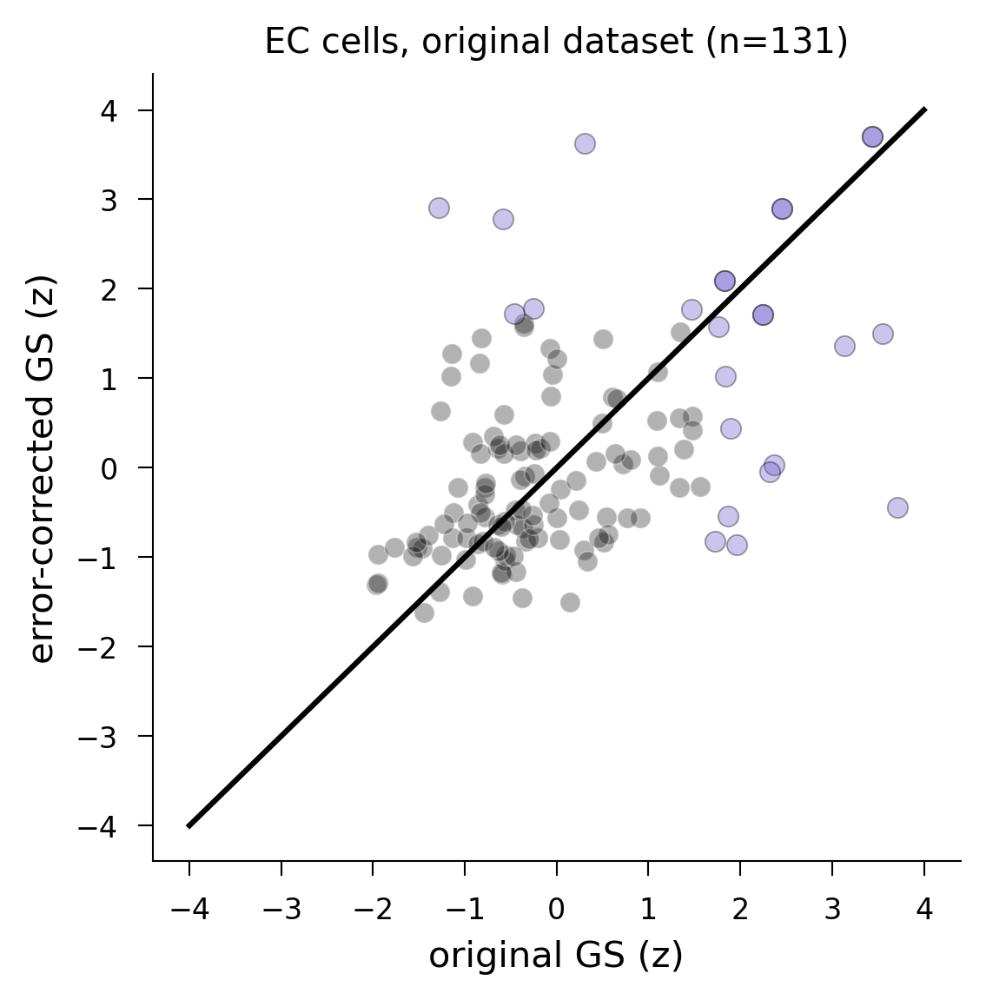

In [ ]:
# Figure S7B: 

f, ax = plt.subplots(1,1, figsize=[4, 4], dpi=300)

sns.scatterplot(y=matched_df1_final[(matched_df1_final.region=='EC') & (matched_df1_final.grid_cell==False) & (matched_df2_final.grid_cell==False) & (firing_rate_mask1==True)].zGs_label.values,
         x=matched_df2_final[(matched_df1_final.region=='EC') &(matched_df1_final.grid_cell==False) & (matched_df2_final.grid_cell==False) & (firing_rate_mask1==True)].zG_label_shift_x_15_1.values, color='black', alpha=0.3)


sns.scatterplot(y=matched_df1_final[(matched_df1_final.region=='EC') &(matched_df1_final.grid_cell==True)].zGs_label.values,
         x=matched_df2_final[(matched_df1_final.region=='EC') &(matched_df1_final.grid_cell==True)].zG_label_shift_x_15_1.values, color=colors_dict['EC'], alpha=0.35, edgecolor='black')

sns.scatterplot(y=matched_df1_final[(matched_df1_final.region=='EC') &(matched_df2_final.grid_cell==True)].zGs_label.values,
         x=matched_df2_final[(matched_df1_final.region=='EC') & (matched_df2_final.grid_cell==True)].zG_label_shift_x_15_1.values, color=colors_dict['EC'], alpha=0.35, edgecolor='black')

plt.plot([-4, 4], [-4, 4], color='black')

sns.despine()
ax.set(xlabel='original GS (z)', ylabel='error-corrected GS (z)', title=f'EC cells, original dataset (n={131})')


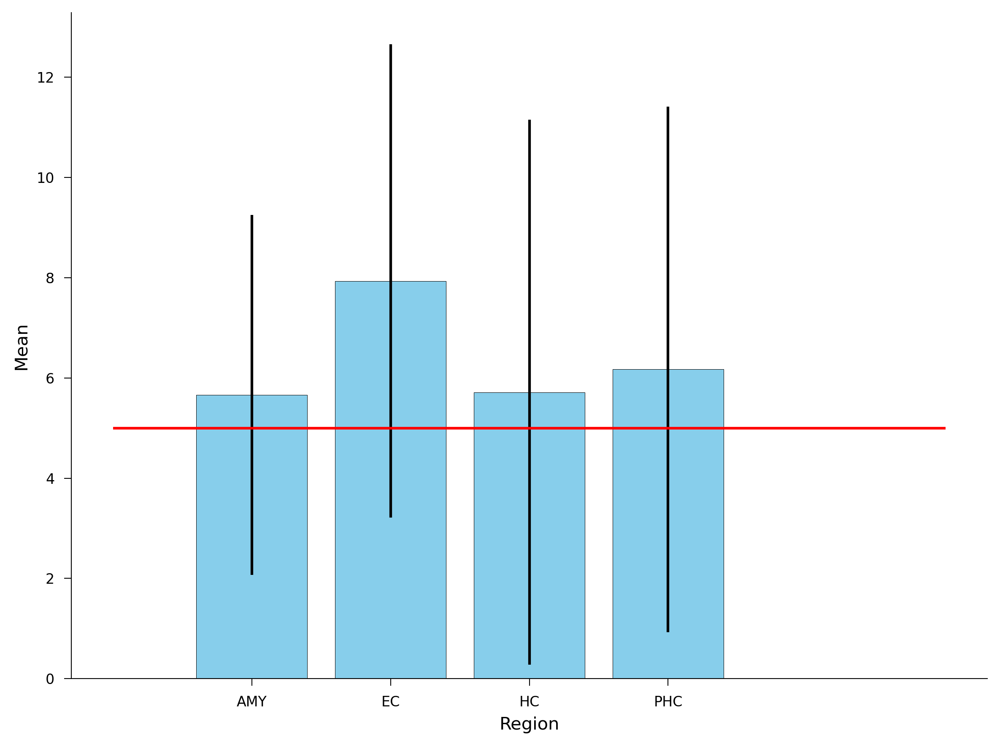

In [ ]:
# Figure S7C: 

significant_obs = matched_df1_final[(matched_df1_final.computed_p<=0.05) & (matched_df1_final.trial_fr_encoding>0.1)].region.value_counts()  # Number of significant observations
total_obs = matched_df1_final[(matched_df1_final.trial_fr_encoding>0.1)].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, alternative='greater')
    # lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()

In [68]:
preprint_replication['computed_p_label'] = (1 - scipy.stats.norm.cdf(preprint_replication.zGs_label))
firing_rate_mask = preprint_replication.trial_fr_encoding>=0.1
grid_cell_mask = (preprint_replication.computed_p_label<=0.05) & (firing_rate_mask)

preprint_replication['grid_cell'] = grid_cell_mask


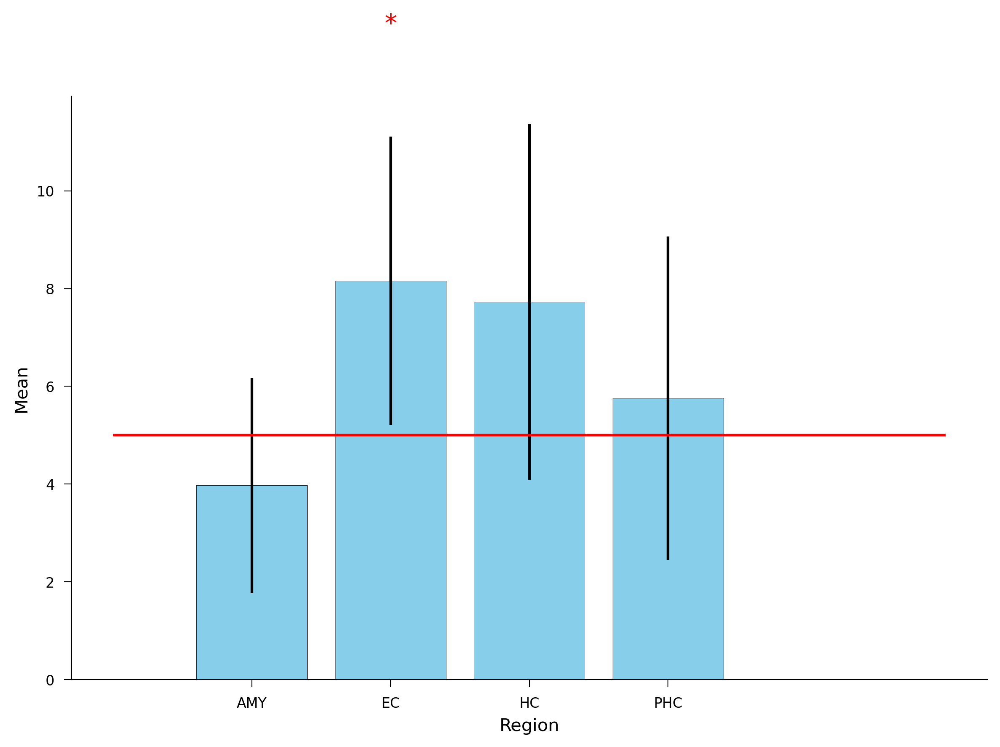

In [ ]:
# Figure S7D:

significant_obs = preprint_replication[grid_cell_mask].region.value_counts()  # Number of significant observations
total_obs = preprint_replication[firing_rate_mask].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, 'greater')
    
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()

### Surrogates: 

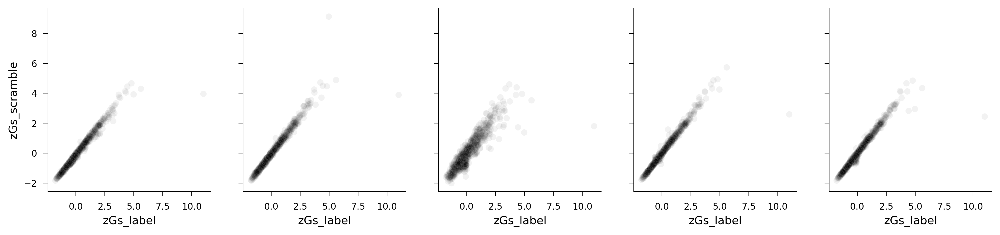

In [ ]:
# Figure S8:

f, ax =  plt.subplots(1, 5, figsize=(15,3), dpi=300, sharex=True, sharey=True) # initialize the figure 


sns.scatterplot(data=all_cell_res[all_cell_res.symmetry==6], ax=ax[0],
            x='zGs_label', y='zGs_scramble', alpha=0.05, color='k')


sns.scatterplot(data=all_cell_res[all_cell_res.symmetry==6], ax=ax[1],
            x='zGs_label', y='zGs_circular', alpha=0.05, color='k')

sns.scatterplot(data=all_cell_res[all_cell_res.symmetry==6], ax=ax[2],
            x='zGs_label', y='zGs_fft', alpha=0.05, color='k')

sns.scatterplot(data=all_cell_res[all_cell_res.symmetry==6], ax=ax[3],
            x='zGs_label', y='zGs_isi_shuffle', alpha=0.05, color='k')

sns.scatterplot(data=all_cell_res[all_cell_res.symmetry==6], ax=ax[4],
            x='zGs_label', y='zGs_poisson_sim', alpha=0.05, color='k')
sns.despine()


### Test on proportion of cells:

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:21: UserWarning: FixedFormatter should only be used together with FixedLocator


[[Text(0.0, 0, ''),
  Text(1.0, 0, '50'),
  Text(2.0, 0, '100'),
  Text(3.0, 0, '250'),
  Text(4.0, 0, '')],
 Text(0, 0.5, 'significant grid-like proportion'),
 Text(0.5, 0, 'minimum spike criteria')]

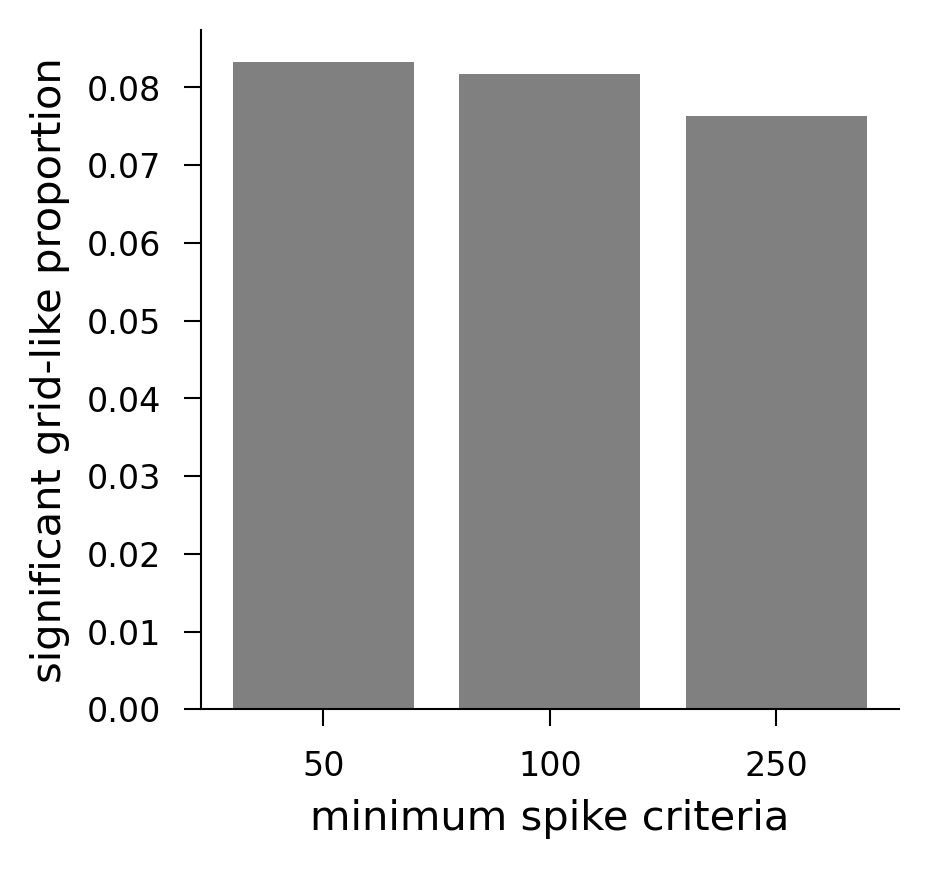

In [ ]:
# Figure S9A:
# Let's test the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
condensed_df['grid_cell'] = grid_cell_mask

low_criteria_df = condensed_df[(condensed_df.nspikes_total>=50)]
mid_criteria_df = condensed_df[(condensed_df.nspikes_total>=100)]
high_criteria_df = condensed_df[(condensed_df.nspikes_total>=250)]

data = np.array([[len(low_criteria_df.loc[(low_criteria_df.grid_cell==True)]),
           len(low_criteria_df)],
          [len(mid_criteria_df.loc[(mid_criteria_df.grid_cell==True)]),
           len(mid_criteria_df)],
          [len(high_criteria_df.loc[(high_criteria_df.grid_cell==True)]),
           len(high_criteria_df)]])

f, ax = plt.subplots(1,1, figsize=[3,3], dpi=300)

ax.bar([1, 2, 3], data[:,0] / data[:,1], color='gray')
ax.set(xticklabels=['', 50, 100, 250], 
       ylabel='significant grid-like proportion', 
       xlabel='minimum spike criteria')


In [ ]:
# Reset condensed_df:

condensed_df = pd.read_csv(f'{datapath}/condensed_df_public.csv')
all_cell_res = pd.read_csv(f'{datapath}/all_cell_res_public.csv')
all_trial_res = pd.read_csv(f'{datapath}/all_trial_res_public.csv')

# Get rid of temporal pole data
condensed_df = condensed_df[condensed_df.region!='TP']
all_cell_res = all_cell_res[all_cell_res.region!='TP']
all_trial_res = all_trial_res[all_trial_res.region!='TP']

# Let's get the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
firing_rate_mask = (condensed_df.nspikes_total>=100)

condensed_df['grid_cell'] = (grid_cell_mask) & (firing_rate_mask)


### Occupancy gridness:

Plot an example occupancy for one subject

In [72]:
all_encoding_df['spatial_arousal_bins'] = pd.cut(all_encoding_df['Arousal_mean'], bins=15)
all_encoding_df['spatial_valence_bins'] = pd.cut(all_encoding_df['Valence_mean'], bins=15)

<AxesSubplot:>

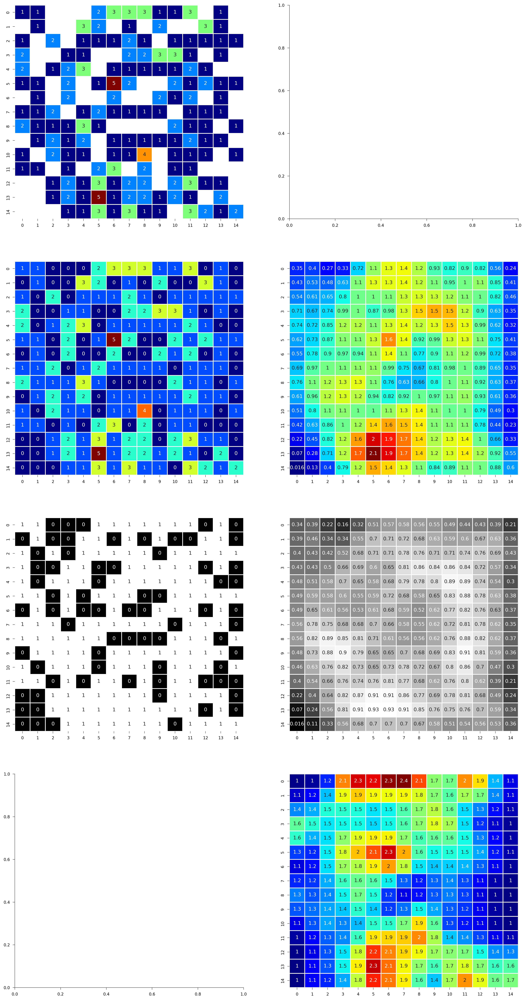

In [ ]:
# Figure S3:
# Make the schematic figure about smoothing
nbins = 15
original_map = np.random.rand(15,15).astype(float)

all_encoding_df['spatial_arousal_bins'] = pd.cut(all_encoding_df['Arousal_mean'], bins=nbins)
all_encoding_df['spatial_valence_bins'] = pd.cut(all_encoding_df['Valence_mean'], bins=nbins)

occ_mask = all_encoding_df[all_encoding_df.sess_id==4].pivot_table(index='spatial_valence_bins', 
                           columns='spatial_arousal_bins', 
                           values='sess_id', aggfunc='count').values

occ_mask = occ_mask.astype('float')
occ_mask[occ_mask==0] = np.nan

# Is the occupancy alone grid-like?
V=occ_mask.copy()
V[np.isnan(occ_mask)]=0
VV=gaussian_filter(V, sigma=1, mode='constant', truncate=2)

W=0*occ_mask.copy()+1
W[np.isnan(occ_mask)]=0
WW=gaussian_filter(W, sigma=1, mode='constant', truncate=2)
smoothRateMap=VV/WW


f, ax = plt.subplots(4,2, dpi=300, figsize=[18,36]) # initialize the figure 
sns.heatmap(data=occ_mask, cmap='jet', cbar=None, annot=True, ax=ax[0, 0], edgecolors='black', linewidths=1)

sns.heatmap(data=V, cmap='jet', cbar=None, annot=True, ax=ax[1, 0], edgecolors='black', linewidths=1)
sns.heatmap(data=VV, cmap='jet', cbar=None, annot=True, ax=ax[1, 1], edgecolors='black', linewidths=1)

sns.heatmap(data=W, cmap='gray', cbar=None, annot=True, ax=ax[2, 0], edgecolors='black', linewidths=1)
sns.heatmap(data=WW, cmap='gray', cbar=None, annot=True, ax=ax[2, 1], edgecolors='black', linewidths=1)

sns.heatmap(data=smoothRateMap, cmap='jet', cbar=None, annot=True, ax=ax[3, 1], edgecolors='black', linewidths=1)



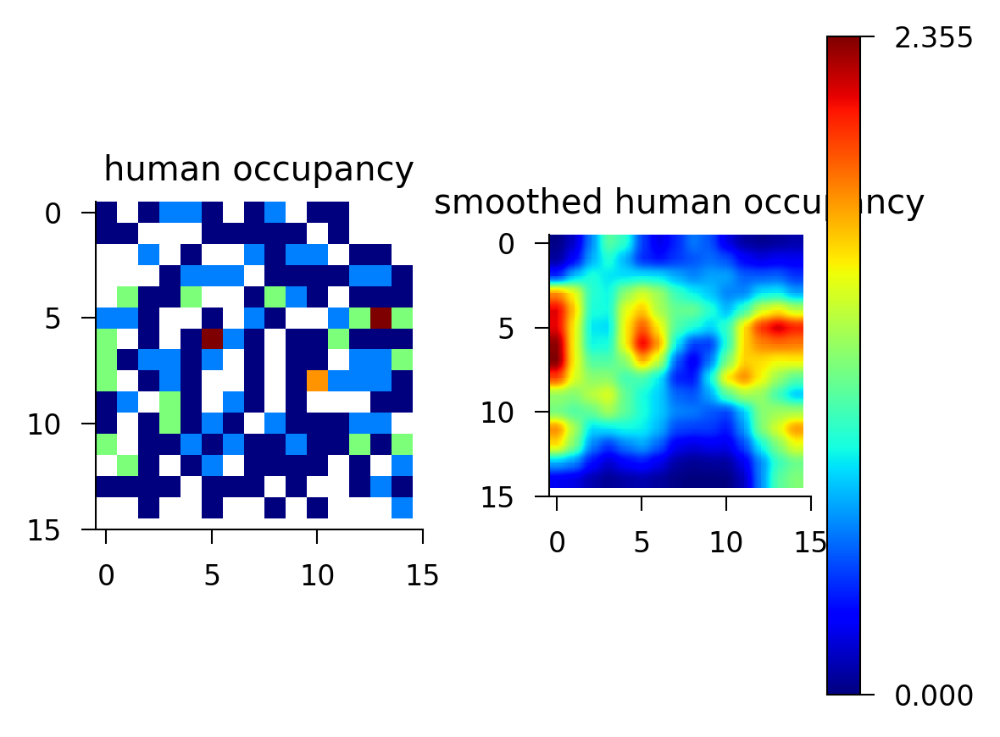

In [ ]:
# Figure S10A: 

all_encoding_df['spatial_arousal_bins'] = pd.cut(all_encoding_df['Arousal_mean'], bins=nbins)
all_encoding_df['spatial_valence_bins'] = pd.cut(all_encoding_df['Valence_mean'], bins=nbins)

occ_mask = all_encoding_df[all_encoding_df.sess_id==4].pivot_table(index='spatial_valence_bins', 
                           columns='spatial_arousal_bins', 
                           values='sess_id', aggfunc='count').values
occ_mask = occ_mask.astype('float')
occ_mask[occ_mask==0] = np.nan

# Is the occupancy alone grid-like?
V=occ_mask.copy()
V[np.isnan(occ_mask)]=0
VV=gaussian_filter(V, sigma=1, mode='constant')

W=0*occ_mask.copy()+1
W[np.isnan(occ_mask)]=0
WW=gaussian_filter(W, sigma=1, mode='constant')
smoothRateMap=VV/WW


f, (ax1, ax2) = plt.subplots(1, 2, dpi=300) # initialize the figure 

ax1.imshow(occ_mask.T,  cmap='jet')
ax1.set(title='human occupancy', xticks = [0, 5, 10, 15] , yticks = [0, 5, 10, 15])
# f.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=np.nanmax(occ_mask)), 
#                                          cmap='jet'),  ticks=[0, np.nanmax(occ_mask)])

ax2.imshow(smoothRateMap.T,  cmap='jet', interpolation='hamming')
ax2.set(title='smoothed human occupancy', xticks = [0, 5, 10, 15] , yticks = [0, 5, 10, 15])
f.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(vmin=0, vmax=np.nanmax(smoothRateMap)), 
                                         cmap='jet'),  ticks=[0, np.nanmax(smoothRateMap)])
f.tight_layout()


In [ ]:
# plot correlation between occupancy gridness and grid score:

occupancy_df = pd.read_csv(f'{datapath}/occupancy_df_public.csv')

merged_occ_grid_df = condensed_df[(condensed_df.nspikes_total>100)].merge(occupancy_df, on=['subj_id', 'sess_id', 'symmetry'])



<AxesSubplot:xlabel='occupancy_grid_score', ylabel='zGs_label'>

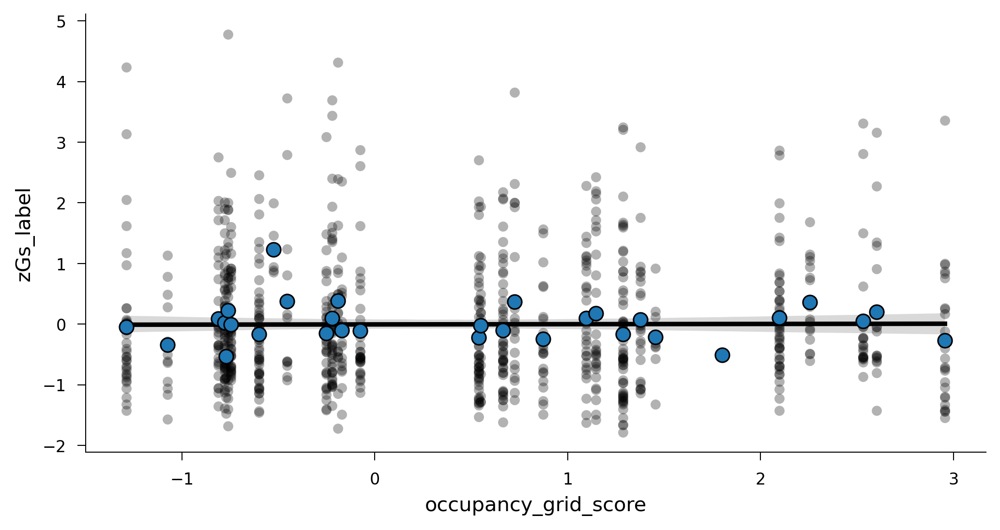

In [ ]:
# Figure S10B: 

f,ax = plt.subplots(1, 1, dpi=300, figsize=(8,4))

sns.regplot(data=merged_occ_grid_df, 
            x='occupancy_grid_score', y='zGs_label', scatter_kws={'alpha':0.3, 's':25}, color='k')
sns.lineplot(data=merged_occ_grid_df.groupby('sess_id').mean(numeric_only=True), 
            x='occupancy_grid_score', y='zGs_label', marker='o', markeredgecolor='k',
             linestyle='', markersize=7)

### Other spatial patterns:

In [ ]:
# Figure S6B:
# Plot all place cells 

# Set up parameters
nbins = 15
nrows, ncols = 3, 17
total_cells = nrows * ncols
spiking_metric = 'evoked_fr'
timeframe = 'early_trunc'

# Limit to desired number of cells
cells_to_plot = condensed_df[(condensed_df.computed_p_label>0.05) & (condensed_df.pSI_label<=0.05)].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res[
        (all_trial_res.sess_id == cell.sess_id) &
        (all_trial_res.region == cell.region) &
        (all_trial_res.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['valence'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['valence_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
        {f'{spiking_metric}_{timeframe}': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('arousal_binned', 'valence_binned', f'{spiking_metric}_{timeframe}').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, SI={cell.SI:.2f}, z={cell.zSI_label:.2f}', fontsize=8)

    # for field in fields:
    #     heatmap_plt.scatter(*zip(*field), s=5)
    # for peak in peaks:
    #     heatmap_plt.scatter(peak[0], peak[1], color='white', s=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()


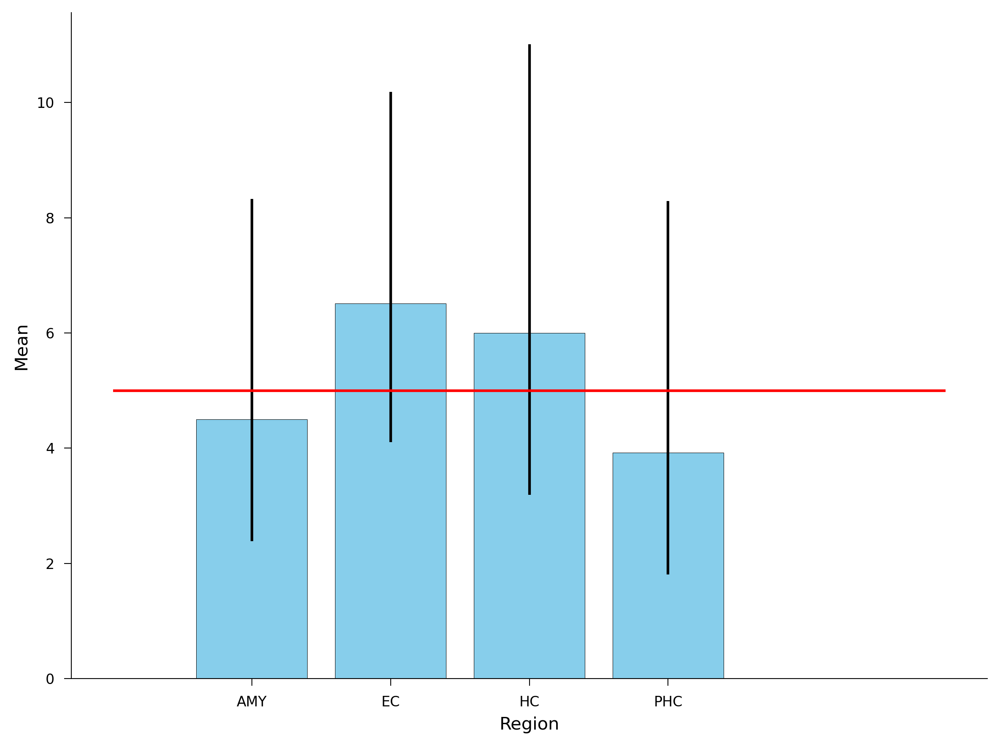

In [ ]:
# Figure S6A:
# place cell 

significant_obs = condensed_df[(condensed_df.computed_p_label>0.05) & (condensed_df.pSI_label<=0.05) & (condensed_df.nspikes_total>=100)].region.value_counts()  # Number of significant observations
total_obs = condensed_df[(condensed_df.computed_p_label>0.05) & (condensed_df.nspikes_total>=100)].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05)
    lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()


/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3593: RuntimeWarning: invalid value encountered in true_divide
  fr_map_smoothed=VV/WW


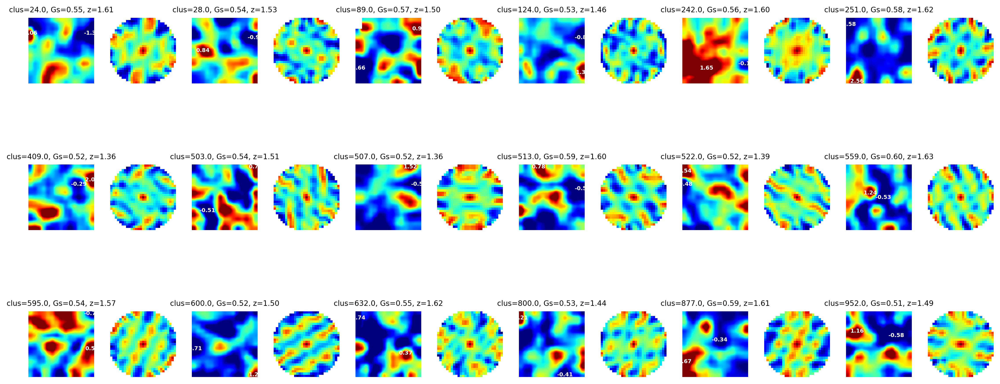

In [ ]:
# Figure S11A:
# nongrid-cells high autocorrelation

# Set up parameters
nbins = 15
nrows, ncols = 3, 6
total_cells = nrows * ncols

# Limit to desired number of cells
cells_to_plot = condensed_df[(condensed_df.computed_p_label>0.05) & (condensed_df.Gs>0.5)].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res[
        (all_trial_res.sess_id == cell.sess_id) &
        (all_trial_res.region == cell.region) &
        (all_trial_res.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['valence'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['valence_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
        {f'{spiking_metric}_{timeframe}': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('arousal_binned', 'valence_binned', f'{spiking_metric}_{timeframe}').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()


/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3676: RuntimeWarning: invalid value encountered in power
  (np.divide(np.square(sum_fr_map_smoothed), n_bins_sq))), 0.5)
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3680: RuntimeWarning: invalid value encountered in power
  (np.divide(np.square(sum_fr_map_smoothed_2), n_bins_sq))), 0.5)
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3684: RuntimeWarning: divide by zero encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: overflow encountered in subtract
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarning: overflow encountered in double_scalars
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:52: RuntimeWarn

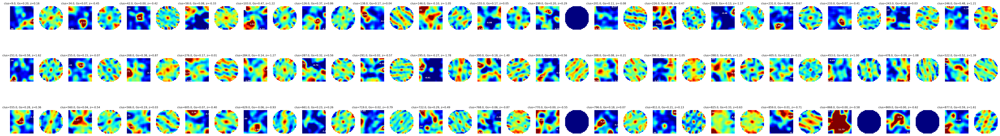

In [ ]:
# Figure S11B::

# nongrid-cells high stability 

# Set up parameters
nbins = 15
nrows, ncols = 3, 17
total_cells = nrows * ncols

# Limit to desired number of cells
cells_to_plot = condensed_df[(condensed_df.computed_p_label>0.05) & (condensed_df.pStability_label<0.05)].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res[
        (all_trial_res.sess_id == cell.sess_id) &
        (all_trial_res.region == cell.region) &
        (all_trial_res.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['valence'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['valence_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
        {f'{spiking_metric}_{timeframe}': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('arousal_binned', 'valence_binned', f'{spiking_metric}_{timeframe}').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()


### Other tunings:


In [78]:
all_res_df = pd.read_csv(f'{datapath}/all_cells_regress_public.csv')
all_res_df = all_res_df[all_res_df.region!='TP']

# restrict to early window
all_res_df = all_res_df[(all_res_df.encoding_window=='early')]
# get rid of Intercept
all_res_df= all_res_df[all_res_df.predictor!='Intercept']


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.052739886710765474 0.19016084502985697


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.02565188263937178 0.6014516486287663


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.09445900117871267 0.05076368817296109


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.08263380162347482 0.10581209309946996


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


0.02896337179428513 0.5864750995936284


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.013059610737683414 0.807388304811816


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


0.01931331597494342 0.717133358840836


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.034802596282642775 0.5245862466419793


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


0.017471396946548097 0.7592650508476918


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


0.020521822168229335 0.6970990468045677


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.028110867564502623 0.49064949193228957


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.0515193266785007 0.20501647582182791


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.08777081329978391 0.06414813222345547


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.04909859201284654 0.37282649172842497


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.04937991444833661 0.3874867101888425


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/statsmodels/regression/mixed_linear_model.py:2237: ConvergenceWarning: The MLE may be on the boundary of the parameter space.
  warnings.warn(msg, ConvergenceWarning)


-0.023790529980447048 0.6277095335698188


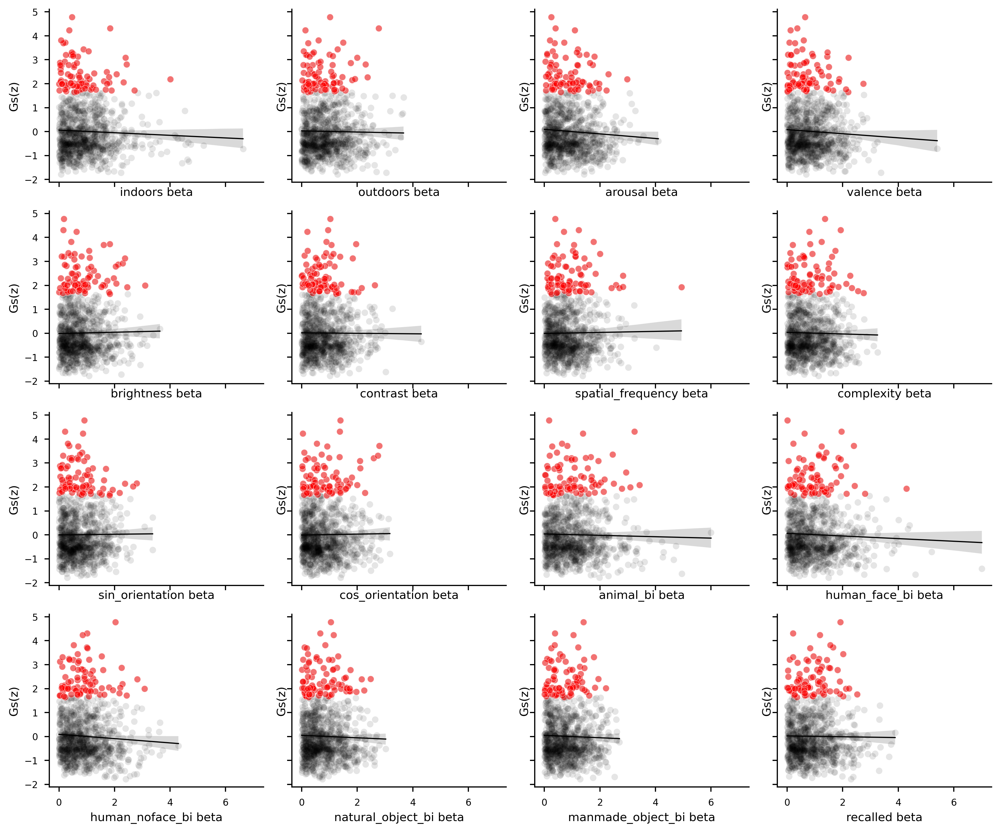

In [ ]:
# Figure S12A:

f,ax = plt.subplots(4,4, dpi=300, figsize=(12,10), sharex=True, sharey=True)
col_ix = 0
for ix, predictor in enumerate(all_res_df.predictor.unique()):
    row_ix = ix //4
    predictor_df = all_res_df[all_res_df.predictor==predictor]
    predictor_df['z_beta'] = np.abs(predictor_df['z_beta'])
    plot_df = predictor_df.merge(condensed_df, on=['sess_id','region','cluster'])
    
    sns.regplot(data=plot_df, x='z_beta', y='zGs_label', ax=ax[row_ix, col_ix], scatter_kws={'alpha':0.1}, color='k', line_kws={'linewidth':1})
    sns.scatterplot(data=plot_df[plot_df.computed_p_label<=0.05], x='z_beta', y='zGs_label', ax=ax[row_ix, col_ix], color='red', alpha = 0.5)
    if predictor == 'C(environment_bi, Treatment(0))[T.-1]':
        predictor = 'indoors'
    elif predictor == 'C(environment_bi, Treatment(0))[T.1]':
        predictor = 'outdoors'
    ax[row_ix, col_ix].set(xlabel=f'{predictor} beta', ylabel='Gs(z)')
    for _, s in ax[row_ix, col_ix].spines.items():
        s.set_linewidth(1)
    # increase tick width
    ax[row_ix, col_ix].tick_params(width=1)
        
    # t, p = pearsonr(plot_df.z_beta, plot_df.zGs_label)
    model = smf.mixedlm(formula='zGs_label ~ 1 + z_beta', data=plot_df, groups='sess_id').fit(reml=False)
    b = model.params['z_beta']
    p = model.pvalues['z_beta']
                    
    sns.despine()
    print(b, p)
    col_ix += 1
    if col_ix > 3: 
        col_ix = 0
f.tight_layout()



In [111]:
min_idx = all_res_df.groupby('cluster')['z_p'].idxmin()
strongest_predictor_df = all_res_df.loc[min_idx].reset_index(drop=True)
strongest_predictor_df['z_beta'] = np.abs(strongest_predictor_df['z_beta'])

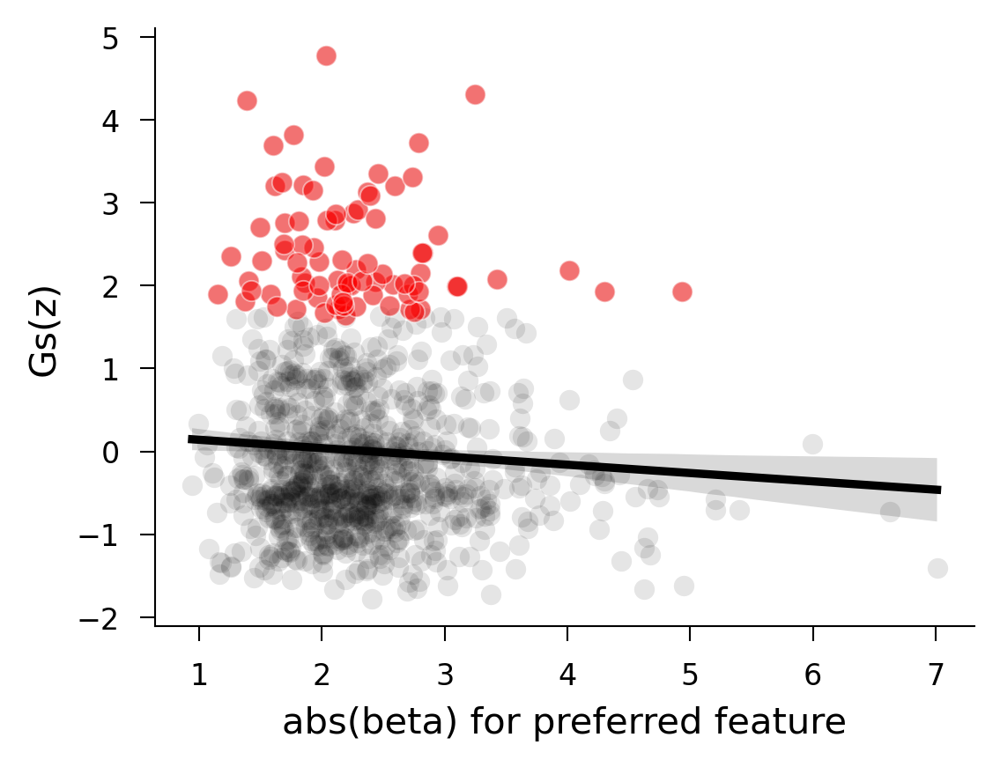

In [ ]:
# Figure S12B:

f,ax = plt.subplots(1, 1, dpi=300, figsize=(4,3))
plot_df = strongest_predictor_df.merge(condensed_df, on=['sess_id','region','cluster'])
sns.regplot(data=plot_df, x='z_beta', y='zGs_label', ax=ax, scatter_kws={'alpha':0.1}, color='k')
sns.scatterplot(data=plot_df[plot_df.computed_p_label<=0.05], x='z_beta', y='zGs_label', ax=ax, color='red', alpha = 0.5)
if predictor == 'C(environment_bi, Treatment(0))[T.-1]':
    predictor = 'indoors'
elif predictor == 'C(environment_bi, Treatment(0))[T.1]':
    predictor = 'outdoors'
ax.set(xlabel=f'abs(beta) for preferred feature', ylabel='Gs(z)')
t, p = pearsonr(plot_df.z_beta, plot_df.zGs_label)
sns.despine()

### Other symmetries:

In [ ]:
# Figure S13A-B:
# 4-fold and 8-fold symmetry

f, ax = plt.subplots(1,2, figsize=(15,5), dpi=300)

sns.boxplot(data=all_cell_res[all_cell_res.cluster.isin(fourfold_grid_clusters)], 
            x='symmetry', y='zGs_label', showcaps=False,boxprops={'facecolor':'None'}, showfliers=False, whiskerprops={'linewidth':0}, ax=ax[0])
sns.stripplot(data=all_cell_res[all_cell_res.cluster.isin(fourfold_grid_clusters)], 
              x='symmetry', y='zGs_label', alpha=0.2, ax=ax[0], color='black')    

ax[0].set(ylabel='Gs(z)')
sns.despine()

sns.boxplot(data=all_cell_res[all_cell_res.cluster.isin(eightfold_grid_clusters)], 
            x='symmetry', y='zGs_label', showcaps=False,boxprops={'facecolor':'None'}, showfliers=False, whiskerprops={'linewidth':0}, ax=ax[1])
sns.stripplot(data=all_cell_res[all_cell_res.cluster.isin(eightfold_grid_clusters)], 
              x='symmetry', y='zGs_label', alpha=0.2, ax=ax[1], color='black')    

ax[1].set(ylabel='Gs(z)')
sns.despine()


In [ ]:
# Figure S13C:
# Compute the statistics 

sixmodel = smf.mixedlm(formula="zGs_label ~ 1 + C(symmetry, Treatment(6))", 
                data=all_cell_res[all_cell_res.cluster.isin(sixfold_grid_clusters)],
           groups='subj_id').fit()
sixmodel.summary()

sixbeta = sixmodel.params['C(symmetry, Treatment(6))[T.5.0]']
sixSE = sixmodel.bse['C(symmetry, Treatment(6))[T.5.0]']

fourmodel = smf.mixedlm(formula="zGs_label ~ 1 + C(symmetry, Treatment(4))", 
                data=all_cell_res[all_cell_res.cluster.isin(fourfold_grid_clusters)],
           groups='subj_id').fit()
fourmodel.summary()

fourbeta = fourmodel.params['C(symmetry, Treatment(4))[T.5.0]']
fourSE = fourmodel.bse['C(symmetry, Treatment(4))[T.5.0]']

eightmodel = smf.mixedlm(formula="zGs_label ~ 1 + C(symmetry, Treatment(8))", 
                data=all_cell_res[all_cell_res.cluster.isin(eightfold_grid_clusters)],
           groups='subj_id').fit()

eightbeta = eightmodel.params['C(symmetry, Treatment(8))[T.7.0]']
eightSE = eightmodel.bse['C(symmetry, Treatment(8))[T.7.0]']

eightmodel = smf.mixedlm(formula="zGs_label ~ 1 + C(symmetry, Treatment(8))", 
                data=all_cell_res[all_cell_res.cluster.isin(eightfold_grid_clusters)],
           groups='subj_id').fit()

eightbeta = eightmodel.params['C(symmetry, Treatment(8))[T.7.0]']
eightSE = eightmodel.bse['C(symmetry, Treatment(8))[T.7.0]']

# Collect into lists
betas = [-sixbeta, -fourbeta, -eightbeta]
errors = [-sixSE, -fourSE, -eightSE]
labels = ["six", "four", "eight"]

# Plot
plt.figure(figsize=(6,4))
plt.bar(labels, betas, yerr=errors, capsize=5, color="skyblue", edgecolor="black")

plt.ylabel("Beta")
plt.title("Betas with Standard Errors")

# Grid-like neurons are localized to the entorhinal cortex.

In [109]:
# Load the main analysis 
condensed_df = pd.read_csv(f'{datapath}/condensed_df_public.csv')
all_cell_res = pd.read_csv(f'{datapath}/all_cell_res_public.csv')
all_trial_res = pd.read_csv(f'{datapath}/all_trial_res_public.csv')

# Get rid of temporal pole data
condensed_df = condensed_df[condensed_df.region!='TP']
all_cell_res = all_cell_res[all_cell_res.region!='TP']
all_trial_res = all_trial_res[all_trial_res.region!='TP']

# Let's get the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
firing_rate_mask = (condensed_df.nspikes_total>=120)

condensed_df['grid_cell'] = (grid_cell_mask) & (firing_rate_mask)


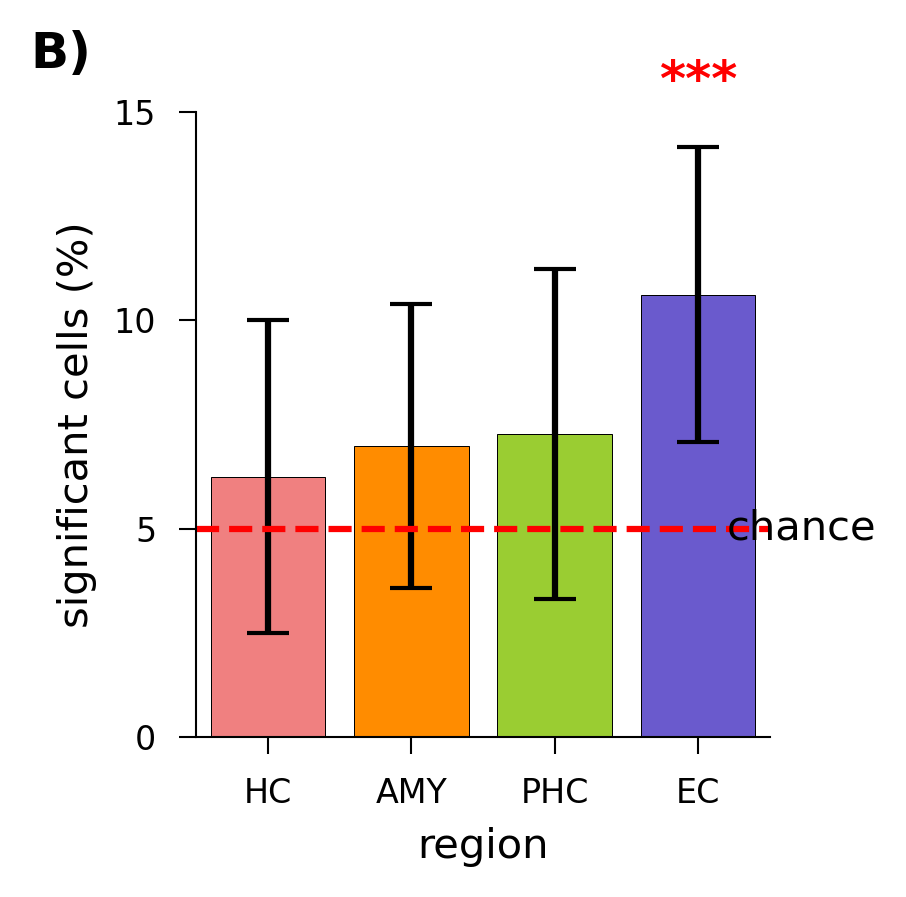

In [129]:
# Figure 4B:
# Let's test the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
firing_rate_mask = (condensed_df.nspikes_total>=100)

condensed_df['grid_cell'] = (grid_cell_mask) & (firing_rate_mask)

significant_obs = condensed_df[(grid_cell_mask) & (firing_rate_mask)].region.value_counts()  # Number of significant observations
total_obs = condensed_df[firing_rate_mask].region.value_counts()

percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, alternative='greater')
    # lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')

    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                                               total_obs[region], alpha=0.05, method="normal")
    
    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Reorder dataframe to match x-axis order: AMY, HC, PHC, EC
region_order = ['HC', 'AMY', 'PHC', 'EC']
percent_df_ordered = percent_df.set_index('region').reindex(region_order).reset_index()

# Create the bar plot
f, ax = plt.subplots(1, 1, figsize=[3,3], dpi=300) # initialize the figure 

# Get colors in order using the predefined colors_dict
bar_colors = [colors_dict.get(region, 'skyblue') for region in percent_df_ordered['region']]

bars = ax.bar(percent_df_ordered['region'], percent_df_ordered['mean'], 
               yerr=[percent_df_ordered['mean'] - percent_df_ordered['lci'], 
                     percent_df_ordered['hci'] - percent_df_ordered['mean']],
               capsize=5, color=bar_colors, edgecolor='black', error_kw={'color': 'black', 'capthick': 1})

# Add asterisks for significant p-values at top of error bars
for i, bar in enumerate(bars):
    pval = percent_df_ordered.iloc[i]['p-value']
    hci = percent_df_ordered.iloc[i]['hci']
    if pval <= 0.05:
        # Position asterisk at top of error bar (hci)
        y_pos = hci + 1
        ax.text(bar.get_x() + bar.get_width() / 2, y_pos, '***', 
                 ha='center', va='bottom', fontsize=12, color='red', fontweight='bold')

# Set x-axis limits to accommodate labels
ax.set_xlim([-0.5, 3.5])

# Add horizontal chance line (red dashed)
ax.axhline(y=5, color='red', linestyle='--', linewidth=1.5, xmin=0, xmax=1)
ax.text(3.2, 5, 'chance', ha='left', va='center', color='black', fontsize=10)

# Label the axes
ax.set_xlabel('region')
ax.set_ylabel('significant cells (%)')
ax.set_ylim([0, 15])
ax.set_yticks([0, 5, 10, 15])

# Add "B)" label in top-left corner
f.text(0.02, 0.98, 'B)', fontsize=12, fontweight='bold', va='top', ha='left', transform=f.transFigure)

sns.despine()
# Show the plot
plt.tight_layout()
plt.savefig('/Users/salmanqasim/Documents/Projects/LukasProj/Plots/regions_label_shuffle.pdf', dpi=300)




## Test on proportion of cells (EC):

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:22: UserWarning: FixedFormatter should only be used together with FixedLocator


[[Text(0.0, 0, ''),
  Text(1.0, 0, '50'),
  Text(2.0, 0, '100'),
  Text(3.0, 0, '250'),
  Text(4.0, 0, '')],
 Text(0, 0.5, 'significant grid-like proportion'),
 Text(0.5, 0, 'minimum spike criteria')]

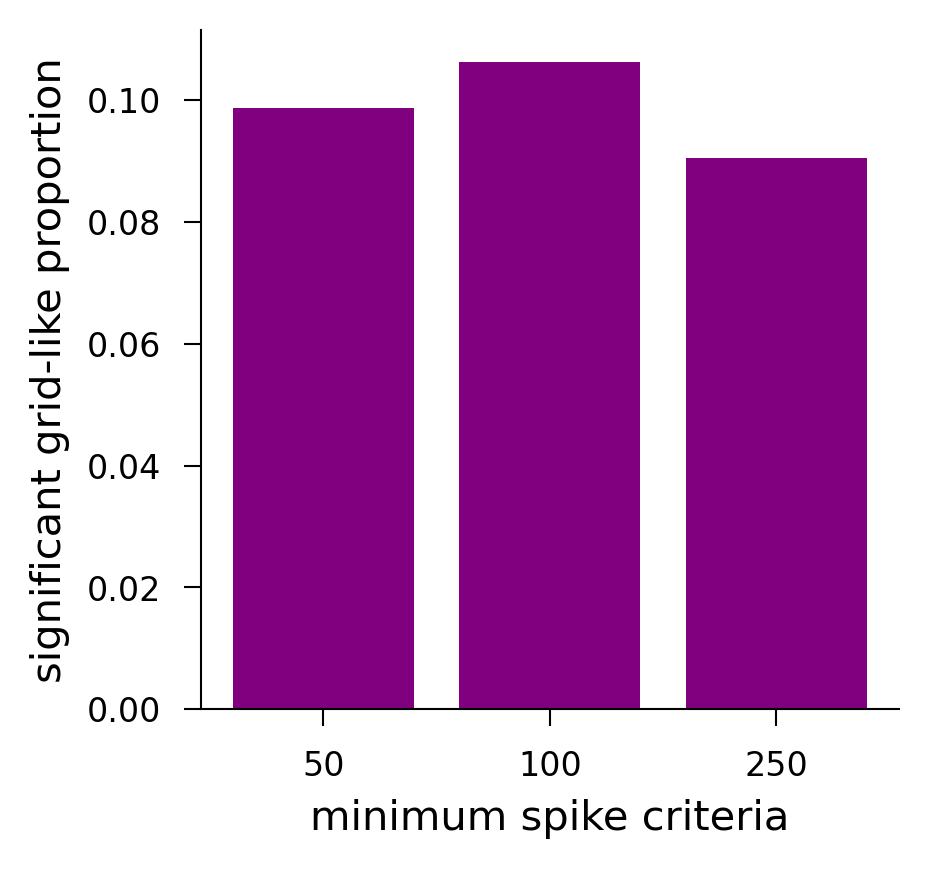

In [ ]:
# Figure S9B:
# Let's test the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
condensed_df['grid_cell'] = grid_cell_mask

low_criteria_df = condensed_df[(condensed_df.nspikes_total>=50) & (condensed_df.region=='EC')]
mid_criteria_df = condensed_df[(condensed_df.nspikes_total>=100) & (condensed_df.region=='EC')]
high_criteria_df = condensed_df[(condensed_df.nspikes_total>=250) & (condensed_df.region=='EC')]

data = np.array([[len(low_criteria_df.loc[(low_criteria_df.grid_cell==True)]),
           len(low_criteria_df)],
          [len(mid_criteria_df.loc[(mid_criteria_df.grid_cell==True)]),
           len(mid_criteria_df)],
          [len(high_criteria_df.loc[(high_criteria_df.grid_cell==True)]),
           len(high_criteria_df)]])


f, ax = plt.subplots(1,1, figsize=[3,3], dpi=300)

ax.bar([1, 2, 3], data[:,0] / data[:,1], color='purple')
ax.set(xticklabels=['', 50, 100, 250], 
       ylabel='significant grid-like proportion', 
       xlabel='minimum spike criteria')


/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:18: UserWarning: FixedFormatter should only be used together with FixedLocator


[[Text(0.5, 0, ''),
  Text(1.0, 0, 'Freiburg'),
  Text(1.5, 0, ''),
  Text(2.0, 0, 'Bonn'),
  Text(2.5, 0, '')],
 Text(0, 0.5, 'significant grid-like proportion'),
 Text(0.5, 0, 'study site'),
 (0.0, 0.15)]

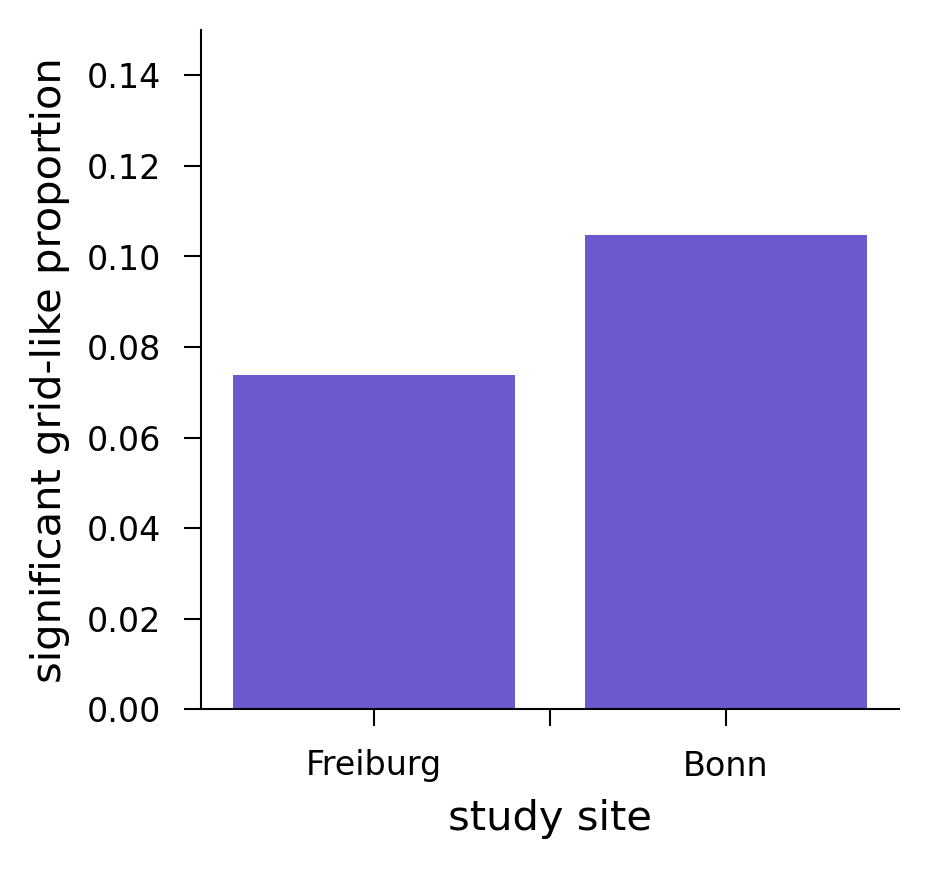

In [ ]:
# Figure S14:
# Freiburg vs. Bonn 

# Let's test the proportions here:
grid_cell_mask = (condensed_df.computed_p_label<=0.05) 
firing_rate_mask = (condensed_df.nspikes_total>=100)
condensed_df['grid_cell'] = (grid_cell_mask) & (firing_rate_mask)

count = [len(condensed_df.loc[(condensed_df.region=='EC') & (condensed_df.grid_cell==True) & (condensed_df.study_site=='Freiburg')]), 
         len(condensed_df.loc[(condensed_df.region=='EC') & (condensed_df.grid_cell==True) & (condensed_df.study_site=='Bonn')])]  # successes
nobs = [len(condensed_df.loc[(condensed_df.region=='EC') & (condensed_df.study_site=='Freiburg')]), 
        len(condensed_df.loc[(condensed_df.region=='EC') & (condensed_df.study_site=='Bonn')])]  # total trials

f, ax = plt.subplots(1,1, figsize=[3,3], dpi=300)

ax.bar([1, 2], [a/b for a, b in zip(count, nobs)], color=colors_dict['EC'])
ax.set(xticklabels=['', 'Freiburg', '', 'Bonn'], 
       ylabel='significant grid-like proportion', 
       xlabel='study site', ylim=[0, .15])

# Entorhinal grid-like neurons exhibit properties comparable to rodent grid cells.

### The properties of firing fields:

In [113]:
# Example cell in Figure 4D: 

field_res_df = pd.read_csv(f'{datapath}/field_res_df_public.csv')
field_res_df['spatial_arousal_bins'] = pd.cut(field_res_df['arousal'], bins=15, labels=np.arange(15))
field_res_df['spatial_valence_bins'] = pd.cut(field_res_df['valence'], bins=15, labels=np.arange(15))


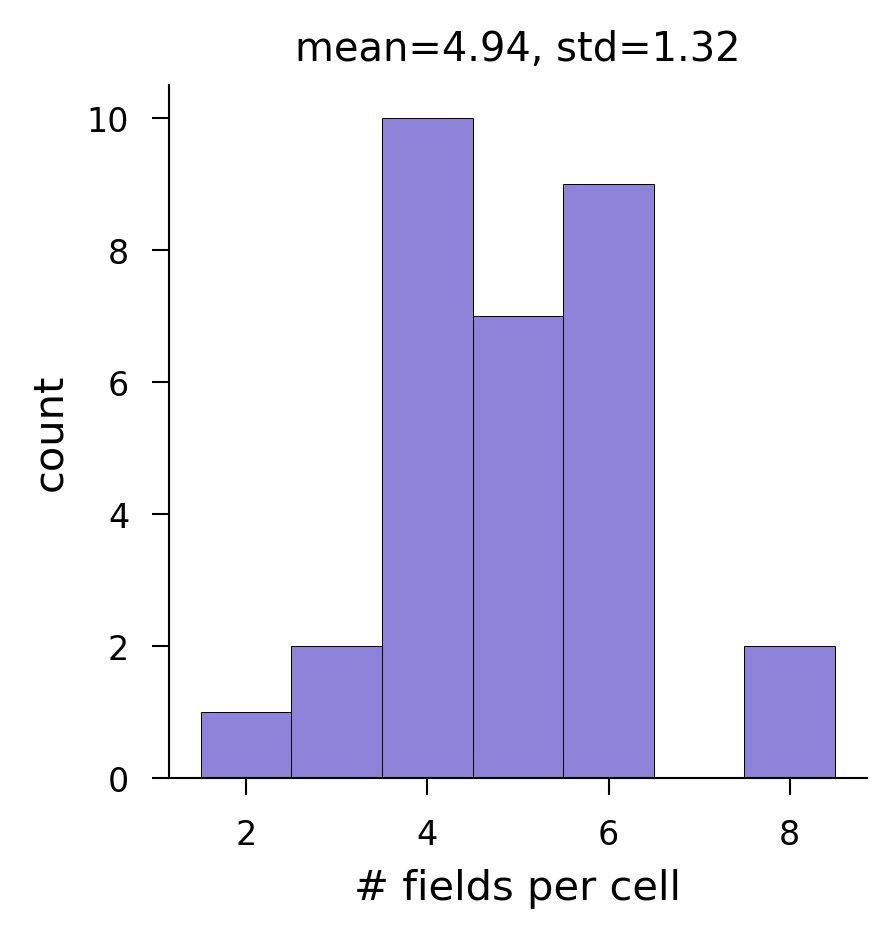

In [115]:
# Figure 4C:
# Number of fields per grid cell

# Count unique field_index per cluster
unique_fields_per_cluster = field_res_df[(field_res_df.infield==True) & (field_res_df.region=='EC') & (field_res_df.cluster!=542)].groupby('cluster')['field_id'].nunique()


# Create histogram with seaborn
plt.figure(figsize=(3, 3), dpi=300)
sns.histplot(unique_fields_per_cluster.values, color=colors_dict['EC'], bins=np.arange(1.5,9.5,1))
plt.xlabel('# fields per cell')
plt.ylabel('count')
plt.title(f'mean={np.mean(unique_fields_per_cluster.values):.2f}, std={np.std(unique_fields_per_cluster.values):.2f}')
sns.despine()



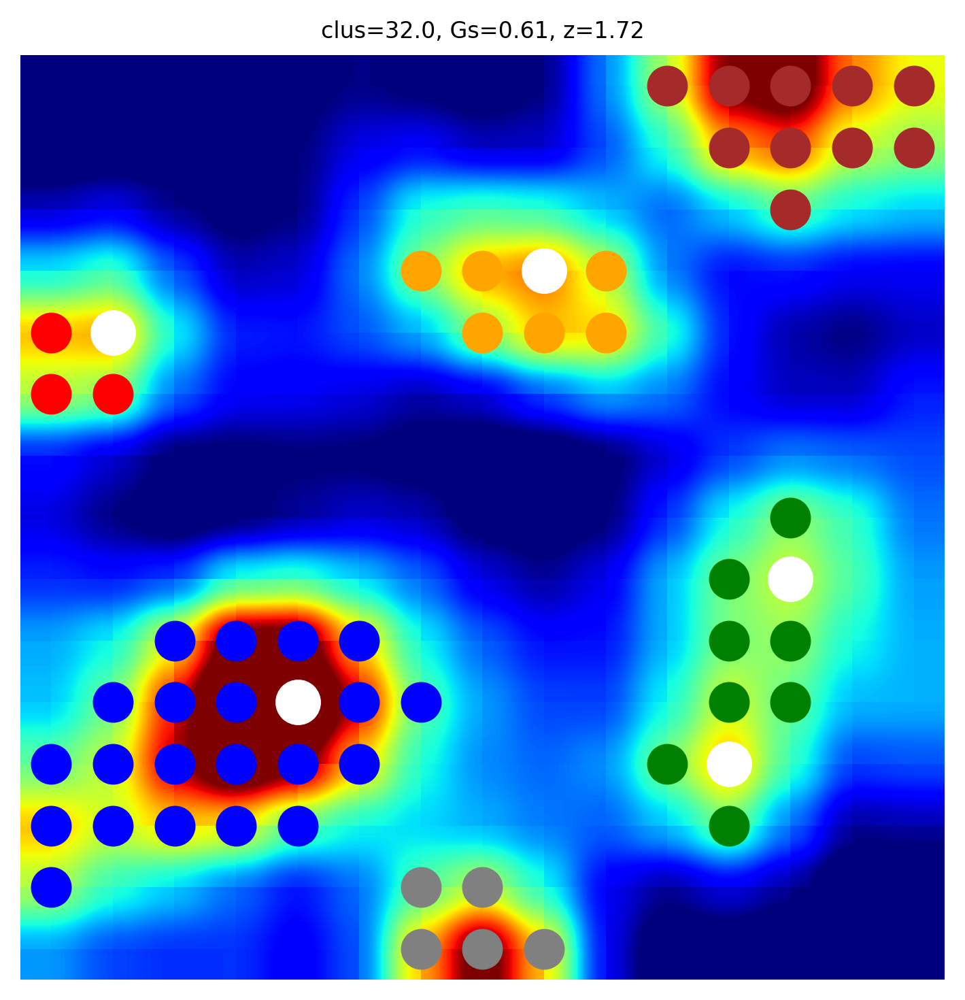

In [ ]:
# Figure 4D (inset):
# Set up parameters
nbins = 15
x_dim = 'valence'
y_dim = 'arousal'
window_of_interest = {'early_trunc':[0.2, 1]}
timeframe = 'early_trunc'
spiking_metric = 'evoked_fr'

# Limit to desired number of cells
cells_to_plot = condensed_df[condensed_df.cluster==32]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(5, 5), dpi=300)


for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):

    heatmap_plt = axes

    # Extract cell's data
    plot_df = field_res_df[
        (field_res_df.subj_id == cell.subj_id) &
        (field_res_df.region == cell.region) &
        (field_res_df.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['valence'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['valence_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins
    
    # Compute rate map
    binned_data = plot_df.groupby(['valence_binned', 'arousal_binned']).agg(
        {f'{spiking_metric}_{timeframe}': np.nanmean}
    ).reset_index()
    
    rate_map = binned_data.pivot(index='arousal_binned', columns='valence_binned', values=f'{spiking_metric}_{timeframe}')
    

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    peaks, fields = grid_utils.detect_peaks_and_fields(fr_smoothed,
                            z_thr=0.5,
                            min_area=1,
                            min_peak_rate_frac=0.1,
                            footprint_size=1,
                            watershed_promote=False)

    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin, origin='lower')
    heatmap_plt.axis('off')
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    colors = ['gray', 'blue', 'green', 'red', 'orange', 'brown']
    for ix, field in enumerate(fields):
        field = [sublist[::-1] for sublist in field]
        heatmap_plt.scatter(*zip(*field), s=200, color=colors[ix])
    for peak in peaks:
        heatmap_plt.scatter(peak[1], peak[0], color='white', s=250)

# Finalize figure
plt.tight_layout()


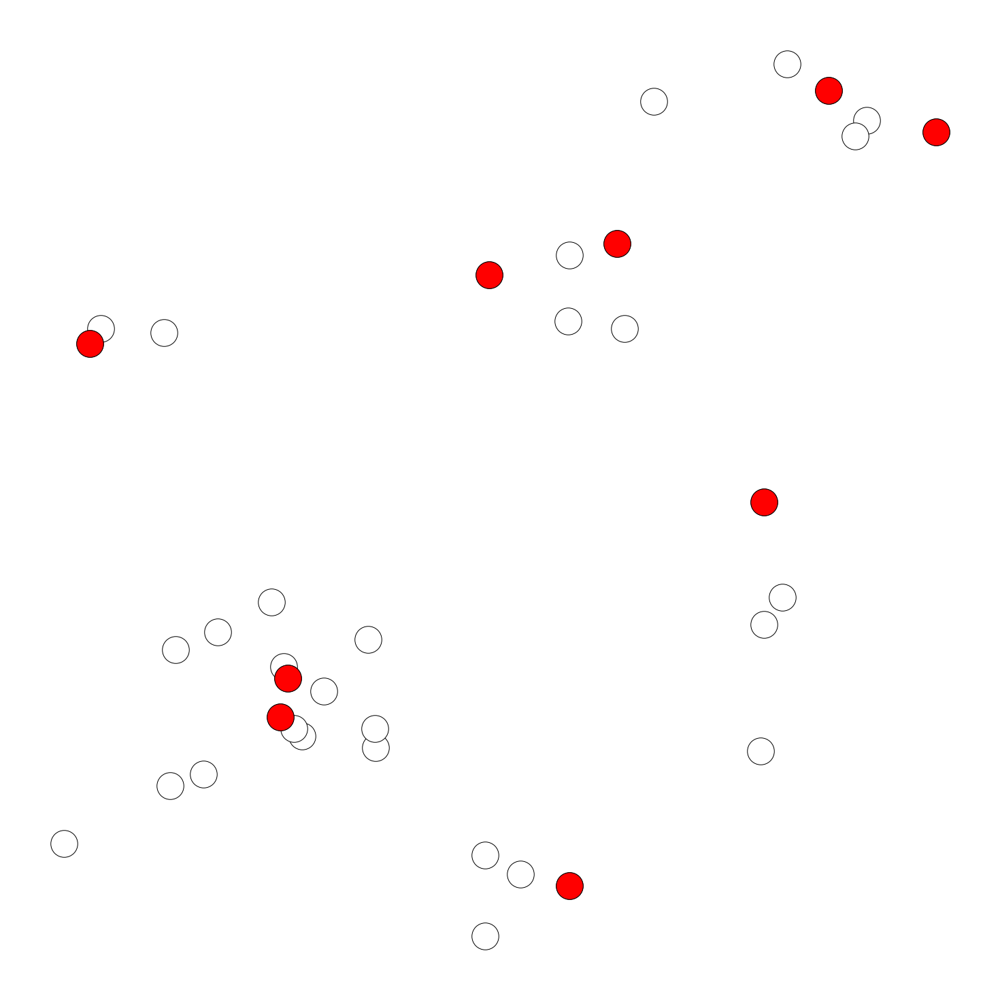

In [ ]:
# Figure 4D:
# Set up parameters
nbins = 15
x_dim = 'valence'
y_dim = 'arousal'
window_of_interest = {'early_trunc':[0.2, 1]}
timeframe = 'early_trunc'

# Limit to desired number of cells
cells_to_plot = condensed_df[condensed_df.cluster==32]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(5, 5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):

    infield_im_df = field_res_df[(field_res_df.cluster==32) & (field_res_df.infield==True)][['image_name', 'field_id', 
                                                                                'valence', 
                                                                                'arousal']]

    for ix, cell in infield_im_df.iterrows():
        axes.scatter(cell.valence, cell.arousal, 
                            color='white', s=90, edgecolor='k')
        if cell.image_name in ['Fire 4', 'Galaxy 8', 'Animal carcass 2', 'Depressed face 1', 
                               'School 5', 'Skydiving 1', 'Swimming 1', 'Woods 1', 'Soldiers 4']:
            # print(cell.field_id)
            axes.scatter(cell.valence, cell.arousal, 
                    color='red', s=90, edgecolor='k')
        
    axes.axis('off')

# Finalize figure
plt.tight_layout()

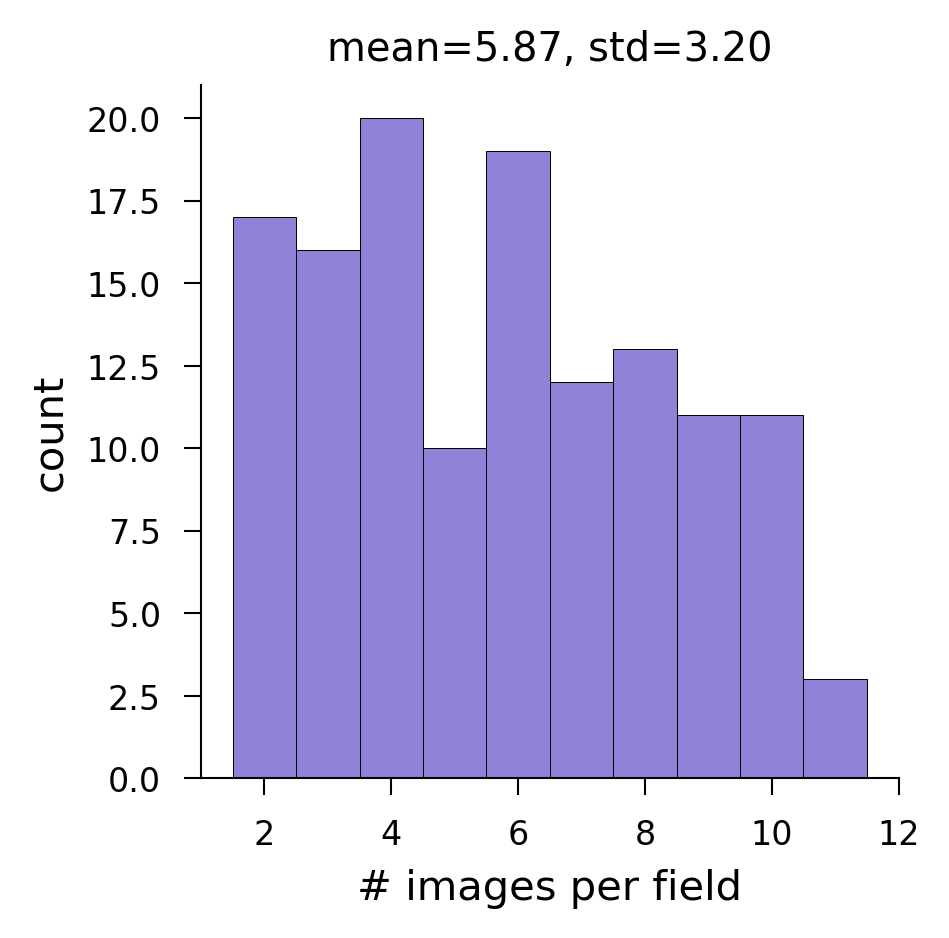

In [116]:
# Figure 4E:
# Get the counts
images_per_field_per_cluster = field_res_df[(field_res_df.infield==True) & (field_res_df.region=='EC') & (field_res_df.cluster!=542)].groupby(['cluster', 'field_id'])['image_num'].nunique()

# Create histogram
plt.figure(figsize=(3, 3), dpi=300)
sns.histplot(images_per_field_per_cluster.values, color=colors_dict['EC'], bins=np.arange(1.5,12.5,1))
plt.xlabel('# images per field')
plt.ylabel('count')
plt.title(f'mean={np.mean(images_per_field_per_cluster.values):.2f}, std={np.std(images_per_field_per_cluster.values):.2f}')
sns.despine()



In [118]:
grid_cell_properties = pd.read_csv(f'{datapath}/grid_cell_properties_public.csv')

Text(0.5, 0, 'orientation (degrees)')

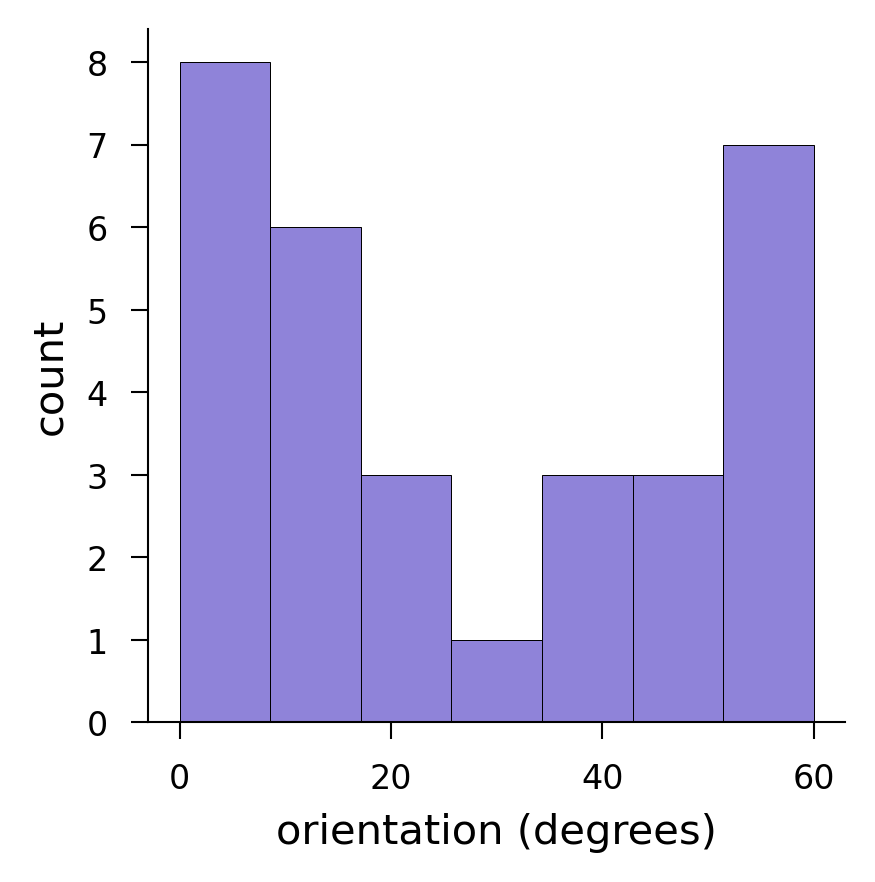

In [ ]:
# Figure 4G:
plt.figure(figsize=(3, 3), dpi=300)

sns.histplot(data=grid_cell_properties, x='Orientation (fixed)', 
             color=colors_dict['EC'], edgecolor=None, binrange=[0, 60])

plt.ylabel('count')
plt.xlabel('orientation (degrees)')


Text(0.5, 0, 'grid scale (spatial bins)')

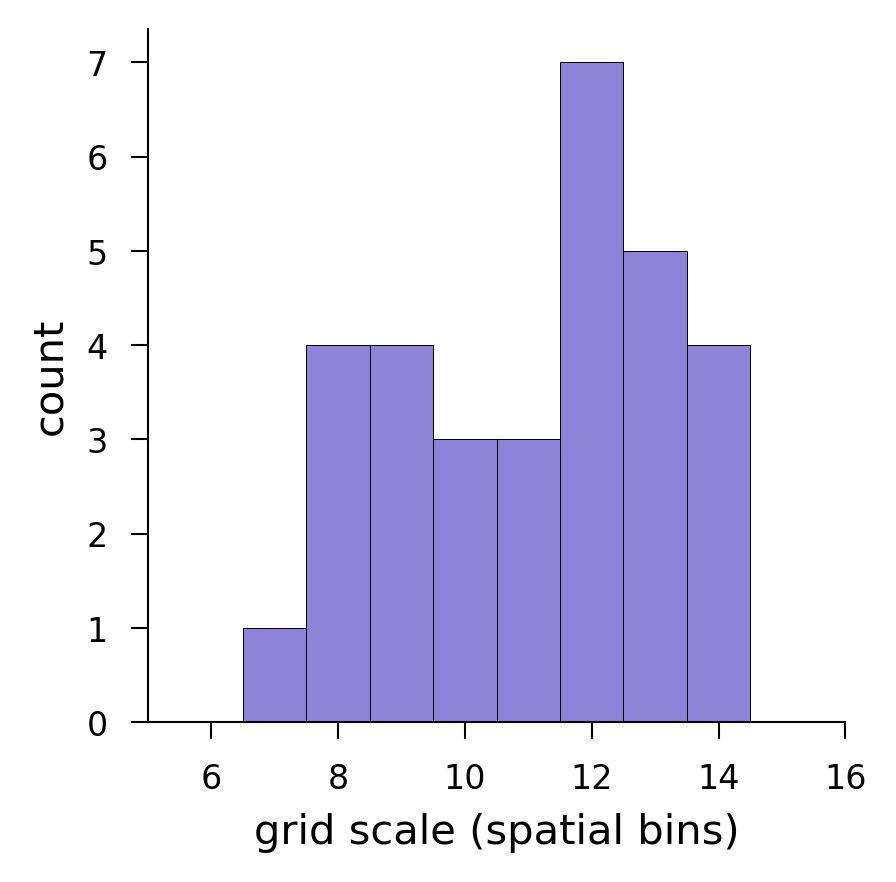

In [125]:
# Figure 4F:

plt.figure(figsize=(3, 3), dpi=300)

sns.histplot(data=grid_cell_properties, x='scale_prop', color=colors_dict['EC'],
bins=np.arange(5.5,16,1))

plt.ylabel('count')
plt.xlabel('grid scale (spatial bins)')


Text(0.5, 0, 'offset (valence bins)')

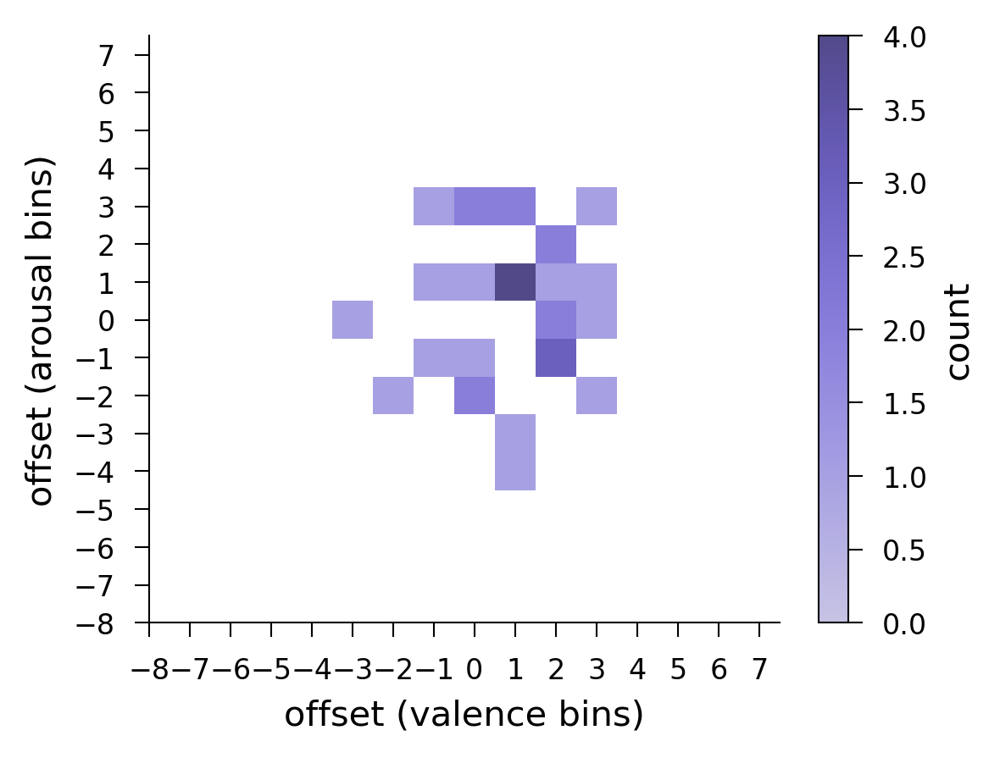

In [128]:
# Figure 4H:
f,ax = plt.subplots(1, 1, dpi=300, figsize=(4,3))
sns.histplot(data=grid_cell_properties, x='phase_offset_valence', y='phase_offset_arousal', 
             color=colors_dict['EC'], binwidth=1, cbar=True, cbar_kws={'label': 'count'})
# sns.despine(top=True, right=True, left=True, bottom=True)
ax.set(xlim=[-7.5, 7.5], 
       ylim=[-7.5, 7.5], xticks=np.arange(-8,8,1), yticks=np.arange(-8,8,1))

plt.ylabel('offset (arousal bins)')
plt.xlabel('offset (valence bins)')

### Are field properties clustered:

Two-sided 95% interval of surrogates: [5.1665, 8.6112]
Empirical value: 5.9167
95th percentile surrogate: 8.3694
Not significant: empirical within surrogate distribution
Two-sided p-value (against surrogates): 0.3197


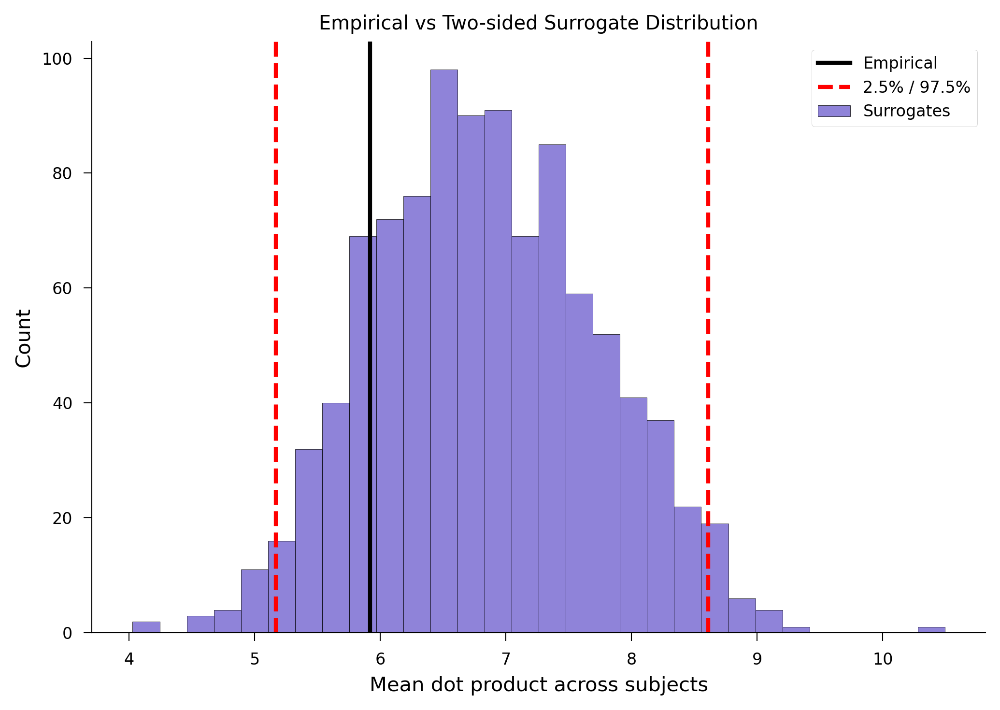

In [ ]:
# Figure S15A:
# Clustering of properties in subjects:

nbins = 15
n_surr = 1000

# -----------------------
# Step 1: Build empirical binarized maps per subject
# -----------------------
subject_maps = {}   # dict: subject -> list of binarized maps
all_maps = []       # global pool

for subject in grid_cell_properties.subj_id.unique(): 
    subj_df = grid_cell_properties[grid_cell_properties.subj_id==subject]
    subj_maps = []

    for cluster in subj_df.cluster.unique():
        binarized_rate_map = np.zeros((nbins, nbins), dtype=int)

        infield_im_coords = field_res_df[
            (field_res_df.cluster==cluster) & (field_res_df.infield==True)
        ][['spatial_valence_bins', 'spatial_arousal_bins']].dropna().values.astype(int)

        for x, y in infield_im_coords:
            binarized_rate_map[x, y] = 1

        flat_map = binarized_rate_map.flatten()
        subj_maps.append(flat_map)
        all_maps.append(flat_map)

    subject_maps[subject] = subj_maps


# -----------------------
# Step 2: Compute empirical value
# -----------------------
empirical_subject_means = []
for subj, maps in subject_maps.items():
    if len(maps) < 2:
        continue
    pair_dots = [np.dot(m1, m2) for m1, m2 in combinations(maps, 2)]
    empirical_subject_means.append(np.mean(pair_dots))

empirical_value = np.mean(empirical_subject_means)


# -----------------------
# Step 3: Surrogates — shuffle ACROSS subjects
# -----------------------
surrogate_values = []

# how many maps per subject originally
n_maps_per_subject = {subj: len(maps) for subj, maps in subject_maps.items()}

for _ in range(n_surr):
    shuffled_means = []

    # shuffle global pool
    permuted = np.random.permutation(all_maps)

    idx = 0
    for subj, n_maps in n_maps_per_subject.items():
        if n_maps < 2:
            continue
        fake_maps = permuted[idx: idx+n_maps]
        idx += n_maps

        pair_dots = [np.dot(m1, m2) for m1, m2 in combinations(fake_maps, 2)]
        shuffled_means.append(np.mean(pair_dots))

    surrogate_values.append(np.mean(shuffled_means))

low, high = np.percentile(surrogate_values, [2.5, 97.5])
print(f"Two-sided 95% interval of surrogates: [{low:.4f}, {high:.4f}]")


# -----------------------
# Step 4: Compare empirical vs surrogates
# -----------------------
surrogate_values = np.array(surrogate_values)
percentile_95 = np.percentile(surrogate_values, 95)

print(f"Empirical value: {empirical_value:.4f}")
print(f"95th percentile surrogate: {percentile_95:.4f}")

if empirical_value > percentile_95:
    print("Significant: empirical > 95th percentile of surrogates")
else:
    print("Not significant: empirical within surrogate distribution")

# center the null on its own mean (median also ok; see note below)
center = np.mean(surrogate_values)

# absolute deviations from center
emp_dev = abs(empirical_value - center)
surr_dev = abs(surrogate_values - center)

# two-sided p with the +1/(n+1) continuity correction
p_two_sided = (1 + np.sum(surr_dev >= emp_dev)) / (len(surrogate_values) + 1)
print(f"Two-sided p-value (against surrogates): {p_two_sided:.4g}")


plt.figure(figsize=(7,5))
plt.hist(surrogate_values, bins=30, alpha=0.75, edgecolor='k', label='Surrogates', color=colors_dict['EC'])
plt.axvline(empirical_value, linewidth=2, label='Empirical', color='k')
plt.axvline(low, linestyle='--', linewidth=2, label='2.5% / 97.5%', color='r')
plt.axvline(high, linestyle='--', linewidth=2, color='r')
plt.xlabel("Mean dot product across subjects")
plt.ylabel("Count")
plt.title("Empirical vs Two-sided Surrogate Distribution")
plt.legend()
plt.tight_layout()
# plt.show()



Empirical grand angular mean: 10.91°
95% surrogate interval: [10.12°, 18.14°]
Not significant
Two-sided permutation p-value: 0.1309


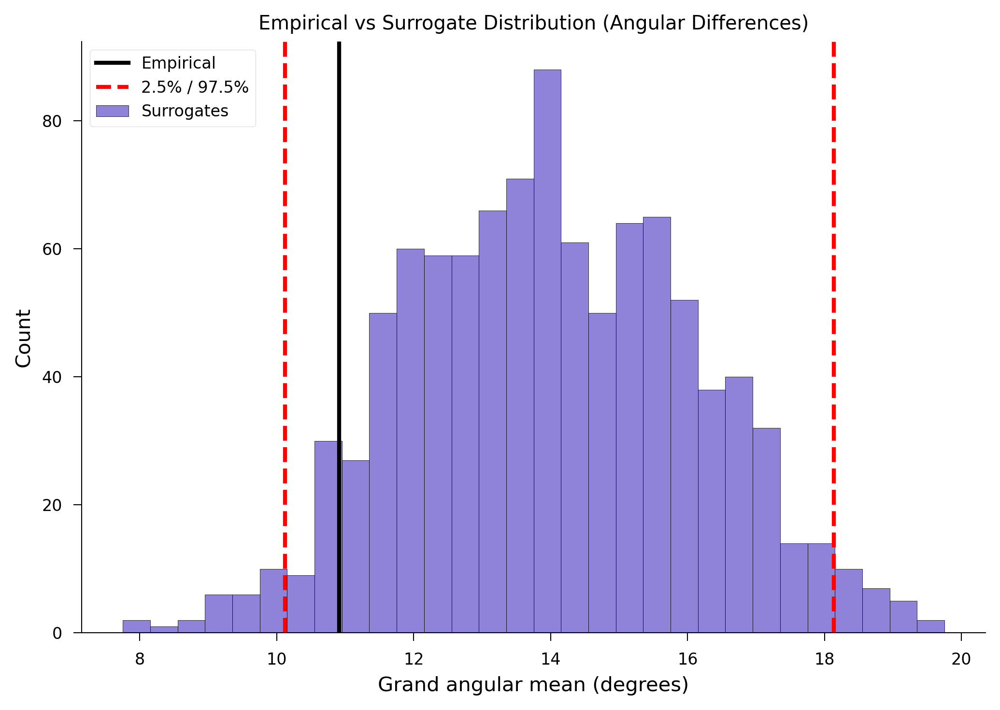

In [ ]:
# Figure S15B:

def circmean_deg(angles):
    """Circular mean of angles in degrees."""
    radians = np.deg2rad(angles)
    mean_angle = np.arctan2(np.mean(np.sin(radians)), np.mean(np.cos(radians)))
    return np.rad2deg(mean_angle) % 360

def angular_difference(a1, a2):
    """Minimal angular difference in degrees (0-180)."""
    diff = abs(a1 - a2) % 360
    return min(diff, 360 - diff)

n_surr = 1000

# -----------------------
# Step 1: Empirical value
# -----------------------
subject_means = []
subject_counts = {}

for subj in grid_cell_properties_df.subj_id.unique():
    subj_orientations = grid_cell_properties_df.loc[grid_cell_properties_df.subj_id==subj, 'Orientation (fixed)'].dropna().values
    subject_counts[subj] = len(subj_orientations)
    if len(subj_orientations) < 2:
        continue

    diffs = [min(angular_difference(a1, a2), 60-angular_difference(a1, a2)) for a1, a2 in combinations(subj_orientations, 2)]
    subj_mean = circmean_deg(diffs)
    subject_means.append(subj_mean)

empirical_value = circmean_deg(subject_means)


# -----------------------
# Step 2: Surrogates
# -----------------------
all_orientations = grid_cell_properties_df['Orientation (fixed)'].dropna().values
surrogate_values = []

for _ in range(n_surr):
    # shuffle orientations across subjects
    permuted = np.random.permutation(all_orientations)

    idx = 0
    subj_means = []
    for subj, n_orients in subject_counts.items():
        if n_orients < 2:
            continue
        fake_orients = permuted[idx: idx+n_orients]
        idx += n_orients

        diffs = [min(angular_difference(a1, a2), 60-angular_difference(a1, a2)) for a1, a2 in combinations(fake_orients, 2)]
        subj_mean = circmean_deg(diffs)
        subj_means.append(subj_mean)

    surrogate_values.append(circmean_deg(subj_means))


# -----------------------
# Step 3: Compare
# -----------------------
surrogate_values = np.array(surrogate_values)
low, high = np.percentile(surrogate_values, [2.5, 97.5])

print(f"Empirical grand angular mean: {empirical_value:.2f}°")
print(f"95% surrogate interval: [{low:.2f}°, {high:.2f}°]")

if (empirical_value < low) or (empirical_value > high):
    print("Significant (two-sided test)")
else:
    print("Not significant")
    
# -----------------------
# Step 4: Two-sided p-value
# -----------------------
center = np.mean(surrogate_values)  # or np.median for robustness
emp_dev = abs(empirical_value - center)
surr_dev = abs(surrogate_values - center)

p_two_sided = (1 + np.sum(surr_dev >= emp_dev)) / (len(surrogate_values) + 1)
print(f"Two-sided permutation p-value: {p_two_sided:.4g}")


# -----------------------
# Step 5: Plot
# -----------------------
plt.figure(figsize=(7,5))

plt.hist(surrogate_values, bins=30, alpha=0.75, edgecolor='k', label='Surrogates', color=colors_dict['EC'])
plt.axvline(empirical_value, color='k', linewidth=2, label='Empirical')
plt.axvline(low, color='r', linestyle='--', linewidth=2, label='2.5% / 97.5%')
plt.axvline(high, color='r', linestyle='--', linewidth=2)

plt.xlabel("Grand angular mean (degrees)")
plt.ylabel("Count")
plt.title("Empirical vs Surrogate Distribution (Angular Differences)")
plt.legend()
plt.tight_layout()

Empirical grand mean of pairwise differences: 2.2240
95% surrogate interval: [1.6592, 3.3004]
Two-sided permutation p-value: 0.5325


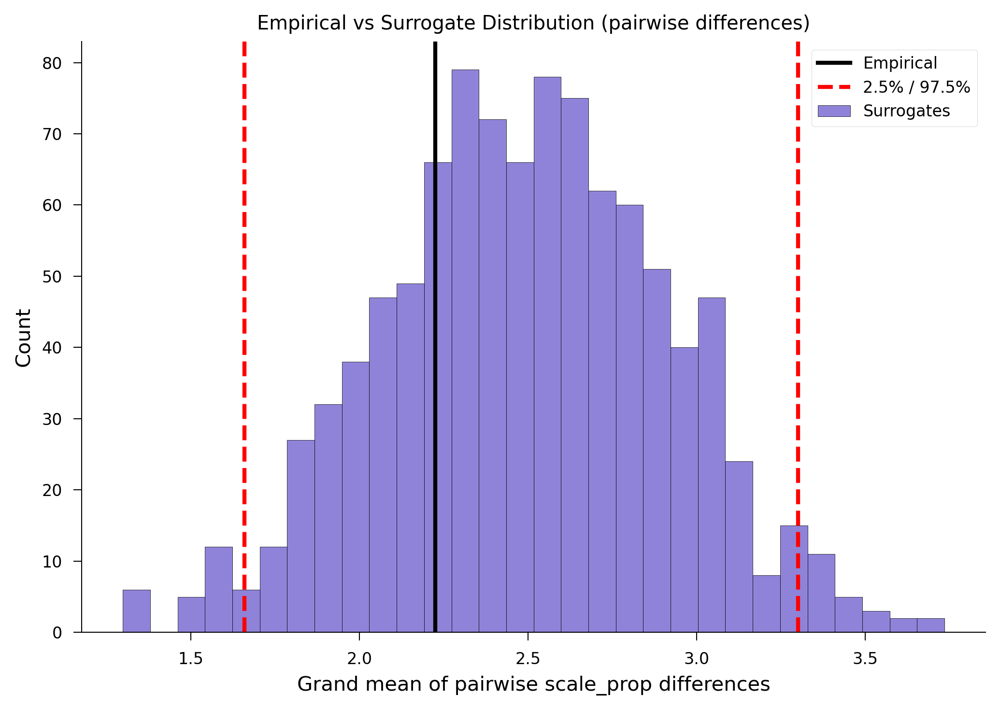

In [ ]:
# Figure S15C: 

n_surr = 1000

# -----------------------
# Step 1: Empirical grand mean of pairwise differences
# -----------------------
subject_means = []
subject_counts = {}

for subj in grid_cell_properties.subj_id.unique():
    subj_vals = grid_cell_properties.loc[grid_cell_properties.subj_id==subj, 'scale_prop'].dropna().values
    subject_counts[subj] = len(subj_vals)
    if len(subj_vals) < 2:
        continue

    diffs = [abs(a1 - a2) for a1, a2 in combinations(subj_vals, 2)]
    subject_means.append(np.mean(diffs))

empirical_value = np.mean(subject_means)


# -----------------------
# Step 2: Surrogates
# -----------------------
all_vals = grid_cell_properties['scale_prop'].dropna().values
surrogate_values = []

for _ in range(n_surr):
    permuted = np.random.permutation(all_vals)

    idx = 0
    subj_means = []
    for subj, n in subject_counts.items():
        if n < 2:
            continue
        fake_vals = permuted[idx: idx+n]
        idx += n

        diffs = [abs(a1 - a2) for a1, a2 in combinations(fake_vals, 2)]
        subj_means.append(np.mean(diffs))

    surrogate_values.append(np.mean(subj_means))


# -----------------------
# Step 3: Two-sided p-value and 95% interval
# -----------------------
surrogate_values = np.array(surrogate_values)
low, high = np.percentile(surrogate_values, [2.5, 97.5])

center = np.mean(surrogate_values)
emp_dev = abs(empirical_value - center)
surr_dev = abs(surrogate_values - center)
p_two_sided = (1 + np.sum(surr_dev >= emp_dev)) / (len(surrogate_values) + 1)

print(f"Empirical grand mean of pairwise differences: {empirical_value:.4f}")
print(f"95% surrogate interval: [{low:.4f}, {high:.4f}]")
print(f"Two-sided permutation p-value: {p_two_sided:.4g}")


# -----------------------
# Step 4: Plot
# -----------------------
plt.figure(figsize=(7,5))
plt.hist(surrogate_values, bins=30, alpha=0.75, edgecolor='k', label='Surrogates', color=colors_dict['EC'])
plt.axvline(empirical_value, color='k', linewidth=2, label='Empirical')
plt.axvline(low, color='r', linestyle='--', linewidth=2, label='2.5% / 97.5%')
plt.axvline(high, color='r', linestyle='--', linewidth=2)

plt.xlabel("Grand mean of pairwise scale_prop differences")
plt.ylabel("Count")
plt.title("Empirical vs Surrogate Distribution (pairwise differences)")
plt.legend()
plt.tight_layout()

In [132]:
all_trial_res['grid_cell'] = False
for _, cell in condensed_df[(condensed_df.grid_cell==1)].iterrows():
    
    all_trial_res.loc[(all_trial_res.subj_id==cell.subj_id) & (all_trial_res.region==cell.region) & (all_trial_res.cluster==cell.cluster),
                     'grid_cell'] = condensed_df.loc[condensed_df.cluster==cell.cluster, 'grid_cell'].values[0]

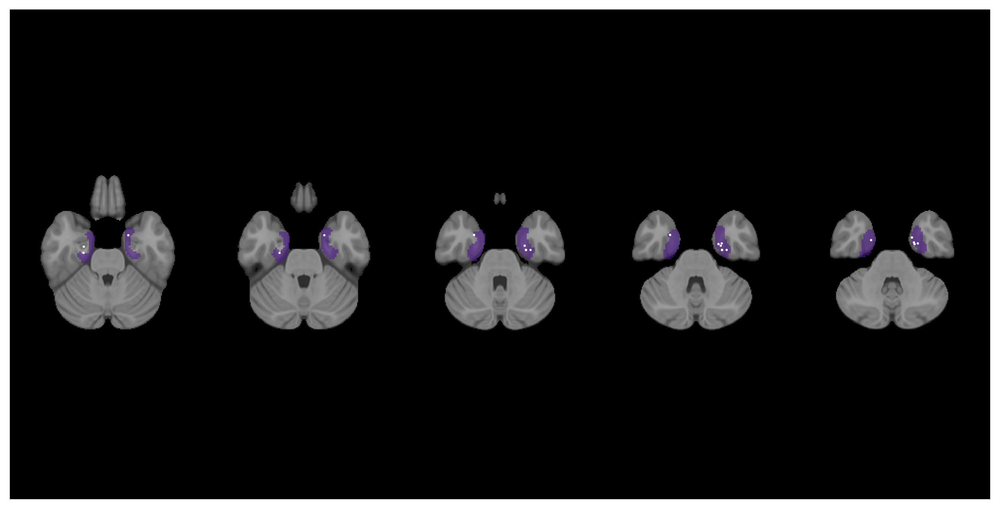

In [ ]:
# Figure S16:
# Fetch atlas with labels

julich = datasets.fetch_atlas_juelich('maxprob-thr25-2mm')
atlas_img = julich.maps
labels = julich.labels

# Get index of entorhinal cortex
ec_idx = labels.index('GM Hippocampus entorhinal cortex')  # or 'Entorhinal Cortex' if available
ec_mask = math_img('img == %d' % ec_idx, img=atlas_img)


# Load a standard anatomical background image in MNI space
mni_template = datasets.load_mni152_template(resolution=1)  # 1mm for publication quality


# Your MNI coordinates (N x 3 matrix)
coords = all_trial_res[all_trial_res.grid_cell==1] \
    .groupby('cluster')[['mni_x', 'mni_y', 'mni_z']].mean().values

# Optional: choose a color
color = 'purple'  # or use RGB tuples

# Create the static figure
f = plt.figure(figsize=(10, 5), dpi=300)

display = plotting.plot_anat(mni_template,
                                 display_mode='z',  # 'x', 'y', or 'z' slice view
                                 cut_coords=[-28, -30, -32, -34, -36],    # adjust based on where EC falls (e.g., x=0 for mid-sagittal)
                                 annotate=False,
                                 draw_cross=False,
                                 black_bg=True,
                                 figure=f)

# Add the coordinates
# Take only the darker half of the Purples colormap

purples = cm.get_cmap('Purples', 256)
dark_purples = ListedColormap(purples(np.linspace(0.9, 1.0, 256)))

display.add_overlay(ec_mask, cmap=dark_purples, alpha=0.6)
display.add_markers(coords, marker_color='white', marker_size=2)

### Temporal stability:

In [89]:
# timewise plot 
win_len = 0.8
slide_len = 0.2 

timewise_df = pd.read_csv(f'{datapath}/timewise_df_all_{win_len}_{slide_len}_public.csv')
grid_clusters = condensed_df[condensed_df.grid_cell==1].cluster.values


[Text(0, 0.5, 'grid score (z)'),
 Text(0.5, 0, 'ts (s)'),
 Text(0.5, 1.0, 'sliding window=0.8 s, overlap=0.2 s'),
 (-0.5, 3.0)]

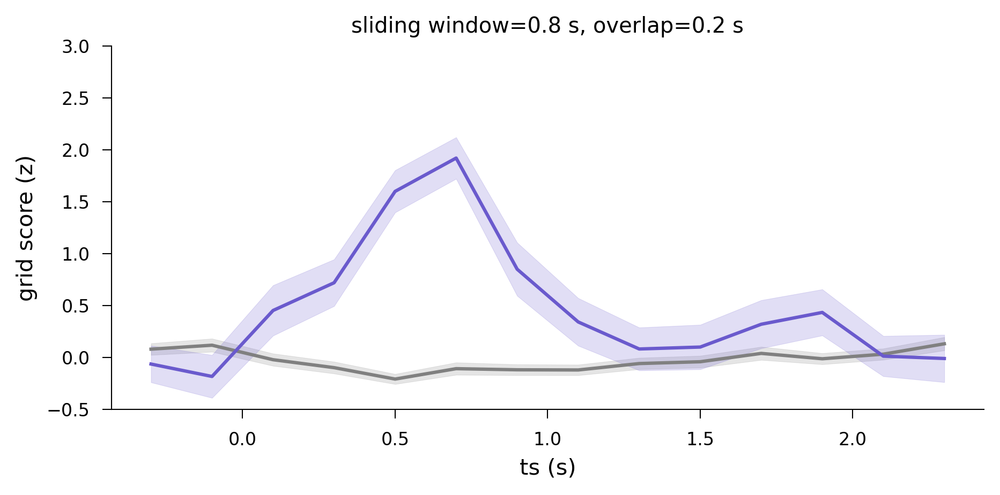

In [ ]:
# Figure S17A:

f, ax = plt.subplots(1, 1, figsize=[7,3], dpi=300) 
sns.lineplot(data=timewise_df.loc[(~timewise_df.cluster.isin(grid_clusters))& (timewise_df.region=='EC')], x='ts_mid', y='zGs', color='gray', errorbar='se')
sns.lineplot(data=timewise_df.loc[(timewise_df.cluster.isin(grid_clusters))& (timewise_df.region=='EC')], x='ts_mid', y='zGs', color=colors_dict['EC'], errorbar='se')
sns.despine()
ax.set(ylabel='grid score (z)', xlabel='ts (s)', title=f'sliding window={win_len} s, overlap={slide_len} s', ylim=[-0.5, 3])

[Text(0.5, 0, 'split-half correlation (rho)'), Text(0, 0.5, 'count')]

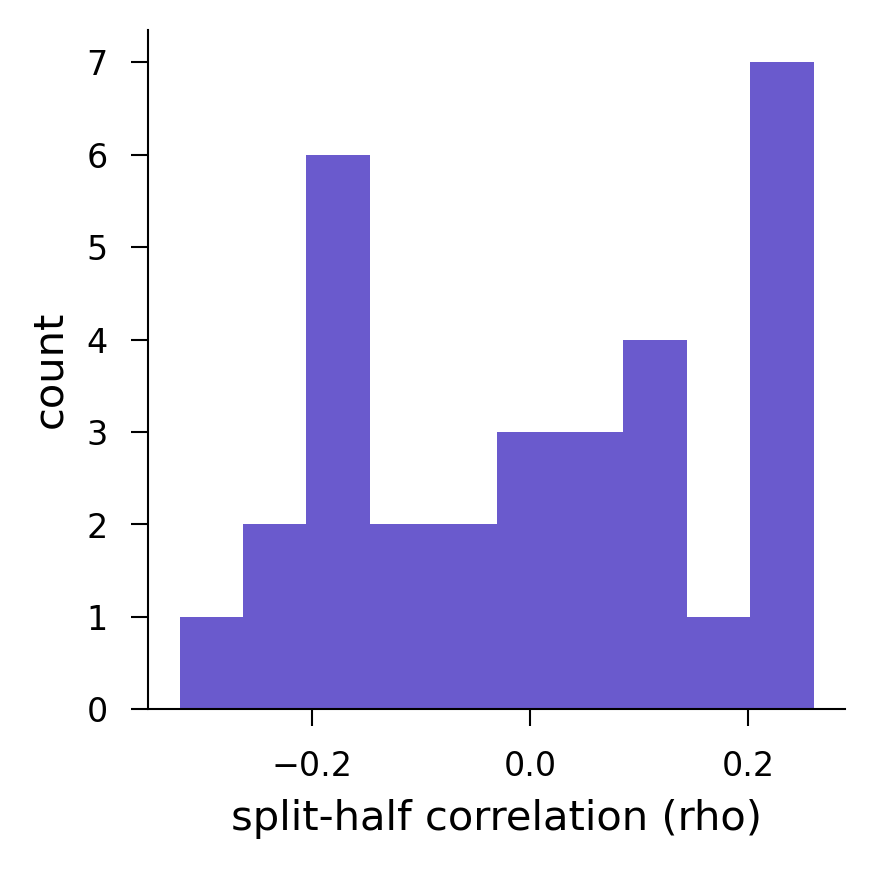

In [ ]:
# Figure S17B:

f, ax = plt.subplots(1,1, figsize=[3,3], dpi=300)

ax.hist(condensed_df[(condensed_df.grid_cell==1) & (condensed_df.region=='EC')].Stability,
       color=colors_dict['EC'])
ax.set(xlabel='split-half correlation (rho)', ylabel='count')



In [148]:
with open(f'{datapath}/rat_grid_cells_list.json') as f:
    rat_grid_cells = json.load(f)
    
with open(f'{datapath}/weak_grid_cells_list.json') as f:
    weak_grid_cells = json.load(f)
    
with open(f'{datapath}/non_grid_cells_list.json') as f:
    non_grid_cells = json.load(f)
    
    
# Make a dataframe using one session

x_dim = 'zValence'
y_dim = 'zArousal'
dataframe = all_encoding_df.loc[all_encoding_df.sess_id==5][[x_dim, y_dim]]
nbins = 15

x_bins = pd.cut(dataframe[x_dim], nbins, labels=np.arange(0, nbins))
y_bins = pd.cut(dataframe[y_dim], nbins, labels=np.arange(0, nbins))

dataframe[f'{x_dim}_binned'] = x_bins.astype(int)
dataframe[f'{y_dim}_binned'] = y_bins.astype(int)
dataframe['fr'] = np.nan

/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_c

: 

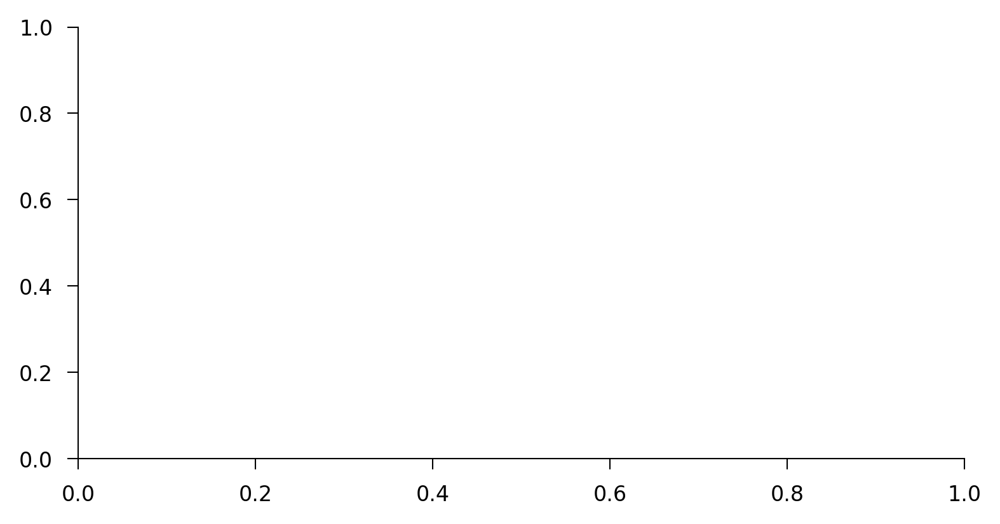

In [ ]:
# trial_count_gs_all = []
# for cell in rat_grid_cells:
#     posx, posy, t, dt, spiketrain, smoothFiringRate = find_grid_cells.load_data(cell)
#     rat_map, _ = calculate_2d_tuning_curve(posx, posy, smoothFiringRate, nbins, 0, 100)
#     rat_map_smooth = grid_utils.smooth_ratemap(rat_map, 1)

#     # Use rat data as mean to sample firing rates for our valence-arousal space, with small std

#     for coords in dataframe[[f'{x_dim}_binned', f'{y_dim}_binned']].values:
#         mean = rat_map[coords[0], coords[1]]
#         std = 0.5 # high consistency
#         sample = np.random.normal(loc=mean, scale=std, size=None)
#         dataframe.loc[(dataframe[f'{x_dim}_binned']==coords[0]) & (dataframe[f'{y_dim}_binned']==coords[1]), 'fr'] = sample

#     fake_ratemap = np.full((nbins, nbins), np.nan)  # Use np.zeros((15, 15)) if you prefer 0s

#     # Use a subset of trials to generate the ratemap
#     trial_counts_all = [30, 60, 90, 120, 150, 180, 210, 240]
#     trial_count_gs = []
#     for trial_counts in trial_counts_all:
#         for _, row in dataframe.iloc[:trial_counts].iterrows():
#             fake_ratemap[int(row[f'{x_dim}_binned']), int(row[f'{y_dim}_binned'])] = row['fr']

#         fake_smoothmap = grid_utils.smooth_ratemap(fake_ratemap, 1)
        
#         grid_scorer = grid_utils.GridCell(nbins=nbins)
#         Gs, _, _ = grid_scorer.get_scores(fake_smoothmap)

#         # print(Gs['6'])
#         trial_count_gs.append(Gs['6'])
    
#     trial_count_gs_all.append(trial_count_gs)

# trial_count_gs_all_weak = []

# for cell in weak_grid_cells:
#     posx, posy, t, dt, spiketrain, smoothFiringRate = find_grid_cells.load_data(cell)
#     rat_map, _ = calculate_2d_tuning_curve(posx, posy, smoothFiringRate, nbins, 0, 100)
#     rat_map_smooth = grid_utils.smooth_ratemap(rat_map, 1)

#     # Use rat data as mean to sample firing rates for our valence-arousal space, with small std

#     for coords in dataframe[[f'{x_dim}_binned', f'{y_dim}_binned']].values:
#         mean = rat_map[coords[0], coords[1]]
#         std = 0.5 # high consistency
#         sample = np.random.normal(loc=mean, scale=std, size=None)
#         dataframe.loc[(dataframe[f'{x_dim}_binned']==coords[0]) & (dataframe[f'{y_dim}_binned']==coords[1]), 'fr'] = sample

#     fake_ratemap = np.full((nbins, nbins), np.nan)  # Use np.zeros((15, 15)) if you prefer 0s

#     # Use a subset of trials to generate the ratemap
#     trial_counts_all = [30, 60, 90, 120, 150, 180, 210, 240]
#     trial_count_gs = []
#     for trial_counts in trial_counts_all:
#         for _, row in dataframe.iloc[:trial_counts].iterrows():
#             fake_ratemap[int(row[f'{x_dim}_binned']), int(row[f'{y_dim}_binned'])] = row['fr']

#         fake_smoothmap = grid_utils.smooth_ratemap(fake_ratemap, 1)

#         grid_scorer = grid_utils.GridCell(nbins=nbins)
#         Gs, _, _ = grid_scorer.get_scores(fake_smoothmap)

#         # print(Gs['6'])
#         trial_count_gs.append(Gs['6'])
    
#     trial_count_gs_all_weak.append(trial_count_gs)

# trial_count_gs_all_nongrid = []

# for cell in non_grid_cells:
#     posx, posy, t, dt, spiketrain, smoothFiringRate = find_grid_cells.load_data(cell)
#     rat_map, _ = calculate_2d_tuning_curve(posx, posy, smoothFiringRate, nbins, 0, 100)
#     rat_map_smooth = grid_utils.smooth_ratemap(rat_map, 1)

#     # Use rat data as mean to sample firing rates for our valence-arousal space, with small std

#     for coords in dataframe[[f'{x_dim}_binned', f'{y_dim}_binned']].values:
#         mean = rat_map[coords[0], coords[1]]
#         std = 0.5 # high consistency
#         sample = np.random.normal(loc=mean, scale=std, size=None)
#         dataframe.loc[(dataframe[f'{x_dim}_binned']==coords[0]) & (dataframe[f'{y_dim}_binned']==coords[1]), 'fr'] = sample

#     fake_ratemap = np.full((nbins, nbins), np.nan)  # Use np.zeros((15, 15)) if you prefer 0s

#     # Use a subset of trials to generate the ratemap
#     trial_counts_all = [30, 60, 90, 120, 150, 180, 210, 240]
#     trial_count_gs = []
#     for trial_counts in trial_counts_all:
#         for _, row in dataframe.iloc[:trial_counts].iterrows():
#             fake_ratemap[int(row[f'{x_dim}_binned']), int(row[f'{y_dim}_binned'])] = row['fr']

#         fake_smoothmap = grid_utils.smooth_ratemap(fake_ratemap, 1)

#         grid_scorer = grid_utils.GridCell(nbins=nbins)
#         Gs, _, _ = grid_scorer.get_scores(fake_smoothmap)

#         trial_count_gs.append(Gs['6'])
#     trial_count_gs_all_nongrid.append(trial_count_gs)
    



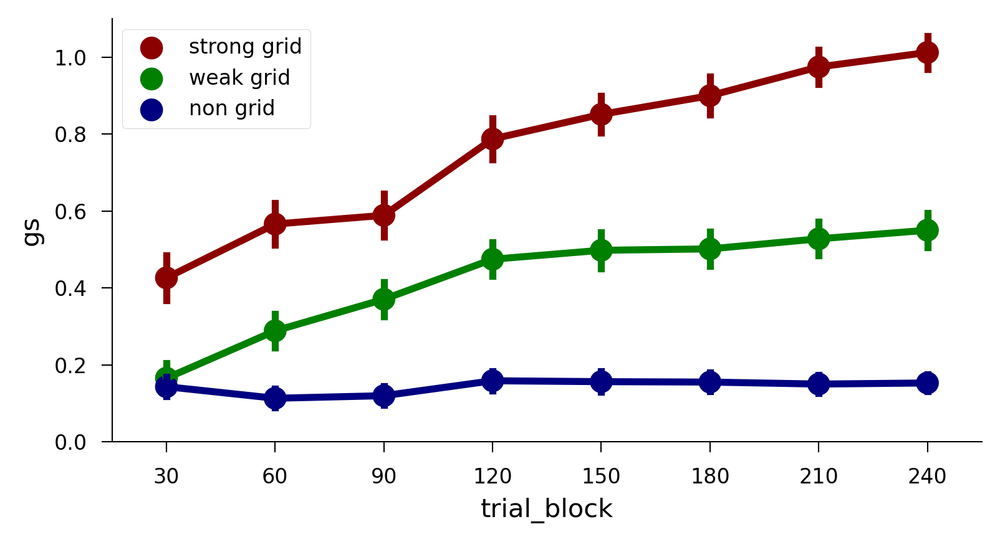

In [ ]:
# Figure S17C, left:

# trial_count_gs_all_nongrid = np.vstack(trial_count_gs_all_nongrid)
# trial_count_gs_all_weak = np.vstack(trial_count_gs_all_weak)
# trial_count_gs_all = np.vstack(trial_count_gs_all)


with open('data/non_grid_cells_list.json', 'r') as f:
    trial_count_gs_all_nongrid = json.load(f)
with open('data/weak_grid_cells_list.json', 'r') as f:
    trial_count_gs_all_weak = json.load(f)
with open('data/rat_grid_cells_list.json', 'r') as f:
    trial_count_gs_all = json.load(f)

f,ax = plt.subplots(1, 1, dpi=300, figsize=(6,3))

# Optional: name the original columns
df = pd.DataFrame(trial_count_gs_all)
df.columns = [i for i in trial_counts_all]
df['cell'] = range(trial_count_gs_all.shape[0])  # Add a row identifier

# Melt to long format
df_long = df.melt(id_vars='cell', var_name='column', value_name='value')
df_long.rename(columns={'column':'trial_block', 'value': 'Gs'}, inplace=True)

sns.pointplot(data=df_long, x='trial_block', y='Gs', errorbar='se', color='darkred', label='strong grid')

# Optional: name the original columns
df = pd.DataFrame(trial_count_gs_all_weak)
df.columns = [i for i in trial_counts_all]
df['cell'] = range(trial_count_gs_all_weak.shape[0])  # Add a row identifier

# Melt to long format
df_long = df.melt(id_vars='cell', var_name='column', value_name='value')
df_long.rename(columns={'column':'trial_block', 'value': 'Gs'}, inplace=True)

sns.pointplot(data=df_long, x='trial_block', y='Gs', errorbar='se', color='green', label='weak grid')

# Optional: name the original columns
df = pd.DataFrame(trial_count_gs_all_nongrid)
df.columns = [i for i in trial_counts_all]
df['cell'] = range(trial_count_gs_all_nongrid.shape[0])  # Add a row identifier

# Melt to long format
df_long = df.melt(id_vars='cell', var_name='column', value_name='value')
df_long.rename(columns={'column':'trial_block', 'value': 'Gs'}, inplace=True)

sns.pointplot(data=df_long, x='trial_block', y='Gs', errorbar='se', color='navy', label='non grid')

ax.set_ylabel('gs')
ax.set_ylim([0, 1.1])
ax.legend()

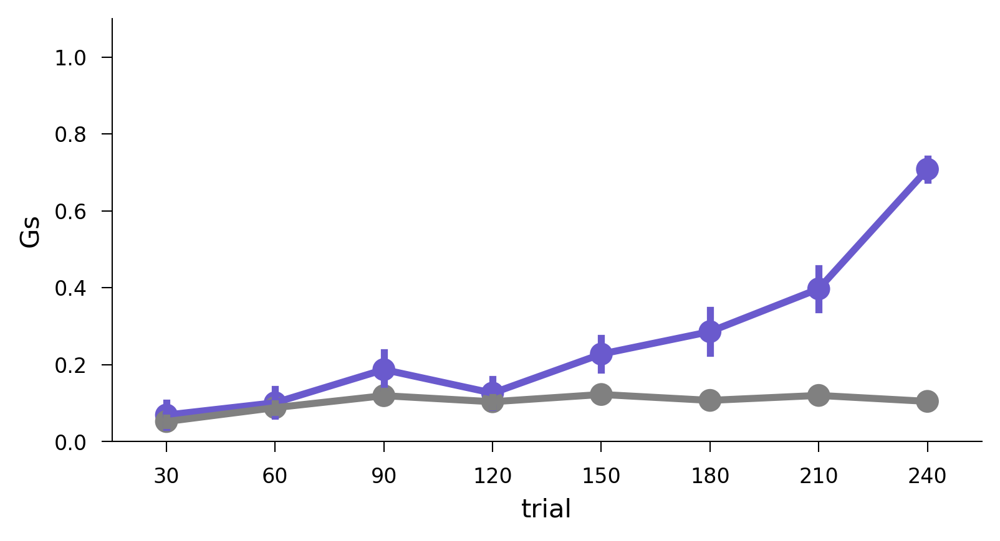

In [ ]:
# Figure S17C, right:
trial_varying_dfs = pd.read_csv(f'{datapath}/trial_varying_dfs_public.csv')
test_merge = condensed_df.merge(trial_varying_dfs, on=['cluster'], how='right')

f,ax = plt.subplots(1, 1, dpi=300, figsize=(6,3))


sns.pointplot(test_merge[(test_merge.grid_cell==1) & (test_merge.region_x=='EC')], x='trial_count', y='Gs_6', errorbar='se', color=colors_dict['EC'])
sns.pointplot(test_merge[(test_merge.grid_cell==0) & (test_merge.region_x=='EC')], x='trial_count', y='Gs_6', errorbar='se', color='gray')

ax.set(xlabel='trial', ylabel='Gs')

plt.ylim([0, 1.1])

sns.despine()

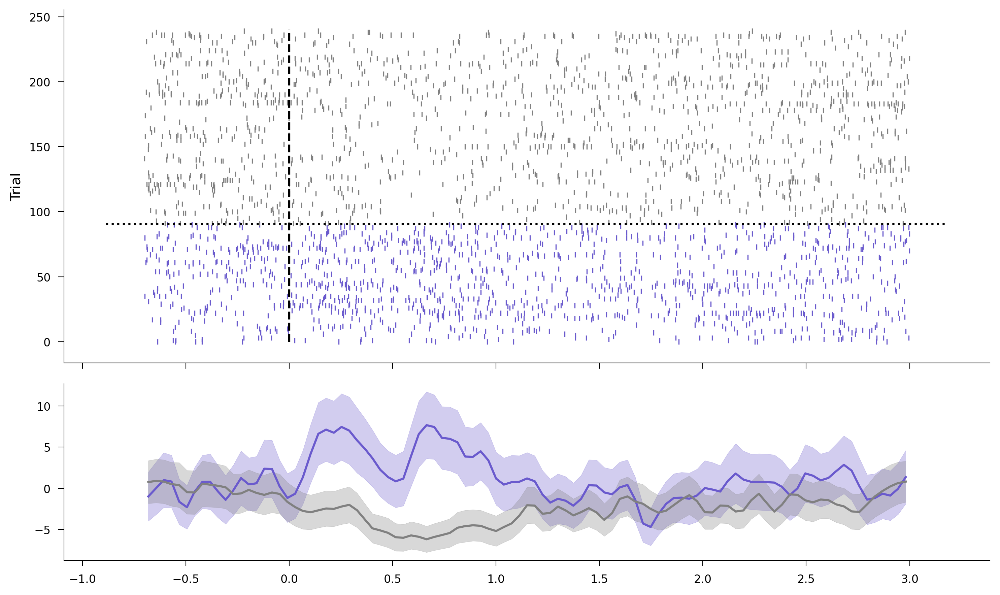

In [ ]:
# Figure S17D:

timeframe = 'full'
window_of_interest = {'full':[-0.7, 3]}
spiking_metric = 'evoked_fr'

bins = np.linspace(*window_of_interest[timeframe], 100)  # 100 bins
bin_centers = 0.5 * (bins[1:] + bins[:-1])

for x in [25]:
    x = int(x)
    st_s = all_spikes[x]/1000
    
    subject_df = all_encoding_df[all_encoding_df.subj==subj].sort_values(by=['time'])

    encoding_time_in_neural_time = [(x*sync_data.slope[sync_data.subj==subj] + sync_data.offset[sync_data.subj==subj]).values for x in subject_df.time]
    
    # create index of infield vs. outfield trials 
    field_df = field_res_df[field_res_df.cluster==x+1]
    infield_trials = np.where(field_df.infield==True)[0]
    outfield_trials = np.where(field_df.infield==False)[0]
    
    infield_raster = []
    outfield_raster = []
    for ix, event in enumerate(encoding_time_in_neural_time): 
        st_to_keep_event = np.where(np.logical_and(st_s>=event+window_of_interest[timeframe][0], 
                                                   st_s<=event+window_of_interest[timeframe][1]))[0].astype(int)
        # make raster array
        if ix in infield_trials:
            infield_raster.append(st_s[st_to_keep_event] - event)
        elif ix in outfield_trials:
            outfield_raster.append(st_s[st_to_keep_event] - event)
        
    fig, (ax_raster, ax_psth) = plt.subplots(2, 1, figsize=(10, 6), sharex=True,
                                             gridspec_kw={'height_ratios': [2, 1]})
    
    # --- Raster Plot ---
    for i, trial in enumerate(infield_raster):
        ax_raster.eventplot(trial, lineoffsets=i, color=colors_dict['EC'], linelengths=4, linewidths=0.8)
    for i, trial in enumerate(outfield_raster):
        ax_raster.eventplot(trial, lineoffsets=i + len(infield_raster), color='gray', linelengths=4, linewidths=0.8)

    ax_raster.set_ylabel('Trial')
    # ax_raster.set_title(f'Subj: {subj} | Cell: {cell_count} | Region: {channel_loc}')
    ax_raster.vlines(0, 0, len(infield_raster) + len(outfield_raster), linestyles='dashed', colors='black')

    # Optional: separator between infield and outfield trials
    ax_raster.hlines(len(infield_raster)-0.5, *ax_raster.get_xlim(), linestyle='dotted', color='black')

    # --- PSTH Plot ---
    def compute_psth_and_sem(raster, bins):
        bin_width = np.diff(bins)[0]
        n_trials = len(raster)
        binned_counts = np.zeros((n_trials, len(bins) - 1))

        for i, trial_spikes in enumerate(raster):
            counts, _ = np.histogram(trial_spikes, bins=bins)
            binned_counts[i, :] = counts / bin_width  # firing rate per trial (Hz)

        mean_psth = np.mean(binned_counts, axis=0)
        sem_psth = np.std(binned_counts, axis=0, ddof=1) / np.sqrt(n_trials)

        # Smooth both mean and SEM
        mean_psth_smoothed = gaussian_filter1d(mean_psth, sigma=1)
        sem_psth_smoothed = gaussian_filter1d(sem_psth, sigma=1)

        return mean_psth_smoothed, sem_psth_smoothed


    # Get PSTHs and SEMs
    mean_in, sem_in = compute_psth_and_sem(infield_raster, bins)
    mean_out, sem_out = compute_psth_and_sem(outfield_raster, bins)

    # Plot Infield
    zmean_in = ((mean_in - np.mean(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist() )  ) / (np.std(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist()) ))
    zsem_in = (sem_in  / (np.std(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist()) ))
    ax_psth.plot(bin_centers, zmean_in,
                 label='Infield', color=colors_dict['EC'])
    ax_psth.fill_between(bin_centers, zmean_in - zsem_in, zmean_in + zsem_in,
                         color=colors_dict['EC'], alpha=0.3)

    # Plot Outfield
    zmean_out = ((mean_out - np.mean(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist() )  ) / (np.std(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist()) ))
    zsem_out = (sem_out / (np.std(mean_in[np.where(bin_centers<=0)[0]].tolist() + mean_out[np.where(bin_centers<=0)[0]].tolist()) ))

    ax_psth.plot(bin_centers, zmean_out, 
                 label='Outfield', color='gray')
    ax_psth.fill_between(bin_centers, zmean_out - zsem_out, zmean_out + zsem_out,
                         color='gray', alpha=0.3)

    # Finalize and save
    fig.tight_layout()

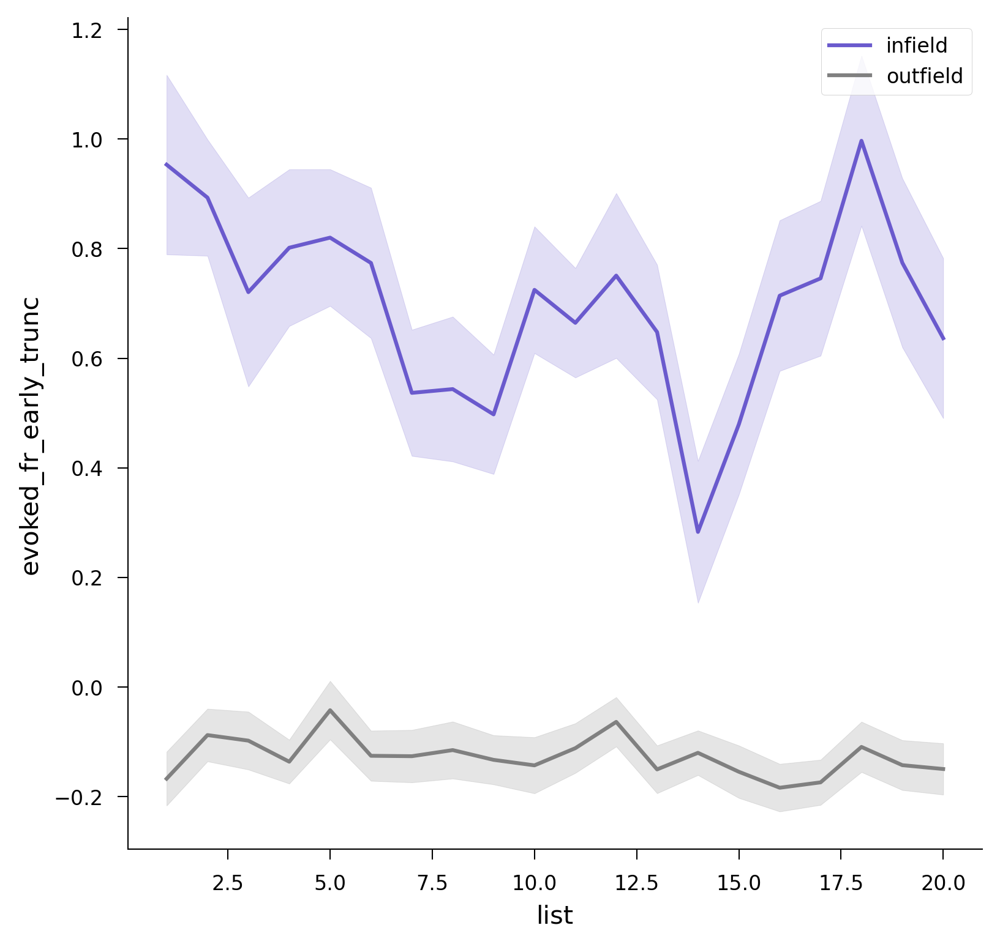

In [ ]:
# Figure S17E:
# Temporal stability: 

f,ax = plt.subplots(1, 1, dpi=300, figsize=(6,6)) 
        
sns.lineplot(data=field_res_df[(field_res_df.region=='EC') & (field_res_df.grid_cell==True) & (field_res_df.infield==1)],
             x='list', y='evoked_fr_early_trunc', label='infield', color=colors_dict['EC'], errorbar='se')
sns.lineplot(data=field_res_df[(field_res_df.region=='EC') & (field_res_df.grid_cell==True) & (field_res_df.infield==0)],
             x='list', y='evoked_fr_early_trunc', label='outfield', color='gray', errorbar='se')
plt.legend()


Text(0.5, 0, 'BIC diff (reduced - full)')

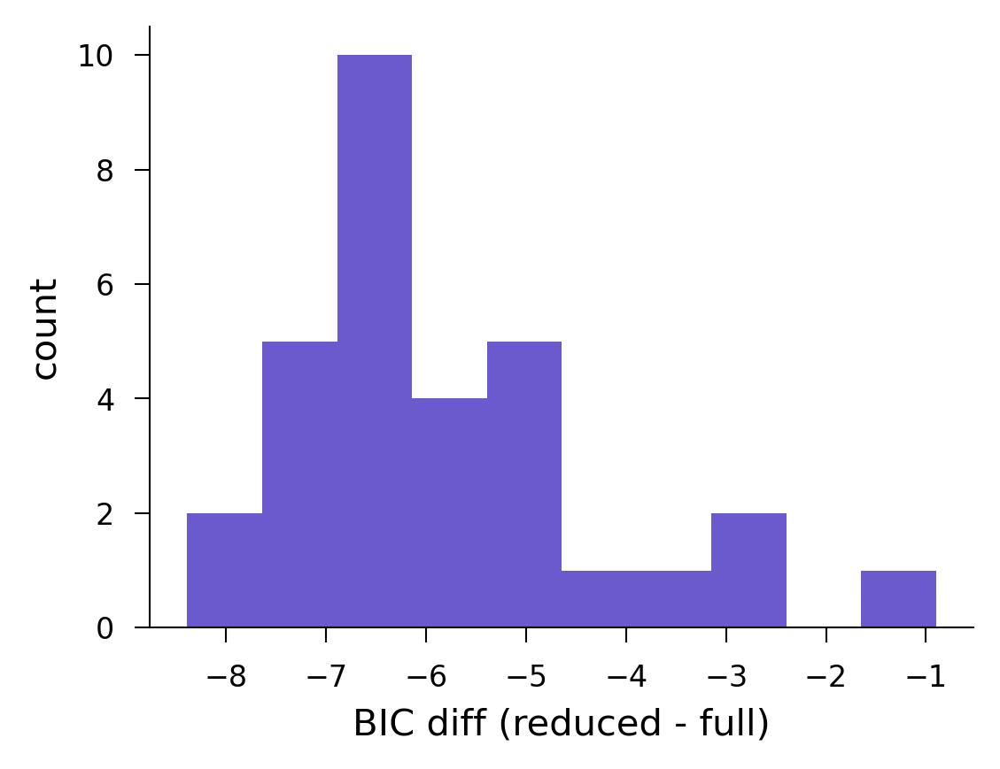

In [ ]:
# Figure S17F: 

field_res_df['raw_trial'] = field_res_df['image_num'] * field_res_df['list']
field_res_df['tercile_block'] = np.floor(field_res_df['raw_trial'] /81)

# all_trial_res['infield_vs_outfield_by_list'] = np.nan
# betas = []
bic_diffs = []
for cluster in field_res_df[(field_res_df.region=='EC') & (field_res_df.grid_cell==1) & (field_res_df.cluster!=542)].cluster.unique(): 

    full_model = smf.ols("evoked_fr_early_trunc ~ 1 + C(tercile_block)",
                    field_res_df[(field_res_df.infield==True) & (field_res_df.cluster==cluster)]).fit()
    reduced_model = smf.ols("evoked_fr_early_trunc ~ 1 ",
                    field_res_df[(field_res_df.infield==True) & (field_res_df.cluster==cluster)]).fit()
    bic_diff = reduced_model.bic - full_model.bic
    bic_diffs.append(bic_diff)
    
plt.hist(bic_diffs, color = colors_dict['EC'])
plt.ylabel('count')
plt.xlabel('BIC diff (reduced - full)')
  

# Entorhinal grid-like neurons are linked to memory encoding and recall.

### Encoding:

/var/folders/rs/5fd7r4bd4ps2x94n6d46k_t00000gn/T/ipykernel_1708/2300893206.py:23: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:k'` for the same effect.

  sns.pointplot(data=diff_df,


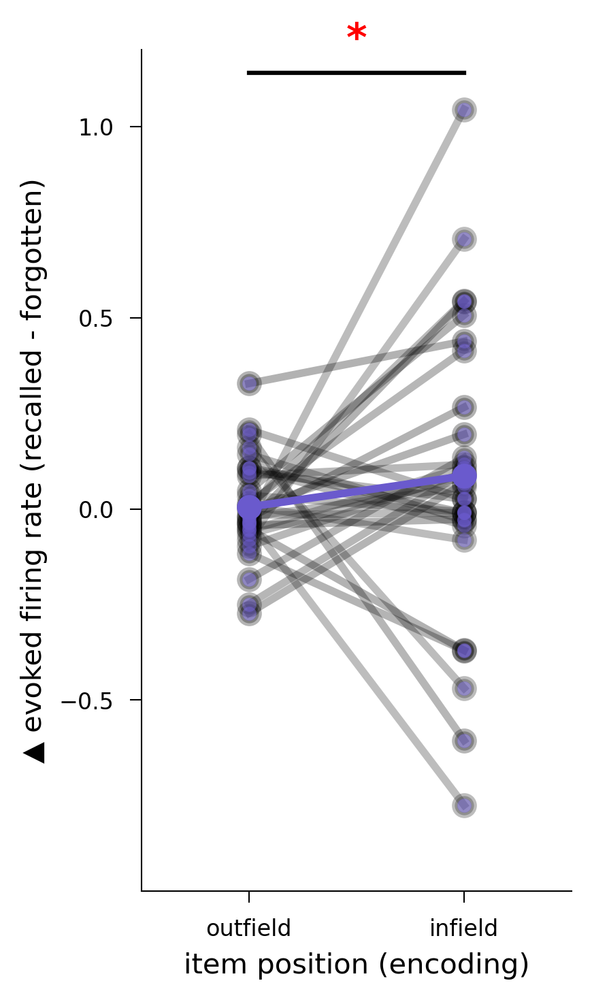

In [135]:
# Figure 4I: 
# Encoding: 

# Subset EC grid cells only
subdf = field_res_df[(field_res_df.region == 'EC') & (field_res_df.grid_cell == 1)]

# Compute infield - outfield difference per cluster × recalled
diff_df = (
    subdf
    .pivot_table(index=["cluster", "infield"], 
                 columns="recalled", 
                 values="evoked_fr_early_trunc", 
                 aggfunc="mean")
    .reset_index()
)

# Make sure columns are labeled clearly
diff_df["recalled_minus_forgotten"] = diff_df[1] - diff_df[0]   # assumes infield is coded 0/1

f, ax =  plt.subplots(1, 1, figsize=[3,5], dpi=300) # scatter_plt, 


sns.pointplot(data=diff_df, 
            x='infield', 
            y='recalled_minus_forgotten', 
            hue='cluster',
            errorbar=None, color='k', ax=ax)
plt.setp(ax.collections, alpha=0) #for the markers
plt.setp(ax.lines, alpha=.3)       #for the lines

sns.stripplot(data=diff_df, 
            x='infield', 
            y='recalled_minus_forgotten', 
              dodge=True,
             jitter=False, 
             alpha=0.5,
             color=colors_dict['EC'])

sns.pointplot(data=diff_df, 
            x='infield', 
            y='recalled_minus_forgotten', 
            errorbar=None, color=colors_dict['EC'], ax=ax)

plt.legend([],[], frameon=False)

# Set x-axis ticks to "outfield" and "infield"
ax.set_xticks([0, 1])
ax.set_xticklabels(['outfield', 'infield'])

# Set y-axis ticks
ax.set_yticks([-0.5, 0, 0.5, 1.0])
ax.set_ylim([-1, 1.2])  # Adjust limits to accommodate significance bar

# Add significance line and asterisk at the top
y_max = ax.get_ylim()[1]
ax.plot([0, 1], [y_max * 0.95, y_max * 0.95], 'k-', linewidth=1.5)  # Horizontal black line
ax.text(0.5, y_max * 0.98, '*', ha='center', va='bottom', color='red', fontsize=14, fontweight='bold')
ax.set_xlim([-0.5, 1.5])  # Adjust limits to accommodate significance bar

sns.despine()

# Update labels
plt.ylabel("▲ evoked firing rate (recalled - forgotten)")
plt.xlabel("item position (encoding)")
# Remove title
plt.title("")
plt.tight_layout()




### Retrieval:

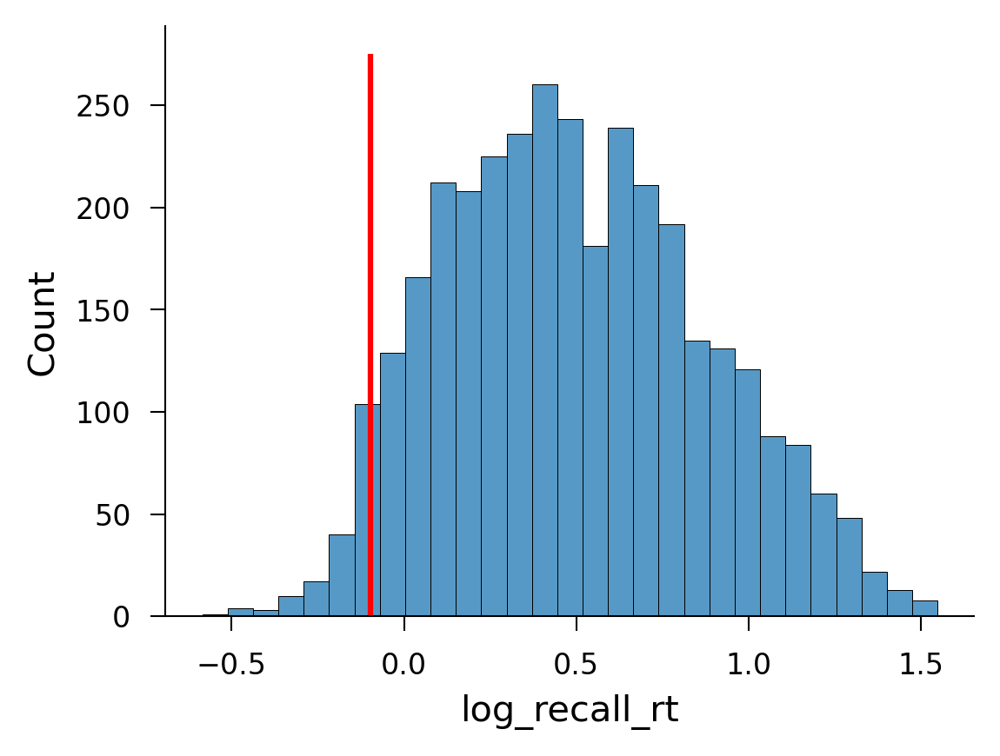

In [ ]:
# Figure 5B:

all_retrieval_df['log_recall_rt'] = np.log10(all_retrieval_df['time_between_recalls'])
sns.histplot(data=all_retrieval_df, x='log_recall_rt')
plt.vlines(np.log10(0.8), 0, 275)

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: Mean of empty slice
  This is separate from the ipykernel package so we can avoid doing imports until


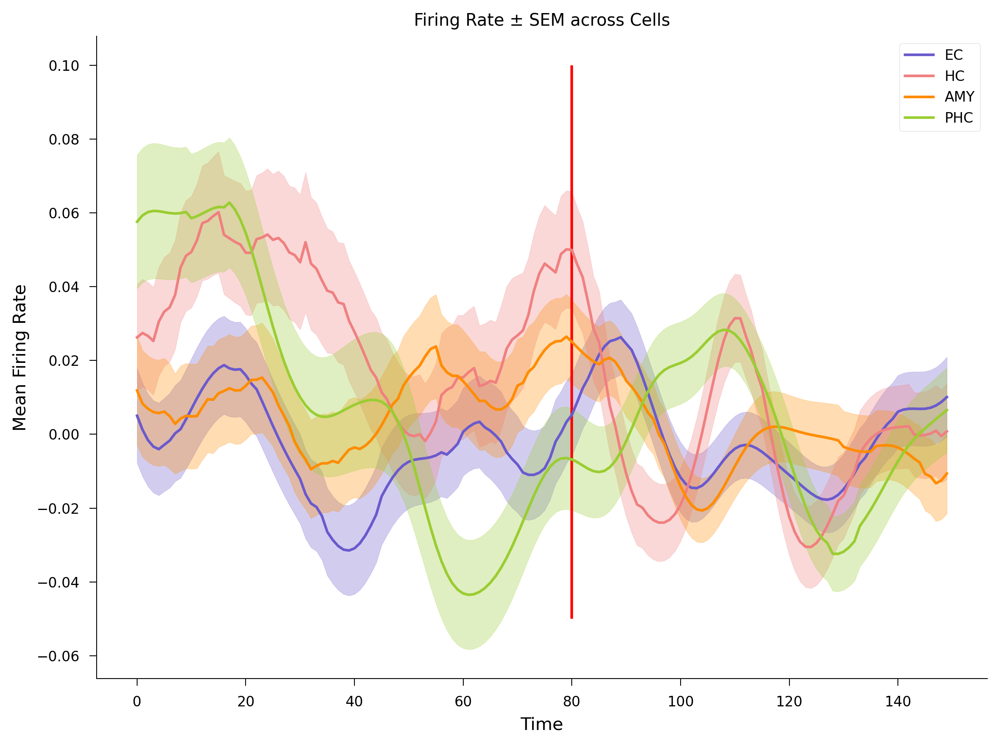

In [ ]:
# Figure 5C: requires computing smoothed firing rates for each region (not provided here)

#  smoothed_frs = {'EC': [],
#                 'AMY': [], 
#                 'HC': [], 
#                 'PHC': []}
# for cluster, region in zip(all_cell_num, all_channel_loc):
#     if region == 'TP':
#         continue
#     x = cluster -1
#     zscored_fr_ev = mne.read_epochs(f'/home1/salman.qasim/Salman_Project/FR_Emotion_Lukas/EmotionGrids/Results/scratch/cluster{x}_epochFR_RETRIEVAL.fif')
#     # Remove wild outliers (mroe prevalent due to the increased sparsity of spiking during retrieval)
#     zscored_fr_ev._data[np.isinf(zscored_fr_ev)] = np.nan
#     zscored_fr_ev._data[np.abs(zscored_fr_ev._data>50)] = np.nan
#     smoothed_frs[region].append(zscored_fr_ev._data)
z
# def compute_cellwise_mean_sem(cell_list):
#     # Step 1: average within each cell (trials x time → 1D: mean over trials)
#     cell_means = np.array([np.nanmean(cell, axis=0) for cell in cell_list])  # shape: [n_cells, n_timepoints]
    
#     # Step 2: compute mean and SEM across cells
#     mean = np.nanmean(cell_means, axis=0)
#     sem = np.nanstd(cell_means, axis=0) / np.sqrt(np.sum(~np.isnan(cell_means), axis=0))
#     return mean, sem

# # Compute for each region
# PHC_mean, PHC_sem = compute_cellwise_mean_sem(smoothed_frs['PHC'])
# EC_mean, EC_sem   = compute_cellwise_mean_sem(smoothed_frs['EC'])
# AMY_mean, AMY_sem = compute_cellwise_mean_sem(smoothed_frs['AMY'])
# HC_mean, HC_sem   = compute_cellwise_mean_sem(smoothed_frs['HC'])

# # X-axis
# time = np.arange(EC_mean.shape[1])

# # Plot
# plt.figure(figsize=(8, 6))
# for mean, sem, label in zip(
#     [EC_mean, HC_mean, AMY_mean, PHC_mean],
#     [EC_sem, HC_sem, AMY_sem, PHC_sem],
#     ['EC', 'HC', 'AMY', 'PHC']
# ):
#     mean = np.squeeze(mean)
#     sem = np.squeeze(sem)
#     color = colors_dict[label]
#     plt.plot(time, mean, label=label, color=color)
#     plt.fill_between(time, mean - sem, mean + sem, color=color, alpha=0.3)

# # Vertical marker
# plt.vlines(80, -0.05, 0.1, 'r')

# # Final touches
# plt.legend()
# sns.despine()
# plt.xlabel("Time")
# plt.ylabel("Mean Firing Rate")
# plt.title("Firing Rate ± SEM across Cells")
# plt.tight_layout()

In [91]:
# Load retrieval firing rates
retrieval_firing_rate = pd.read_csv(f'{datapath}/retrieval_fr_df_public.csv')


In [92]:
# Make reactivation df 
all_res_df = pd.read_csv(f'{datapath}/all_cells_regress_public.csv')

all_res_df = all_res_df.reset_index(drop=True)

# restrict to early window
all_res_df = all_res_df[(all_res_df.encoding_window=='early')]

# get rid of Intercept
all_res_df = all_res_df[all_res_df.predictor!='Intercept']

min_idx = all_res_df.groupby('cluster')['z_p'].idxmin()
strongest_predictor_df = all_res_df.loc[min_idx].reset_index(drop=True)
strongest_predictor_df['z_beta'] = np.abs(strongest_predictor_df['z_beta'])

plot_df = strongest_predictor_df.merge(condensed_df, on=['subj_id', 'sess_id','region','cluster'])[['cluster', 'arousal', 'valence', 'grid_cell', 'region']]
plot_df.rename(columns={'arousal':'arousal_tuning', 'valence':'valence_tuning'}, inplace=True)


In [93]:
merged_df_retrieval = field_res_df.merge(retrieval_firing_rate, on=['subj_id', 'sess_id', 'region', 'cluster', 'time_between_recalls','image_name'])
merged_df_retrieval = merged_df_retrieval[merged_df_retrieval.time_between_recalls>=0.8]



In [94]:
def corr_per_cluster(df):
    subj = df['sess_id'].iloc[0]
    region = df['region'].iloc[0]
    cluster = df['cluster'].iloc[0]

    sum_early = df['trial_nspikes_encoding_early_trunc'].sum()
    sum_retr = df['trial_nspikes_retrieval'].sum()
    n_pairs = len(df)

    # Default to NaN
    r = np.nan

    # Only compute correlation if thresholds are met
    if (sum_early >= 24) and (sum_retr >= 24) and (n_pairs >= 2):
        r = df['evoked_fr_early_trunc'].corr(df['evoked_fr_retrieval'])

    return pd.Series({
        'cluster': cluster,
        'subj': subj,
        'region': region,
        'pearson_r': r,
        'n_pairs': n_pairs,
        'sum_spikes_early': sum_early,
        'sum_spikes_retrieval': sum_retr
    })

correlation_df = (
    merged_df_retrieval
    .groupby('cluster', group_keys=False)
    .apply(corr_per_cluster)
    .reset_index(drop=True)
)

<AxesSubplot:xlabel='region', ylabel='pearson_r'>

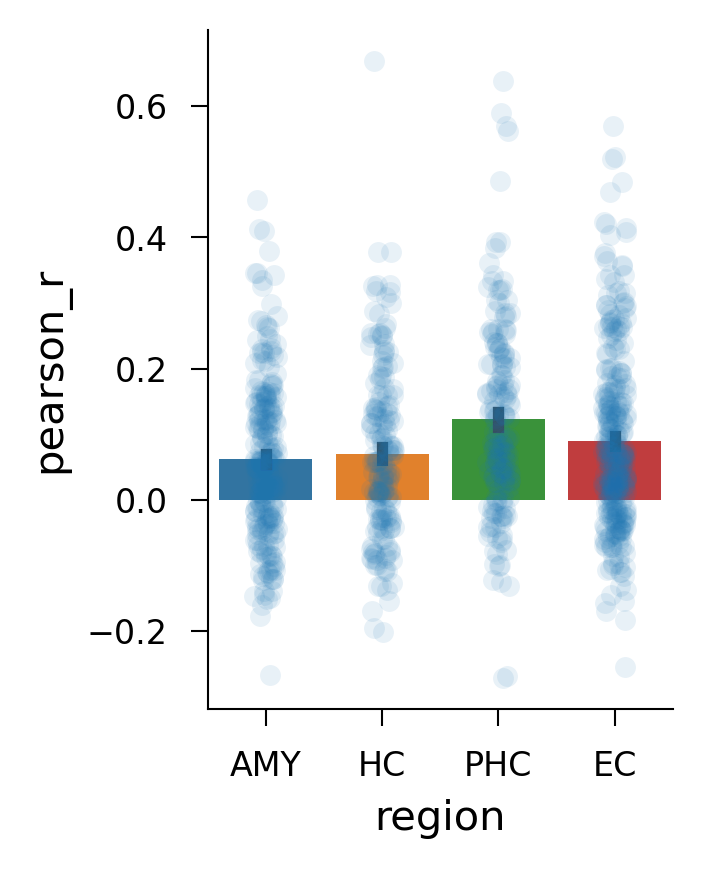

In [ ]:
# Figure 5D: 

f, ax = plt.subplots(1,1, figsize=[2,3], dpi=300)

sns.barplot(data=correlation_df[correlation_df.region!='TP'], 
            x='region', 
            y='pearson_r',
            errorbar = 'se', order=['AMY', 'HC', 'PHC', 'EC'])

sns.stripplot(data=correlation_df[correlation_df.region!='TP'], 
            x='region', 
            y='pearson_r',
             jitter=True, 
             alpha=0.1, order=['AMY', 'HC', 'PHC', 'EC'])

<AxesSubplot:xlabel='grid_cell', ylabel='pearson_r'>

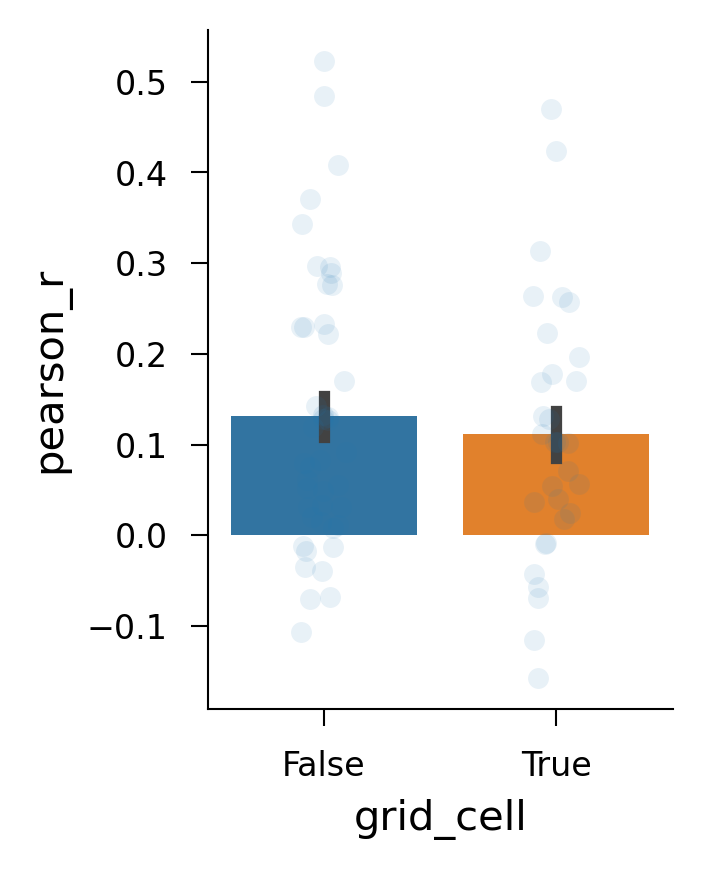

In [ ]:
# Figure 5E: 
grid_encoding_retrieval_corr = condensed_df[(condensed_df.grid_cell==1) & (condensed_df.region=='EC')].merge(correlation_df)
nongrid_encoding_retrieval_corr = plot_df[(plot_df.grid_cell==0) & (plot_df.region=='EC') & ((plot_df.arousal_tuning==1) | (plot_df.valence_tuning==1))].merge(correlation_df)

total_df = pd.concat([grid_encoding_retrieval_corr, nongrid_encoding_retrieval_corr]).reset_index()

f, ax = plt.subplots(1,1, figsize=[2,3], dpi=300)

sns.barplot(data=total_df, 
            x='grid_cell', 
            y='pearson_r',
            errorbar = 'se')

sns.stripplot(data=total_df, 
            x='grid_cell', 
            y='pearson_r',
             jitter=True, 
             alpha=0.1)

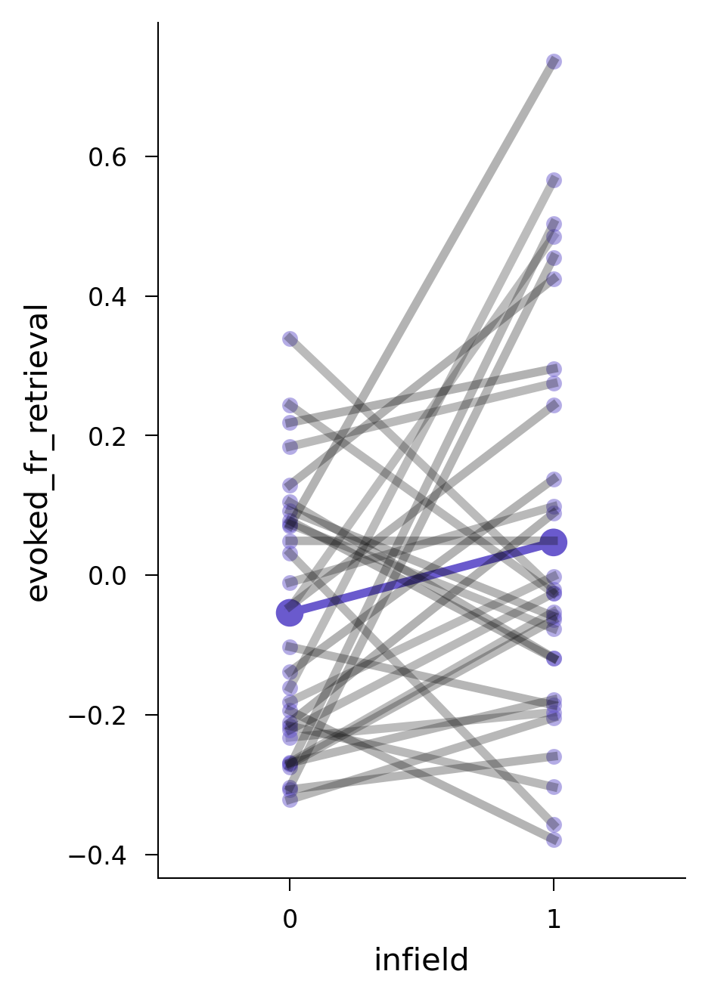

In [ ]:
# Figure 5G:

f, ax =  plt.subplots(1, 1, figsize=[3,5], dpi=300) # scatter_plt, 


sns.pointplot(data=merged_df_retrieval[(merged_df_retrieval.region=='EC') & (merged_df_retrieval.grid_cell==1)].dropna(subset=['evoked_fr_retrieval']), 
            x='infield', 
            y='evoked_fr_retrieval', 
            hue='cluster',
            errorbar=None, color='k', ax=ax)
plt.setp(ax.collections, alpha=0) #for the markers
plt.setp(ax.lines, alpha=.3)       #for the lines

sns.stripplot(data=merged_df_retrieval[(merged_df_retrieval.region=='EC') & (merged_df_retrieval.grid_cell==1)].dropna(subset=['evoked_fr_retrieval']).groupby(['cluster', 'infield']).mean(numeric_only=True).reset_index(), 
            x='infield', 
            y='evoked_fr_retrieval', 
              dodge=True,
             jitter=False, 
             alpha=0.5,
             color=colors_dict['EC'])

sns.pointplot(data=merged_df_retrieval[(merged_df_retrieval.region=='EC') & (merged_df_retrieval.grid_cell==1)].dropna(subset=['evoked_fr_retrieval']), 
            x='infield', 
            y='evoked_fr_retrieval', 
            errorbar=None, color=colors_dict['EC'], ax=ax)

plt.legend([],[], frameon=False)


sns.despine()

In [249]:
# mixed_model_reactivation = smf.mixedlm('evoked_fr_retrieval ~ 1 + C(infield)', 
#                                        data=merged_df_retrieval[(merged_df_retrieval.region=='EC') & (merged_df_retrieval.grid_cell==1)].dropna(subset=['evoked_fr_retrieval']), 
#             groups='sess_id').fit(reml=True)
# mixed_model_reactivation.summary()

# Entorhinal grid-like neurons exhibit theta-phase locking.

In [97]:
psds = np.load(f'{datapath}/psds.npz')
psds = [psds[key] for key in psds.files]
freqs = np.load(f'{datapath}/freqs.npz')
freqs = [freqs[key] for key in freqs.files]

([<matplotlib.axis.XTick at 0x2ac917304bd0>,
 [Text(0.3010299956639812, 0, '2'),
  Text(1.0, 0, '10'),
  Text(1.4771212547196624, 0, '30')])

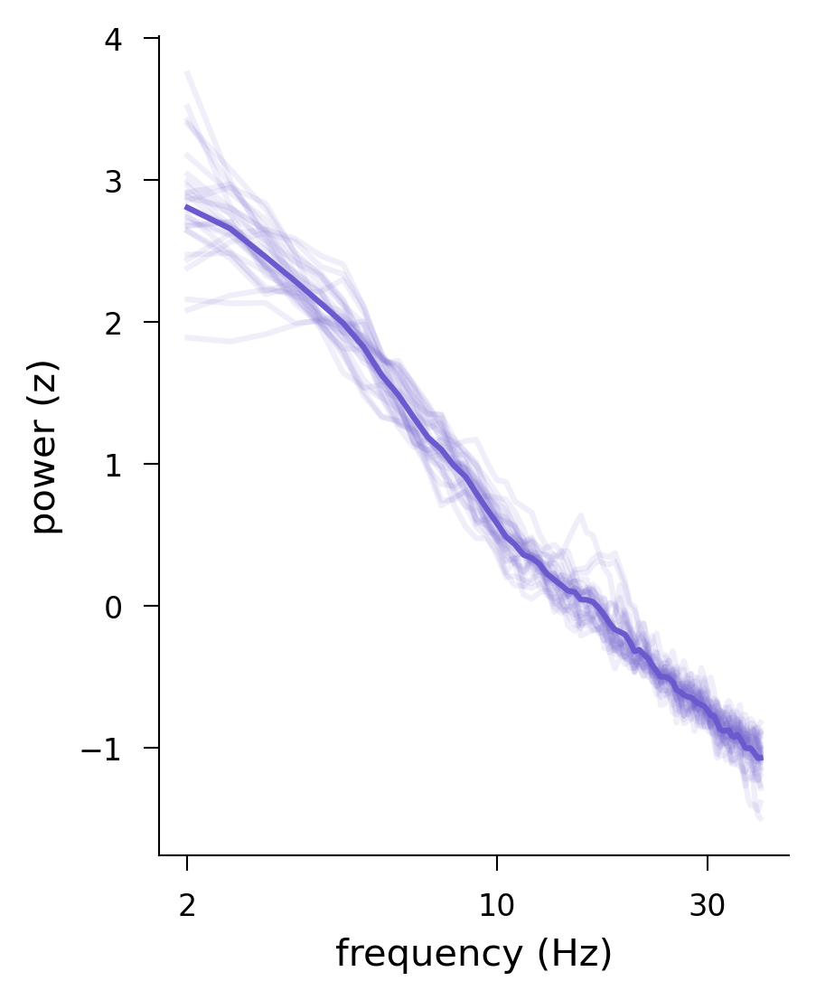

In [ ]:
# Figure 6A: 

f, ax = plt.subplots(1,1, figsize=[3,4], dpi=300)

freq_ix = np.where((freqs[0]>=2) & (freqs[0]<40))[0]

all_freqs = []
all_psds = []
for f, p in zip(freqs, psds): 
    zf = np.log10(f[freq_ix])
    zp = zscore(np.log10(p[freq_ix]))
    ax.plot(zf, zp, color=colors_dict['EC'], alpha=0.1)
    all_freqs.append(zf)
    all_psds.append(zp)
    
mean_psd = np.mean(np.vstack(all_psds), axis=0)
ax.plot(zf, mean_psd, color=colors_dict['EC'])
ax.set(xlabel='frequency (Hz)', ylabel='power (z)')

real_ticks = [2, 10, 30]  # or any other values
log_ticks = np.log10(real_ticks)

# Set the log-scale tick positions and label them in real space
plt.xticks(log_ticks, [str(tick) for tick in real_ticks])

In [ ]:
# Figure 6B: Raw LFP traces for examples are not provided here
# enc_lfp = [] 
# event_spikes = []
# for event in encoding_time_in_neural_time:
#     start_ix = np.floor(((event + window_of_interest[timeframe][0]) * 1000) / (1000/fs)).astype(int)[0]
#     end_ix = np.ceil(((event + window_of_interest[timeframe][1]) * 1000) / (1000/fs)).astype(int)[0]
#     enc_lfp.append(lfp_data[start_ix:end_ix])

#     st_to_keep_event = np.where(np.logical_and(st_s>=event+window_of_interest[timeframe][0], 
#                                            st_s<=event+window_of_interest[timeframe][1]))[0].astype(int)
#     event_spikes.append(st_s[st_to_keep_event])

#     # make a plot for the spike phase-coupling 
#     eventized_spike = ((st_s[st_to_keep_event]*(1000)/(1000/fs)) - start_ix).astype(int)

#     # Create a new figure without displaying it
#     fig, ax = plt.subplots()
#     ax.plot( [start_ix:end_ix])
#     for spk in eventized_spike:
#         ax.vlines(spk, theta_lfp[start_ix:end_ix].min(), 
#                   theta_lfp[start_ix:end_ix].max(), color='red')
s

In [104]:
phase_dfs = pd.read_csv(f'{datapath}/phase_df_public.csv')


In [108]:
# Make reactivation df 
all_res_df = pd.read_csv(f'{datapath}/all_cells_regress_public.csv')

all_res_df = all_res_df.reset_index(drop=True)

# restrict to early window
all_res_df = all_res_df[(all_res_df.encoding_window=='early')]

# get rid of Intercept
all_res_df = all_res_df[all_res_df.predictor!='Intercept']

min_idx = all_res_df.groupby('cluster')['z_p'].idxmin()
strongest_predictor_df = all_res_df.loc[min_idx].reset_index(drop=True)
strongest_predictor_df['z_beta'] = np.abs(strongest_predictor_df['z_beta'])

plot_df = strongest_predictor_df.merge(condensed_df, on=['subj_id', 'sess_id','region','cluster'])[['cluster', 'arousal', 'valence', 'grid_cell', 'region']]
plot_df.rename(columns={'arousal':'arousal_tuning', 'valence':'valence_tuning'}, inplace=True)


In [109]:
grid_ppc = condensed_df[(condensed_df.grid_cell==1) & (condensed_df.region=='EC')].merge(phase_dfs).zPPC.dropna().values
nongrid_ppc = plot_df[(plot_df.grid_cell==0) & (plot_df.region=='EC') & ((plot_df.arousal_tuning==1) | (plot_df.valence_tuning==1))].merge(phase_dfs).zPPC.dropna().values
# nongrid_ppc = condensed_df[(condensed_df.grid_cell==0) & (condensed_df.region=='EC')].merge(phase_dfs).zPPC.dropna().values
p_ppc = [1 - scipy.stats.norm.cdf(x) for x in grid_ppc]



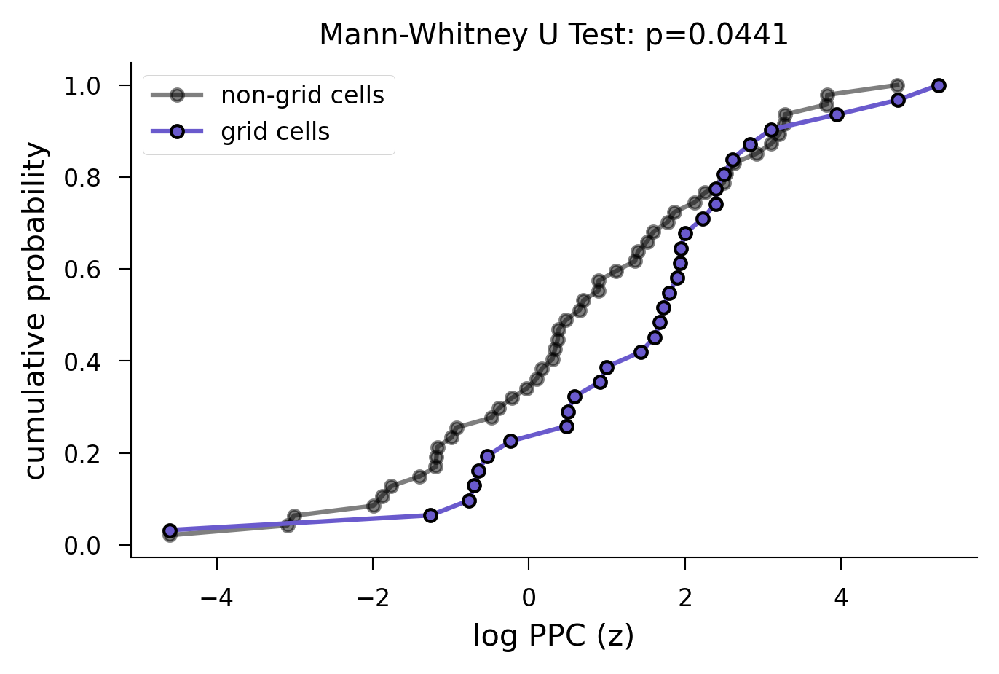

In [ ]:
# Figure 6C: 

r, p = mannwhitneyu(grid_ppc,
          nongrid_ppc, alternative='greater')

plt.figure(figsize=(5, 3), dpi=300)

# Compute empirical CDF
x1 = np.sort(grid_ppc - np.min(grid_ppc) + 0.01)
y1 = np.arange(1, len(x1) + 1) / len(x1)

x2 = np.sort(nongrid_ppc - np.min(nongrid_ppc)+ 0.01)
y2 = np.arange(1, len(x2) + 1) / len(x2)

# Plot ECDFs
plt.plot(np.log(x2), y2, marker='.', linestyle='-', label="non-grid cells", color='black', mec='black', mew=1, ms=8, alpha=0.5)
plt.plot(np.log(x1), y1, marker='.', linestyle='-', label="grid cells", color = colors_dict['EC'], mec='black', mew=1, ms=8)

# Annotate with p-value
plt.title(f'Mann-Whitney U Test: p={p:.3g}')
plt.xlabel("log PPC (z)")
plt.ylabel("cumulative probability")
plt.legend()
# plt.show()
sns.despine()

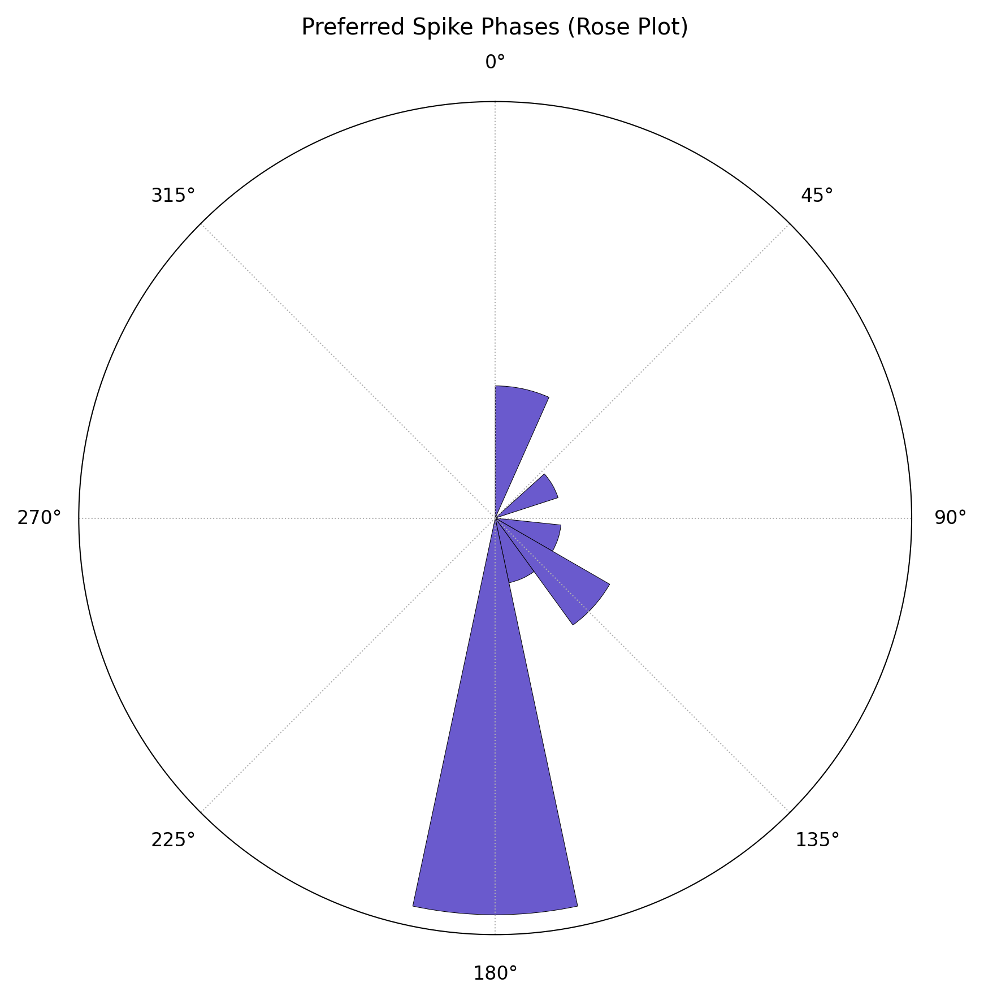

In [ ]:
# Figure 6C (inset):

preferred_phases = condensed_df[(condensed_df.grid_cell==1) & (condensed_df.region=='EC')].merge(phase_dfs).pref_phase.dropna().values

# Parameters
num_bins = 15
bin_edges = np.linspace(0, 2 * np.pi, num_bins + 1)
bin_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

# Histogram
counts, _ = np.histogram(preferred_phases, bins=bin_edges)

# Normalize (optional: to plot fraction rather than count)
counts = counts / counts.sum()

# Plot
fig = plt.figure(figsize=(6, 6))
ax = fig.add_subplot(111, polar=True)

bars = ax.bar(bin_centers, counts, width=(2*np.pi/num_bins), bottom=0.0, color=colors_dict['EC'], edgecolor='k', alpha=1)

# Optional aesthetics
ax.set_theta_zero_location("N")  # 0 at the top
ax.set_theta_direction(-1)       # clockwise
ax.set_title("Preferred Spike Phases (Rose Plot)", va='bottom')
ax.set_yticks([])                # hide radial ticks

plt.tight_layout()

# Entorhinal grid-like neurons do not generalize their tuning from valence-arousal space to other spaces.

###  Semantic space

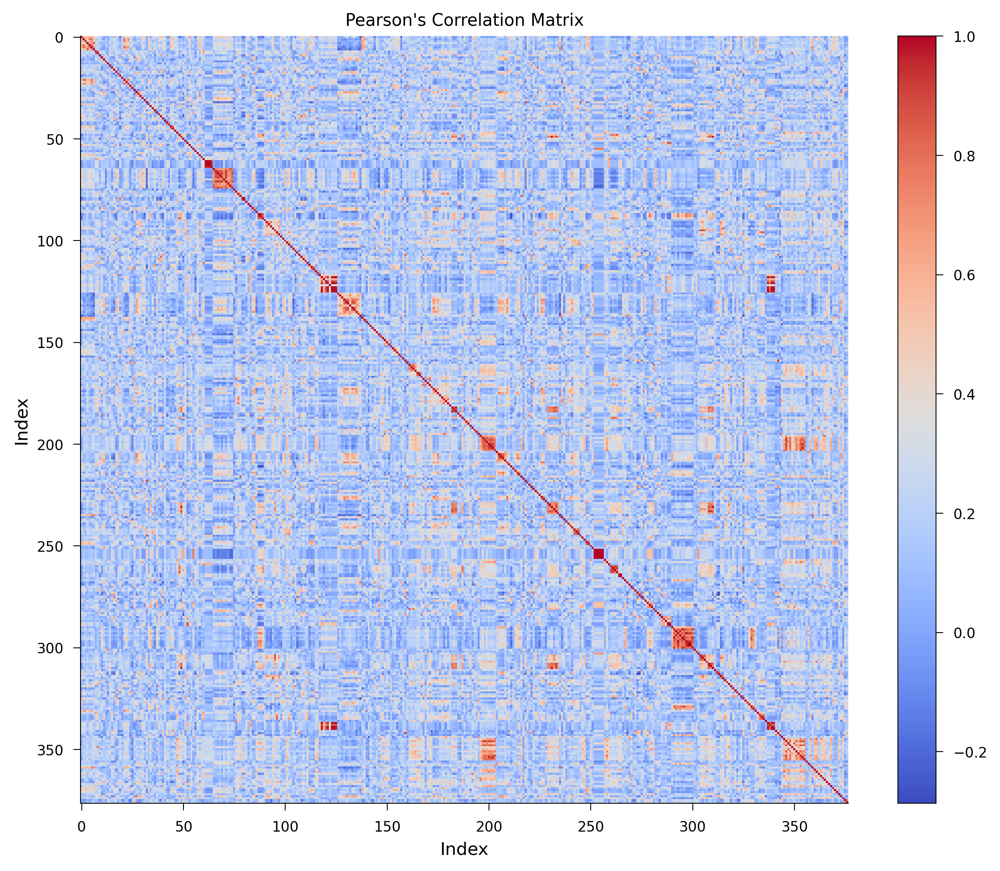

In [ ]:
# Figure 7B:
# Load the sentence embeddings: 

file_path = f'{datapath}/blip2_bert_embeddings.npz'

sentence_embeddings = np.load(file_path)

# Get a list of keys in the loaded_data object
keys_list = sentence_embeddings.files

# Sort the keys alphabetically
sorted_keys = sorted(keys_list)

# Create a new dictionary to store the sorted data
sorted_data = {}

# Populate the sorted_data dictionary with the sorted arrays
for key in sorted_keys:
    sorted_data[key] = sentence_embeddings[key]
   
stacked_array = []
for key in sorted_data.keys():
    stacked_array.extend(sorted_data[key])
stacked_array = np.stack(stacked_array)

# Calculate Pearson's correlation matrix
pearson_corr_matrix = np.corrcoef(stacked_array.T, rowvar=False)

# Plot the correlation matrix
plt.figure(figsize=(10, 8))
plt.imshow(pearson_corr_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.title("Pearson's Correlation Matrix")
plt.xlabel("Index")
plt.ylabel("Index")
plt.show()

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:13: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  del sys.path[0]
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:20: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

/home1/salman.qasim/mini

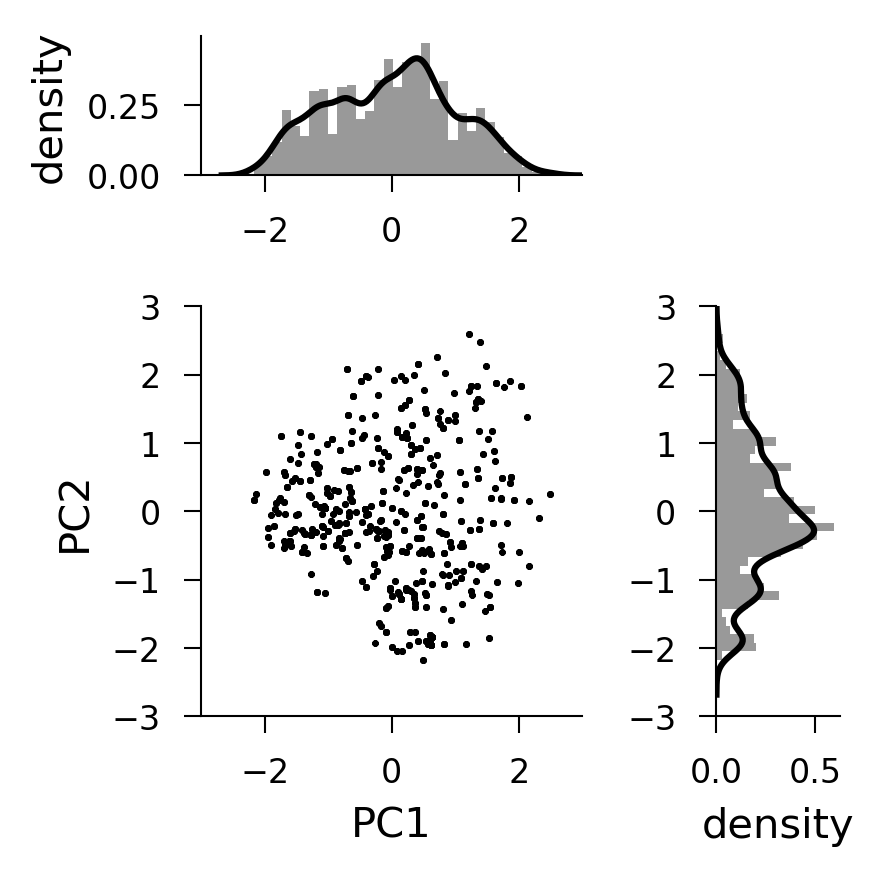

In [ ]:
# Figure 7C:

f = plt.figure(constrained_layout=True, figsize=[3,3]) # initialize the figure 
gs = f.add_gridspec(3, 3)
stat_plot_ax = f.add_subplot(gs[1:, :2])
x_dist_ax = f.add_subplot(gs[:1, :2], sharex = stat_plot_ax)
y_dist_ax = f.add_subplot(gs[1:, 2:], sharey = stat_plot_ax)

stat_plot_ax.plot(all_encoding_df.zPC1, all_encoding_df.zPC2, '.', color='black',  markersize=3)
stat_plot_ax.set_ylim([-3, 3])
stat_plot_ax.set_xlim([-3, 3])
stat_plot_ax.set_xlabel('PC1')
stat_plot_ax.set_ylabel('PC2')

sns.distplot(all_encoding_df.zPC1, ax=x_dist_ax, norm_hist=True, color='black')
x_dist_ax.set_xlabel('')
#     x_dist_ax.set_ylim([-3, 3])
x_dist_ax.set_ylabel('density')
# x_dist_ax.set_xticks([])
sns.despine()

sns.distplot(all_encoding_df.zPC2, ax=y_dist_ax, norm_hist=True, color='black', vertical=True)
#     y_dist_ax.set_xlim([-4.5, 4.5])
y_dist_ax.set_xlabel('density')
y_dist_ax.set_ylabel('')
# y_dist_ax.set_yticks([])
sns.despine()
f.tight_layout()

In [ ]:
def plot_2d_regression(x,y,z, plane_color='r'): 
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter3D(x, 
                 y, 
                 z, alpha = 0.05, color='k');


    n_samples = len(x)
    # Create the design matrix
    X = np.vstack((x, y)).T
    X = np.hstack((np.ones((n_samples, 1)), X))


    # Fit a linear regression model
    X = np.column_stack((x, y))
    reg = HuberRegressor().fit(X, z)
#     TheilSenRegressor

    # Get the coefficients of the plane
    a, b = reg.coef_
    c = reg.intercept_

    # Create a meshgrid to plot the plane
    x_plane, y_plane = np.meshgrid(np.linspace(-2, 2, 50), np.linspace(-2, 2, 50))
    z_plane = a * x_plane + b * y_plane + c
    
    # Calculate the residuals
    residuals = []
    z_pred = []
    for i in range(len(x)):
        z_predicted = a * x[i] + b * y[i] + c
        residual = z[i] - z_predicted
        z_pred.append(z_predicted)
        residuals.append(residual)
    r2 = r2_score(z, z_pred)

    # Plot the plane
    ax.plot_surface(x_plane, y_plane, z_plane, alpha=0.2, color=plane_color)
    ax.plot_wireframe(X=x_plane, Y=y_plane, Z=z_plane, rstride=5, cstride=3, linewidth=1, alpha = 1, color=plane_color)   # 3d plot

    points = [(a,b,c) for a,b,c in zip(x,y,z)]
    for ix, point in enumerate(points):
        xs = [point[0], point[0]]
        ys = [point[1], point[1]]
        zs = [point[2], point[2] - residuals[ix]]
        ax.plot(xs, ys, zs, color='k', alpha = 0.05)


    ax.view_init(30, -150)

    ax.set(xlabel='Valence', ylabel='Arousal')
    # Show the plot

    
    return a,b,r2


[Text(0.5, 0, 'Valence'),
 Text(0.5, 0, 'Arousal'),
 Text(0.5, 0.92, 'adjR2=0.16116100738160788')]

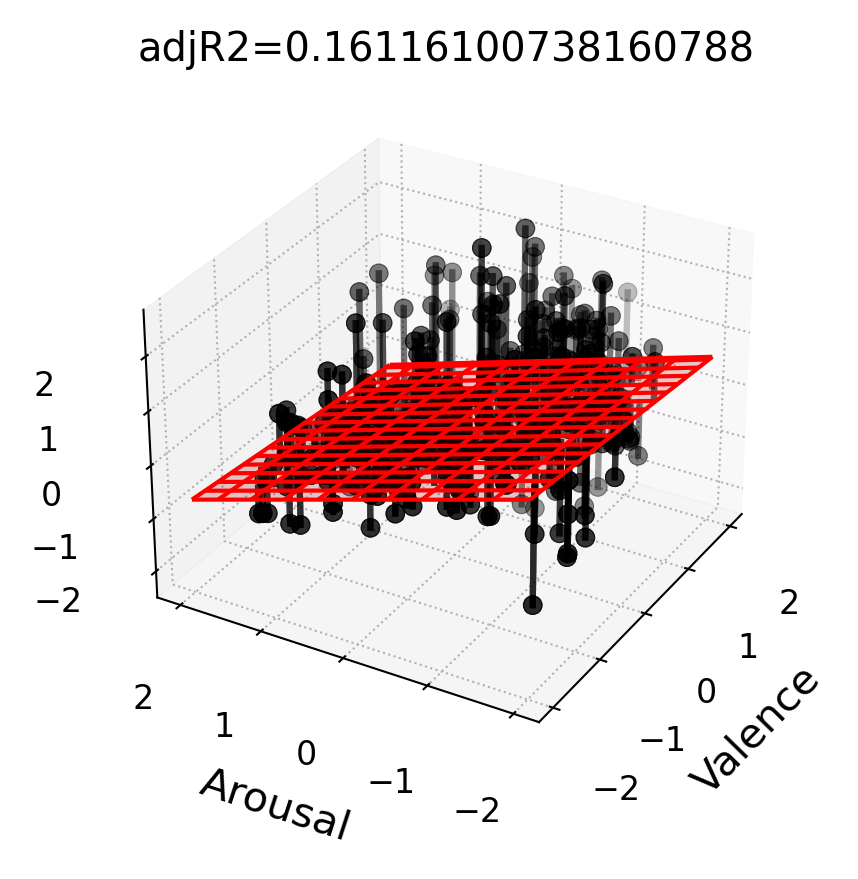

In [ ]:
# Figure 7D (left): 

x = all_encoding_df.zValence
y = all_encoding_df.zArousal
z = all_encoding_df.zPC1

plane_color = 'r'

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter3D(x, 
             y, 
             z, alpha = 0.05, color='k');


n_samples = len(x)
# Create the design matrix
X = np.vstack((x, y)).T
X = np.hstack((np.ones((n_samples, 1)), X))


# Fit a linear regression model
X = np.column_stack((x, y))
reg = HuberRegressor().fit(X, z)
#     TheilSenRegressor

# Get the coefficients of the plane
a, b = reg.coef_
c = reg.intercept_

# Create a meshgrid to plot the plane
x_plane, y_plane = np.meshgrid(np.linspace(-2, 2, 50), np.linspace(-2, 2, 50))
z_plane = a * x_plane + b * y_plane + c

# Calculate the residuals
residuals = []
z_pred = []
for i in range(len(x)):
    z_predicted = a * x[i] + b * y[i] + c
    residual = z[i] - z_predicted
    z_pred.append(z_predicted)
    residuals.append(residual)
r2 = r2_score(z, z_pred)

# Plot the plane
ax.plot_surface(x_plane, y_plane, z_plane, alpha=0.2, color=plane_color)
ax.plot_wireframe(X=x_plane, Y=y_plane, Z=z_plane, rstride=5, cstride=3, linewidth=1, alpha = 1, color=plane_color)   # 3d plot

points = [(a,b,c) for a,b,c in zip(x,y,z)]
for ix, point in enumerate(points):
    xs = [point[0], point[0]]
    ys = [point[1], point[1]]
    zs = [point[2], point[2] - residuals[ix]]
    ax.plot(xs, ys, zs, color='k', alpha = 0.05)


ax.view_init(30, -150)

ax.set(xlabel='Valence', ylabel='Arousal', title=f'adjR2={r2}')

[Text(0.5, 0, 'Valence'),
 Text(0.5, 0, 'Arousal'),
 Text(0.5, 0.92, 'adjR2=-0.0001131882234453041')]

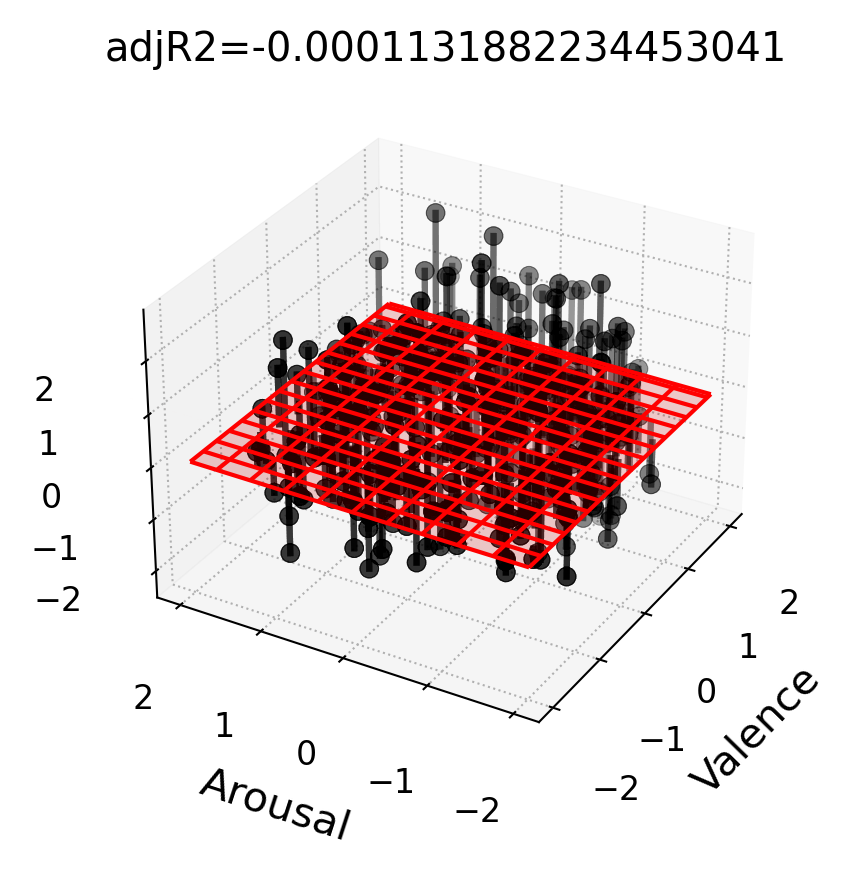

In [ ]:
# Figure 7D (right): 

x = all_encoding_df.zValence
y = all_encoding_df.zArousal
z = all_encoding_df.zPC2

plane_color = 'r'

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter3D(x, 
             y, 
             z, alpha = 0.05, color='k');


n_samples = len(x)
# Create the design matrix
X = np.vstack((x, y)).T
X = np.hstack((np.ones((n_samples, 1)), X))

from sklearn.linear_model import HuberRegressor
#     TheilSenRegressor

# Fit a linear regression model
X = np.column_stack((x, y))
reg = HuberRegressor().fit(X, z)
#     TheilSenRegressor

# Get the coefficients of the plane
a, b = reg.coef_
c = reg.intercept_

# Create a meshgrid to plot the plane
x_plane, y_plane = np.meshgrid(np.linspace(-2, 2, 50), np.linspace(-2, 2, 50))
z_plane = a * x_plane + b * y_plane + c

# Calculate the residuals
residuals = []
z_pred = []
for i in range(len(x)):
    z_predicted = a * x[i] + b * y[i] + c
    residual = z[i] - z_predicted
    z_pred.append(z_predicted)
    residuals.append(residual)
r2 = r2_score(z, z_pred)

# Plot the plane
ax.plot_surface(x_plane, y_plane, z_plane, alpha=0.2, color=plane_color)
ax.plot_wireframe(X=x_plane, Y=y_plane, Z=z_plane, rstride=5, cstride=3, linewidth=1, alpha = 1, color=plane_color)   # 3d plot

points = [(a,b,c) for a,b,c in zip(x,y,z)]
for ix, point in enumerate(points):
    xs = [point[0], point[0]]
    ys = [point[1], point[1]]
    zs = [point[2], point[2] - residuals[ix]]
    ax.plot(xs, ys, zs, color='k', alpha = 0.05)


ax.view_init(30, -150)

ax.set(xlabel='Valence', ylabel='Arousal', title=f'adjR2={r2}')

In [121]:
condensed_df_pc = pd.read_csv(f'{datapath}/condensed_df_pc_public.csv')
all_trial_res_pc = pd.read_csv(f'{datapath}/all_trial_pc_public.csv') 
                     
                         

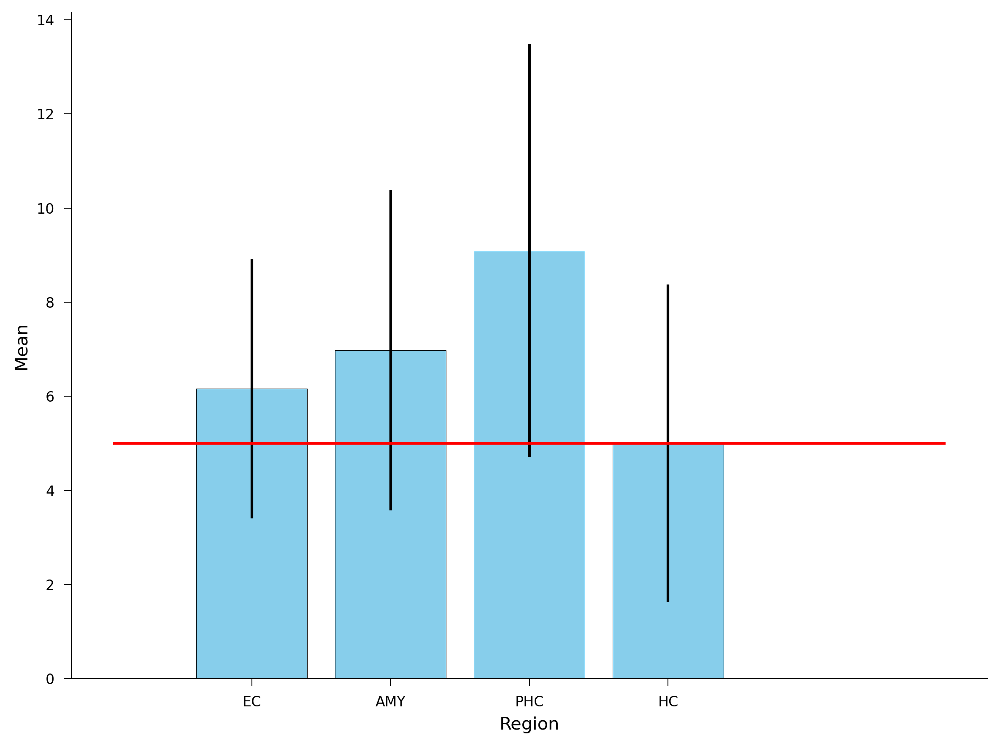

In [ ]:
# Figure 7E: 

significant_obs = condensed_df_pc[(condensed_df_pc.grid_cell==1)].region.value_counts()  # Number of significant observations
total_obs = condensed_df_pc[(condensed_df_pc.nspikes_total >= 100)].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, alternative='greater')
    # lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")


    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()

/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3602: RuntimeWarning: invalid value encountered in true_divide
  fr_map_smoothed=VV/WW
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:1021: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  return peaks, np.array(adjacents)
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: invalid value encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3685: RuntimeWarning: invalid value encountered in power
  (np.divide(np.square(sum_fr_map_smoothed), n_bins_sq))), 0.5)
/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils

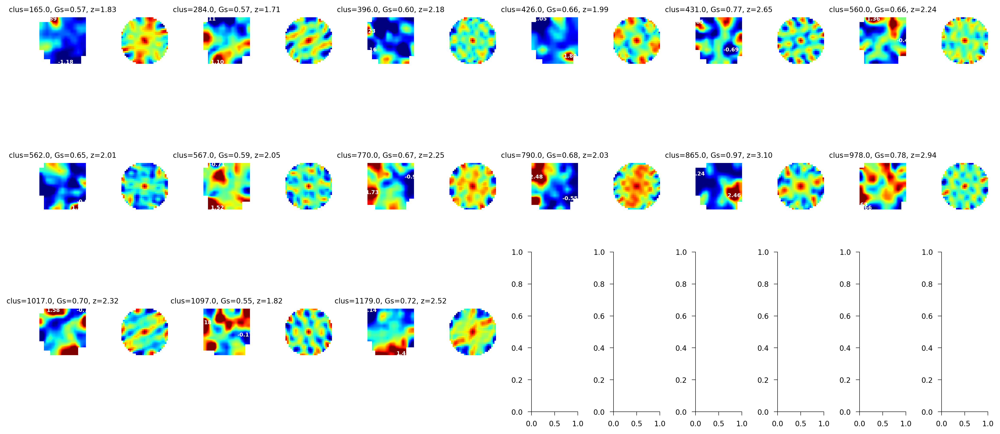

In [ ]:
# Figure 7F: 
# Set up parameters
nbins = 15
nrows, ncols = 3, 6
total_cells = nrows * ncols

# Limit to desired number of cells
cells_to_plot = condensed_df_pc[(condensed_df_pc.grid_cell==1) & ((condensed_df_pc.region=='PHC'))].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res_pc[
        (all_trial_res_pc.sess_id == cell.sess_id) &
        (all_trial_res_pc.region == cell.region) &
        (all_trial_res_pc.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['pc1'], nbins)
    y_bins = pd.cut(plot_df['pc2'], nbins)
    plot_df['pc1_binned'] = x_bins
    plot_df['pc2_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['pc1_binned', 'pc2_binned']).agg(
        {'evoked_fr_early_trunc': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('pc2_binned', 'pc1_binned', 'evoked_fr_early_trunc').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()

<AxesSubplot:xlabel='zGs_label_pc', ylabel='zGs_label_og'>

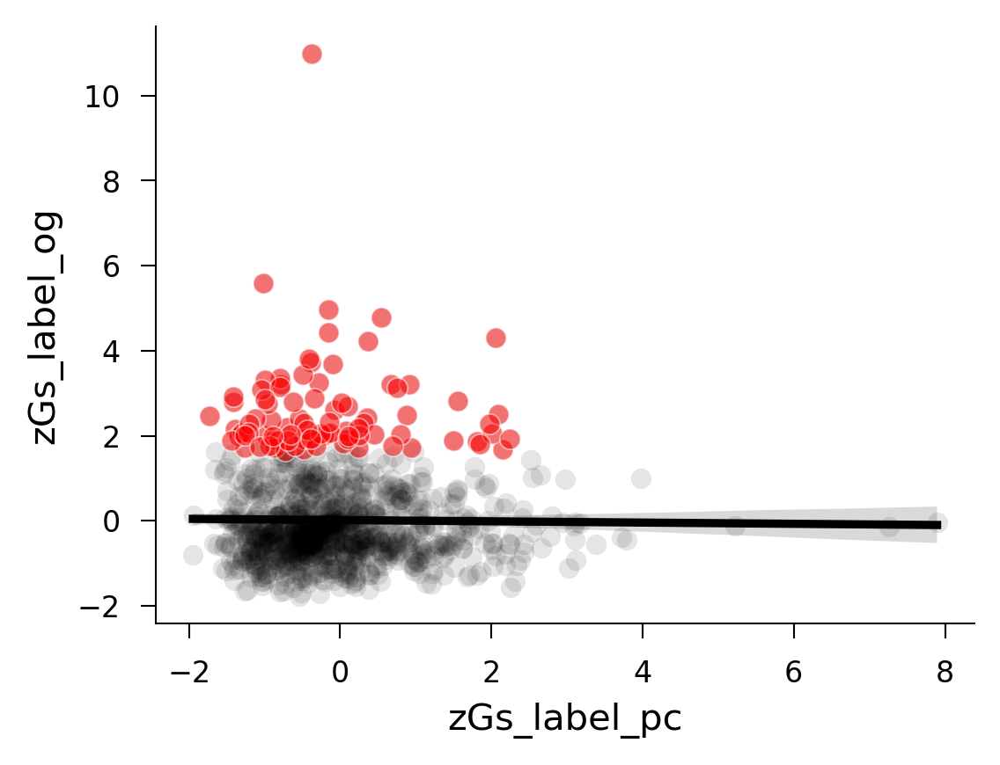

In [ ]:
# Figure 7G:
merged_pc_df = condensed_df_pc.merge(condensed_df, on=['subj_id', 'sess_id', 'region', 'cluster'], suffixes=['_pc', '_og'])

f,ax = plt.subplots(1, 1, dpi=300, figsize=(4,3))
sns.regplot(data=merged_pc_df, 
            x='zGs_label_pc',
            y='zGs_label_og', color ='k', scatter_kws={'alpha':0.1})
sns.scatterplot(data=merged_pc_df[merged_pc_df.computed_p_label_og<0.05], 
            x='zGs_label_pc',
            y='zGs_label_og', color ='red', alpha =0.5)



### Visual space

In [122]:
all_distractor_df = pd.read_csv(f'{datapath}/all_distractor_df_public.csv')

In [ ]:
# Correction for extreme rates (log-linear rule)
def corrected_rate(hits, total):
    # Prevents rates of exactly 0 or 1
    return (hits + 0.5) / (total + 1)

def compute_dprime(sub_df):
    # Hit Rate: response=1 when dot is red
    red_trials = sub_df[sub_df['dot_color'] == 'red']
    hits = np.sum(red_trials['dot_response'] == 1)
    n_red = len(red_trials)
    hit_rate = corrected_rate(hits, n_red)

    # FA Rate: response=1 when dot is white
    white_trials = sub_df[sub_df['dot_color'] == 'white']
    fas = np.sum(white_trials['dot_response'] == 1)
    n_white = len(white_trials)
    fa_rate = corrected_rate(fas, n_white)

    # Convert to Z-scores
    z_hit = norm.ppf(hit_rate)
    z_fa = norm.ppf(fa_rate)
    dprime = z_hit - z_fa
    return dprime

# Group by subject and compute d'
dprime_by_subj = all_distractor_df.groupby('sess_id').apply(compute_dprime).reset_index()
dprime_by_subj.columns = ['sess_id', 'dprime']

<AxesSubplot:xlabel='dprime', ylabel='Count'>

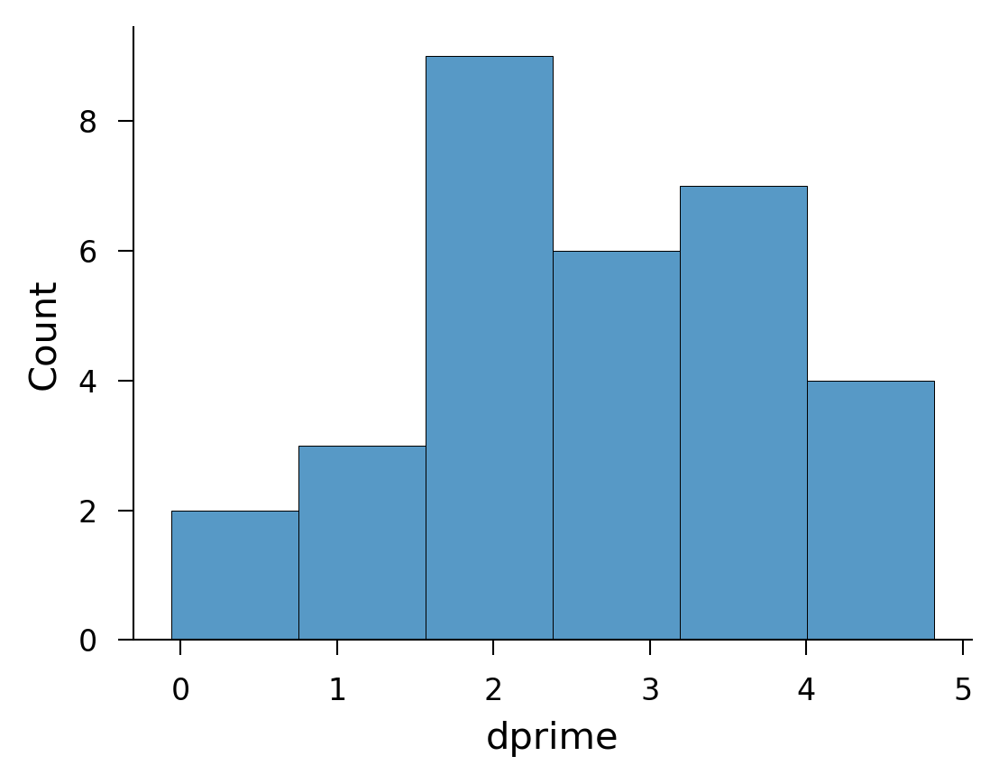

In [ ]:
# Figure 7I:
sns.histplot(dprime_by_subj.dprime)


In [302]:
all_coords_df = all_distractor_df[all_distractor_df.sess_id==1]

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:17: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:26: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

/home1/salman.qasim/miniconda3/envs/cml37/

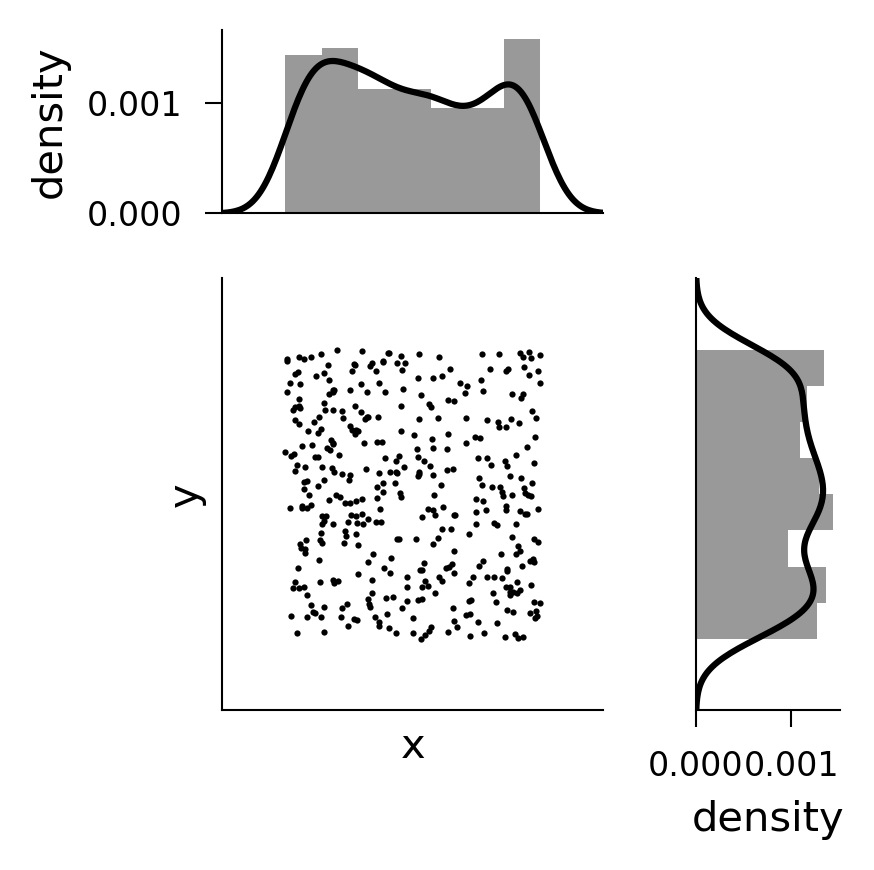

In [ ]:
# Figure 7J: 

f = plt.figure(constrained_layout=True, figsize=[3,3]) # initialize the figure 
gs = f.add_gridspec(3, 3)
stat_plot_ax = f.add_subplot(gs[1:, :2])
x_dist_ax = f.add_subplot(gs[:1, :2], sharex = stat_plot_ax)
y_dist_ax = f.add_subplot(gs[1:, 2:], sharey = stat_plot_ax)

# stat_plot_ax.plot(oasis_csv.zValence, oasis_csv.zArousal,  '.', color='gray', alpha = 0.5, markersize=3)
stat_plot_ax.plot(all_coords_df.x, 
                  all_coords_df.y, '.', color='black',  markersize=3)
stat_plot_ax.set_ylim([all_coords_df.y.min()-200, all_coords_df.y.max()+200])
stat_plot_ax.set_xlim([all_coords_df.x.min()-200, all_coords_df.x.max()+200])
stat_plot_ax.set_xlabel('x')
stat_plot_ax.set_ylabel('y')

# sns.distplot(oasis_csv.zValence, ax=x_dist_ax, norm_hist=True, color = 'gray')
sns.distplot(all_coords_df.x, 
             ax=x_dist_ax, norm_hist=True, color='black')
x_dist_ax.set_xlabel('')
#x_dist_ax.set_ylim([-3, 3])
x_dist_ax.set_ylabel('density')
x_dist_ax.set_xticks([])
sns.despine()

# sns.distplot(oasis_csv.zArousal, ax=y_dist_ax, norm_hist=True, color = 'gray', vertical=True)
sns.distplot(all_coords_df.y, 
             ax=y_dist_ax, norm_hist=True, color='black', vertical=True)
#y_dist_ax.set_xlim([-4.5, 4.5])
y_dist_ax.set_xlabel('density')
y_dist_ax.set_ylabel('')
y_dist_ax.set_yticks([])
sns.despine()
f.tight_layout()

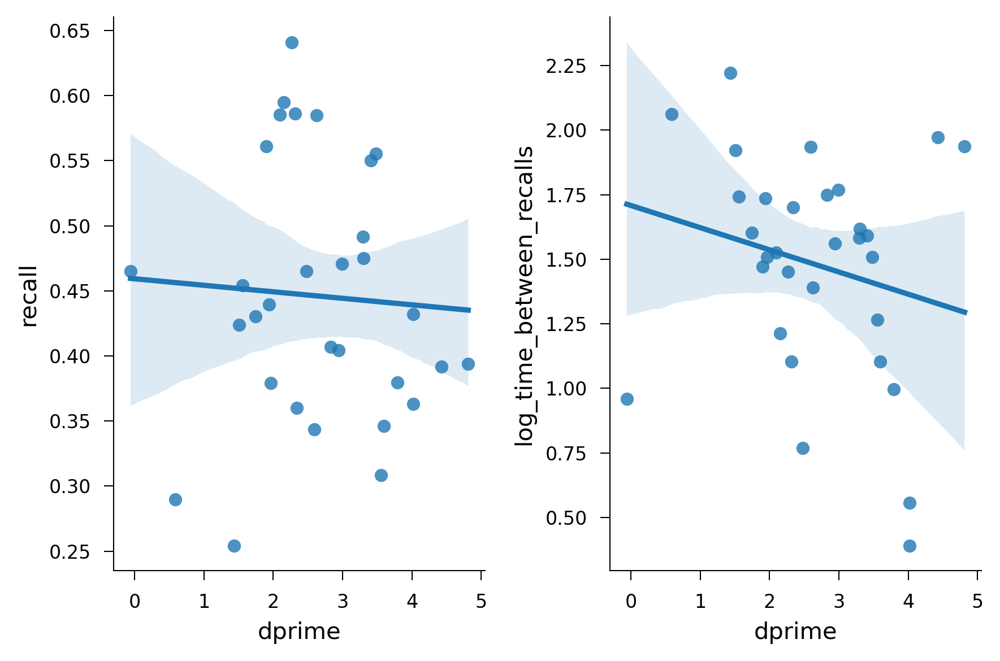

In [ ]:
# Figure 7K: 

dprime_by_subj = dprime_by_subj.merge(all_encoding_df.groupby(['sess_id']).mean(numeric_only=True).reset_index()[['sess_id','recall']])
dprime_by_subj = dprime_by_subj.merge(all_retrieval_df.groupby(['sess_id']).mean(numeric_only=True).reset_index()[['sess_id','time_between_recalls']])
dprime_by_subj['log_time_between_recalls'] = np.log(dprime_by_subj['time_between_recalls'])

f, ax =plt.subplots(1,2, figsize=[6, 4], dpi=300)

sns.regplot(data=dprime_by_subj, x='dprime', y='recall', ax=ax[0], ci=95)
sns.regplot(data=dprime_by_subj, x='dprime', y='log_time_between_recalls', ax=ax[1], ci=95)

plt.tight_layout()

In [123]:
condensed_df_viz = pd.read_csv(f'{datapath}/condensed_df_viz_public.csv')
all_trial_res_viz = pd.read_csv(f'{datapath}/all_trial_viz_public.csv') 



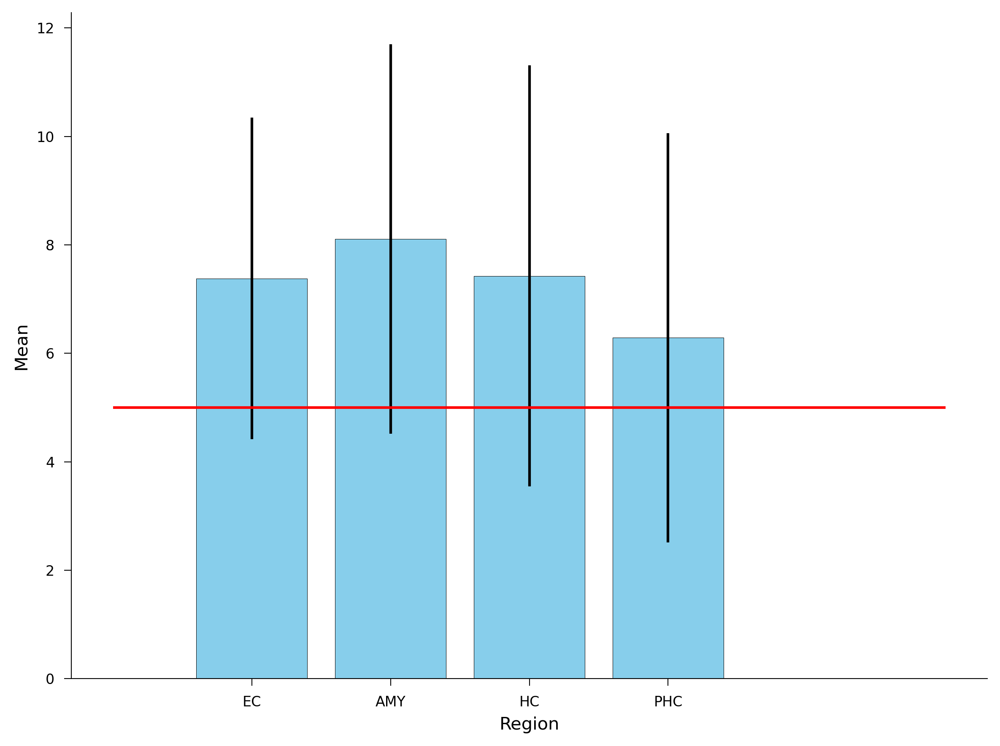

In [ ]:
# Figure 7L: 

significant_obs = condensed_df_viz[condensed_df_viz.grid_cell==1].region.value_counts()  # Number of significant observations
total_obs = condensed_df_viz[condensed_df_viz.nspikes_total>=100].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, alternative='greater')
    # lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()

/home1/salman.qasim/Salman_Python_Scripts/SQ_Projects/grid_utils.py:3693: RuntimeWarning: divide by zero encountered in true_divide
  x_coef = np.divide(covar, np.multiply(std_fr_map_smoothed, std_fr_map_smoothed_2))


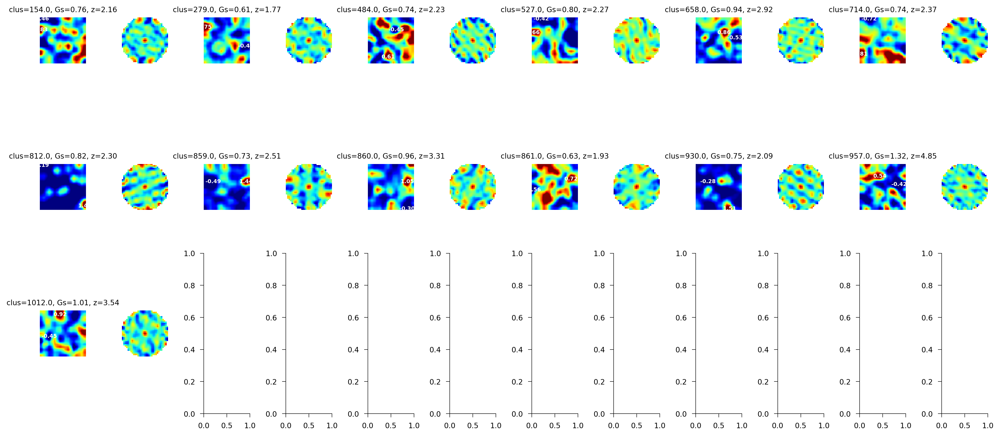

In [ ]:
# Figure 7M:
# Set up parameters
nbins = 17
nrows, ncols = 3, 6
total_cells = nrows * ncols

# Limit to desired number of cells
cells_to_plot = condensed_df_viz[(condensed_df_viz.grid_cell==1) & (condensed_df_viz.region=='HC') & (condensed_df_viz.nspikes_total>100)]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res_viz[
        (all_trial_res_viz.sess_id == cell.sess_id) &
        (all_trial_res_viz.region == cell.region) &
        (all_trial_res_viz.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['x'], nbins)
    y_bins = pd.cut(plot_df['y'], nbins)
    plot_df['x_binned'] = x_bins
    plot_df['y_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['x_binned', 'y_binned']).agg(
        {'evoked_fr_full_trunc': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('y_binned', 'x_binned', 'evoked_fr_full_trunc').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # for field in fields:
    #     heatmap_plt.scatter(*zip(*field), s=5)
    # for peak in peaks:
    #     heatmap_plt.scatter(peak[0], peak[1], color='white', s=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()

<AxesSubplot:xlabel='zGs_label_viz', ylabel='zGs_label_og'>

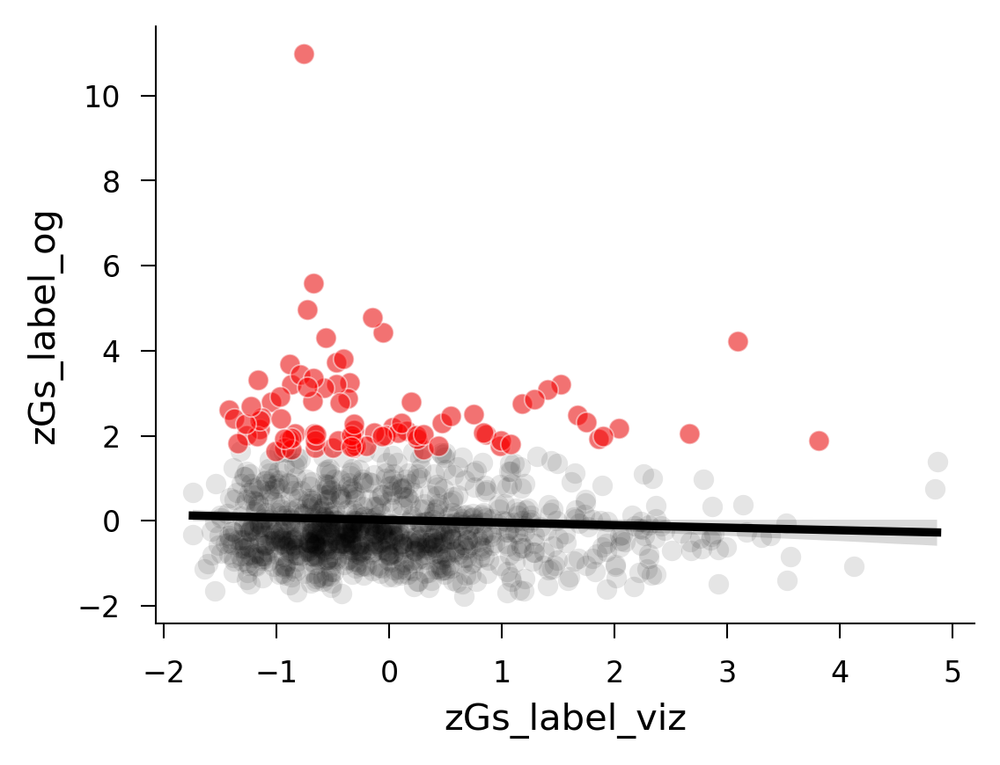

In [ ]:
# Figure 7N:

merged_viz_df = condensed_df_viz.merge(condensed_df, on=['subj_id', 'sess_id', 'region', 'cluster'], suffixes=['_viz', '_og'])

f,ax = plt.subplots(1, 1, dpi=300, figsize=(4,3))
sns.regplot(data=merged_viz_df, 
            x='zGs_label_viz',
            y='zGs_label_og', color ='k', scatter_kws={'alpha':0.1})
sns.scatterplot(data=merged_viz_df[merged_viz_df.computed_p_label_og<0.05], 
            x='zGs_label_viz',
            y='zGs_label_og', color ='red', alpha =0.5)

### Beauty-arousal space

/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:15: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  from ipykernel import kernelapp as app
/home1/salman.qasim/miniconda3/envs/cml37/lib/python3.7/site-packages/ipykernel_launcher.py:23: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

/

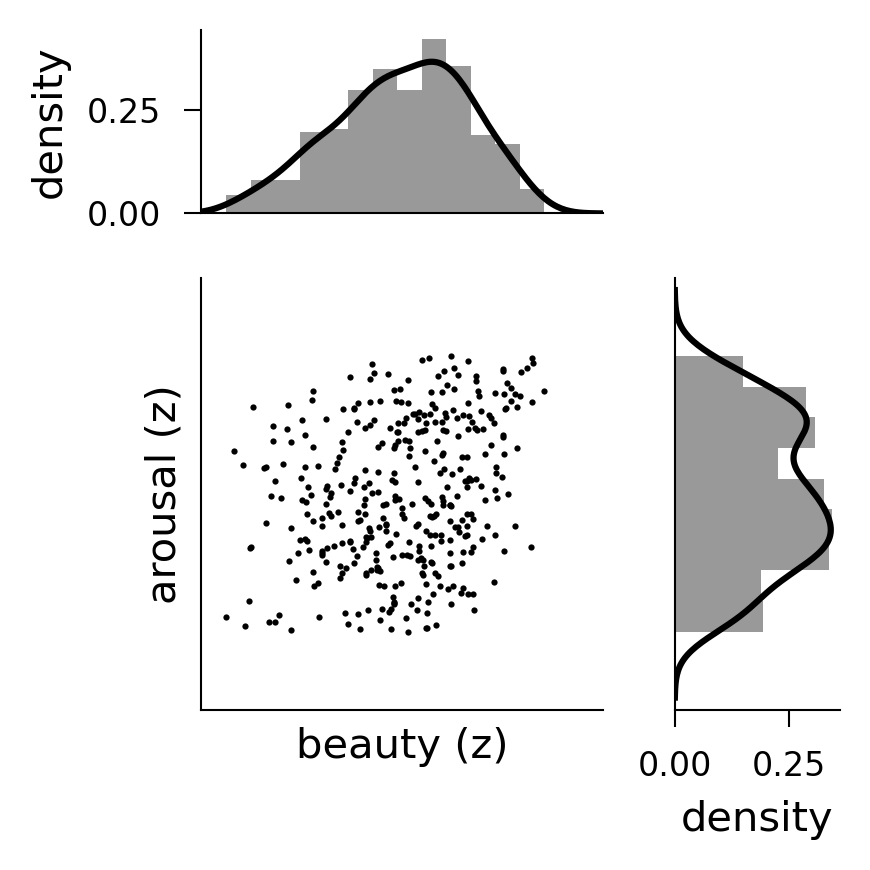

In [ ]:
# Figure S18B:

f = plt.figure(constrained_layout=True, figsize=[3,3]) # initialize the figure 
gs = f.add_gridspec(3, 3)
stat_plot_ax = f.add_subplot(gs[1:, :2])
x_dist_ax = f.add_subplot(gs[:1, :2], sharex = stat_plot_ax)
y_dist_ax = f.add_subplot(gs[1:, 2:], sharey = stat_plot_ax)

stat_plot_ax.plot(oasis_df.zBeauty, 
                  oasis_df.zArousal, '.', color='black',  markersize=3)
stat_plot_ax.set_ylim([-3, 3])
stat_plot_ax.set_xlim([-3, 3])
stat_plot_ax.set_xlabel('beauty (z)')
stat_plot_ax.set_ylabel('arousal (z)')

sns.distplot(oasis_df.zBeauty, 
             ax=x_dist_ax, norm_hist=True, color='black')
x_dist_ax.set_xlabel('')
#x_dist_ax.set_ylim([-3, 3])
x_dist_ax.set_ylabel('density')
x_dist_ax.set_xticks([])
sns.despine()

sns.distplot(oasis_df.zArousal, 
             ax=y_dist_ax, norm_hist=True, color='black', vertical=True)
#y_dist_ax.set_xlim([-4.5, 4.5])
y_dist_ax.set_xlabel('density')
y_dist_ax.set_ylabel('')
y_dist_ax.set_yticks([])
sns.despine()
f.tight_layout()

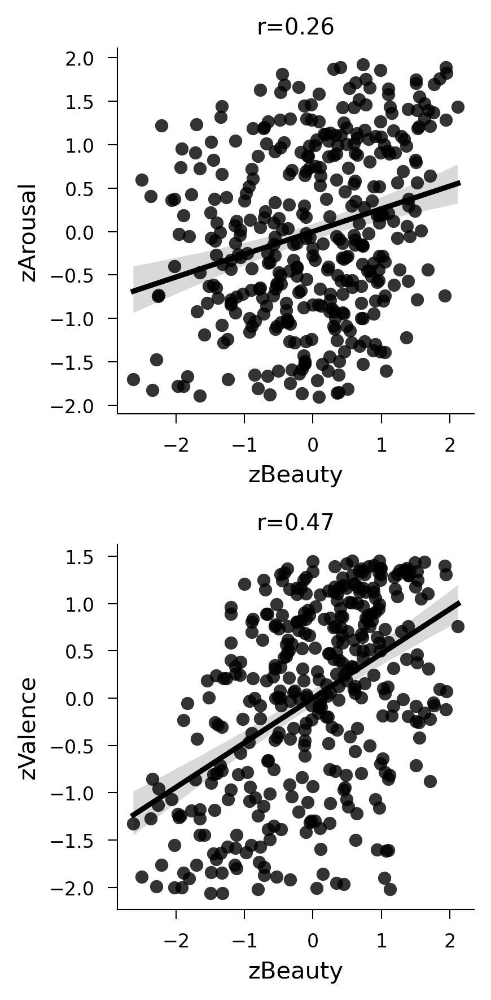

In [ ]:
# Figure S18A:

f, ax = plt.subplots(2,1, figsize=[3,6], dpi=300)

sns.regplot(data=oasis_df, x='zBeauty', y='zArousal', ax=ax[0], color='k')
sns.regplot(data=oasis_df, x='zBeauty', y='zValence', ax=ax[1], color='k')

r1, p1 = pearsonr(oasis_df.zBeauty,
                  oasis_df.zArousal)

r2, p2 = pearsonr(oasis_df.zBeauty,
                  oasis_df.zValence)

ax[0].set(title=f'r={r1:0.2f}')
ax[1].set(title=f'r={r2:0.2f}')

plt.tight_layout()

In [124]:
condensed_df_beauty = pd.read_csv(f'{datapath}/condensed_df_beauty_public.csv')
condensed_df_beauty = condensed_df_beauty[condensed_df_beauty.region!='TP']
all_trial_res_beauty = pd.read_csv(f'{datapath}/all_trial_res_beauty_public.csv') 



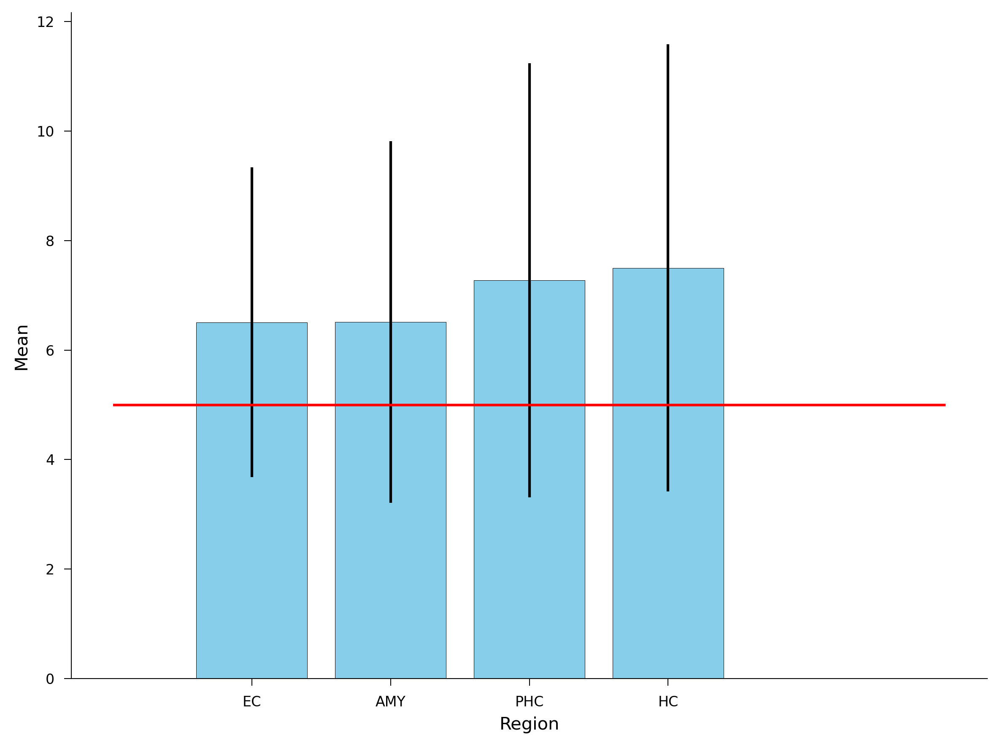

In [ ]:
# Figure S18C:

significant_obs = condensed_df_beauty[condensed_df_beauty.grid_cell==1].region.value_counts()  # Number of significant observations
total_obs = condensed_df_beauty[condensed_df_beauty.nspikes_total>=100].region.value_counts()
percentage_sig = 100 * significant_obs/total_obs 

lci = percentage_sig.copy()
hci = percentage_sig.copy()
p_val = percentage_sig.copy()

for region in ['EC','AMY', 'HC', 'PHC']:
    binom_gridsig = binomtest(significant_obs[region], 
                   total_obs[region], 
                   0.05, alternative='greater')
    # lb_gs, ub_gs = binom_gridsig.proportion_ci(confidence_level=0.95, method='wilson')
    lb_gs, ub_gs = sm.stats.proportion_confint(significant_obs[region], 
                   total_obs[region], alpha=0.05, method="normal")

    lci[region] = lb_gs * 100
    hci[region] = ub_gs * 100
    p_val[region] = binom_gridsig.pvalue * 4

percent_df = pd.DataFrame()
percent_df['mean'] = percentage_sig
percent_df['lci'] = lci
percent_df['hci'] = hci
from statsmodels.stats.multitest import multipletests
multipletests(p_val, method='fdr_bh')[1]

percent_df['p-value'] = p_val

percent_df = percent_df.reset_index().rename(columns={'index':'region'})

# Create the bar plot
plt.figure(figsize=(8, 6))
bars = plt.bar(percent_df['region'], percent_df['mean'], 
               yerr=[percent_df['mean'] - percent_df['lci'], percent_df['hci'] - percent_df['mean']],
               capsize=5, color='skyblue', edgecolor='black')

# Add asterisks for significant p-values
for i, (bar, pval) in enumerate(zip(bars, percent_df['p-value'])):
    if pval <= 0.05:
        plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 5, '*', 
                 ha='center', va='bottom', fontsize=14, color='red')

plt.hlines(5, -1, 5, 'r')
# Label the axes
plt.xlabel('Region')
plt.ylabel('Mean')
# plt.title('Bar Plot with Confidence Intervals and Significant Markers')
sns.despine()
# Show the plot
plt.tight_layout()

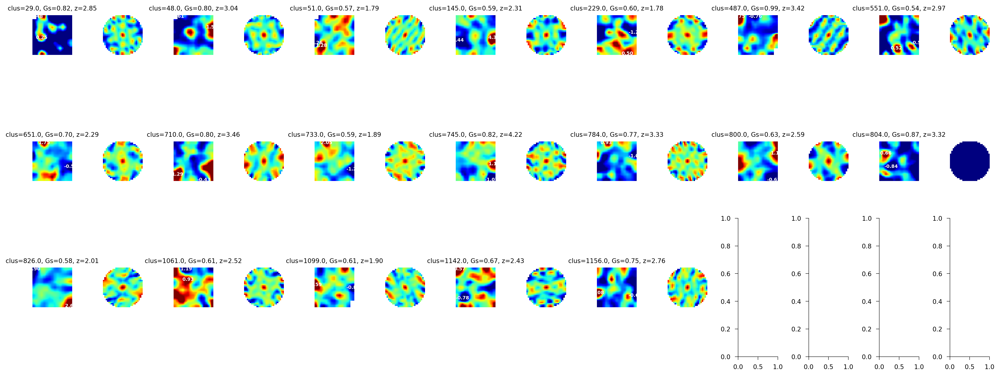

In [ ]:
# Figure S18D:
# Set up parameters
nbins = 15
nrows, ncols = 3, 7
total_cells = nrows * ncols

# Limit to desired number of cells
cells_to_plot = condensed_df_beauty[(condensed_df_beauty.grid_cell==1) & ((condensed_df_beauty.region=='EC'))].iloc[:total_cells]

# Create superplot with 2 plots per cell (heatmap + autocorr)
fig, axes = plt.subplots(nrows=nrows, ncols=ncols * 2, figsize=(ncols * 2.5, nrows * 2.5), dpi=300)

for idx, (_, cell) in enumerate(cells_to_plot.iterrows()):
    row = idx // ncols
    col_base = (idx % ncols) * 2

    heatmap_plt = axes[row, col_base]
    autocorr_plt = axes[row, col_base + 1]

    # Extract cell's data
    plot_df = all_trial_res_beauty[
        (all_trial_res_beauty.sess_id == cell.sess_id) &
        (all_trial_res_beauty.region == cell.region) &
        (all_trial_res_beauty.cluster == cell.cluster)
    ]

    # Bin valence/arousal
    x_bins = pd.cut(plot_df['beauty'], nbins)
    y_bins = pd.cut(plot_df['arousal'], nbins)
    plot_df['beauty_binned'] = x_bins
    plot_df['arousal_binned'] = y_bins

    # Compute rate map
    binned_data = plot_df.groupby(['beauty_binned', 'arousal_binned']).agg(
        {'evoked_fr_early_trunc': np.nanmean}
    ).reset_index()
    rate_map = binned_data.pivot('beauty_binned', 'arousal_binned', 'evoked_fr_early_trunc').T

    smoothmap = grid_utils.smooth_map(rate_map)
    fr_smoothed = (smoothmap - np.nanmin(smoothmap)) / (np.nanmax(smoothmap) - np.nanmin(smoothmap))
    fr_smoothed[np.isnan(fr_smoothed)] = 0  # fill NaNs with 0

    # Field + peak detection
    peaks, fields = grid_utils.find_grid_fields(
        fr_smoothed, adj_dist_thresh=2, field_thresh=0.4,
        peak_thresh_z=1, field_max_thresh=4, gain=2
    )

    # SAC computation and normalization
    sac = grid_utils.calculate_sac(smoothmap)
    sac = (sac - np.nanmin(sac)) / (np.nanmax(sac) - np.nanmin(sac))

    # Plot heatmap
    vmax = np.min([np.nanmax(smoothmap)*0.6, 2]) # don't need higher z-score than 3
    vmin = np.nanmin(smoothmap)*0.6
    
    heatmap_plt.imshow(smoothmap, cmap='jet', interpolation='hamming',
                       vmax=vmax, vmin=vmin)
    heatmap_plt.axis('off')
    heatmap_plt.invert_yaxis()
    heatmap_plt.set_title(f'clus={cell.cluster}, Gs={cell.Gs:.2f}, z={cell.zGs_label:.2f}', fontsize=8)

    # for field in fields:
    #     heatmap_plt.scatter(*zip(*field), s=5)
    # for peak in peaks:
    #     heatmap_plt.scatter(peak[0], peak[1], color='white', s=8)

    # Annotate max/min firing rate values
    if not np.isnan(smoothmap).all():
        max_val = np.nanmax(smoothmap)
        min_val = np.nanmin(smoothmap)
        max_idx = np.unravel_index(np.nanargmax(smoothmap), smoothmap.shape)
        min_idx = np.unravel_index(np.nanargmin(smoothmap), smoothmap.shape)

        heatmap_plt.text(max_idx[1], max_idx[0], f'{max_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')
        heatmap_plt.text(min_idx[1], min_idx[0], f'{min_val:.2f}', color='white',
                         ha='center', va='center', fontsize=6, weight='bold')

    # Plot autocorrelation
    grid_scorer = grid_utils.GridCell(nbins=nbins)
    grid_scorer.plot_sac(sac, cmap='jet', ax=autocorr_plt)
    autocorr_plt.invert_yaxis()
    autocorr_plt.axis('off')

# Finalize figure
plt.tight_layout()

In [317]:
merged_df = condensed_df_beauty.merge(condensed_df, on=['cluster'])

<AxesSubplot:xlabel='zGs_label_x', ylabel='zGs_label_y'>

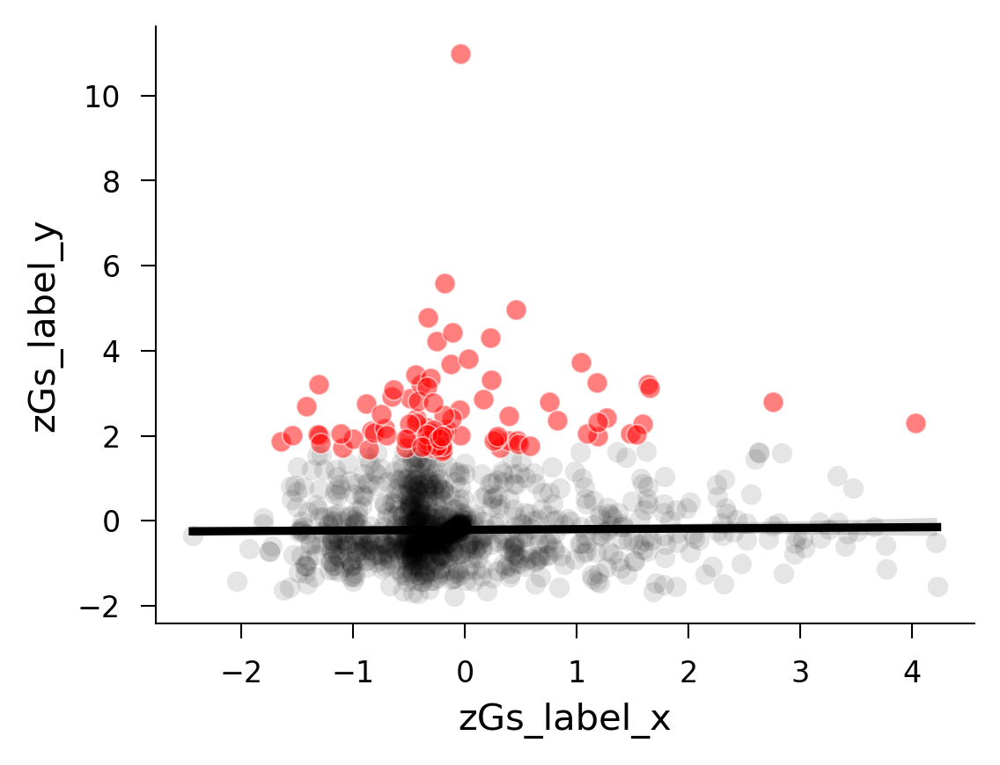

In [ ]:
# Figure S18E:

sns.regplot(data=merged_df[merged_df.computed_p_label_y>0.05], x='zGs_label_x', 
            y='zGs_label_y', color='black', scatter_kws={'alpha':0.1})
sns.scatterplot(data=merged_df[merged_df.computed_p_label_y<=0.05], x='zGs_label_x', 
            y='zGs_label_y', color='red', alpha=0.5)